In [1]:
import pandas as pd
import os
from glob import glob
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import behaviour_functions as bhv
import itertools
from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from scipy.stats import fisher_exact
from statsmodels.stats.multitest import multipletests
from scipy.stats import skew, shapiro
# from scipy.stats import mcnemar
from statsmodels.stats.multitest import multipletests

In [2]:
path = '/Volumes/lab-kohlj/home/shared/people/Irene/sensitization/BORIS project/scored/'
IDs = ["BRAC7159.2d", "BRAC7172.1e", "BRAC7172.1g", "BRAC7172.1h", "BRAC7266.1i", 
       "BRYD63.4c", "BRYD65.4f", "BRYA125.3i", "BRYB121.3g", "BRYC103.3f"]
times = ["baseline", "day1", "day2", "day3", "day4", "day5", "day6", 
         "day10", "day14", "day18", "day22", "day26", "day30", "day50"]

In [ ]:
# # initialize dataframe
# behaviours = pd.DataFrame(columns = ["ID", "time", "behaviour", "latency", "duration"])

# # extract behaviours for each ID and each experimental time point
# for ID in IDs:
#     for time in times:
#         try:
#             # get the paths for each file in dataset, read csv files into a dataframe
#             file = glob(path + f'{ID}_virgin_{time}_scored*.csv')
#             df = pd.read_csv(file[0])
#         # ignore missing datapoints
#         except IndexError:
#             df = pd.DataFrame(columns = df.columns)
#             print(f'{ID}_virgin_{time}_scored*.csv')
#             continue
        
#         # organise behavioural data and calculate latency and duration of behaviours
#         behaviours = bhv.organise_behav(df, ID, time, behaviours, 'Time')

# # turn values in time to categorical and order them
# behaviours.time = pd.Categorical(behaviours.time, categories = times, ordered = True)

# # save behaviour dataframe as csv",
# # behaviours.to_csv('/Users/irenesalgarella/Documents/GitHub/sensitization_behaviour/dataframes/behaviours_df.csv')

BRAC7159.2d_virgin_day26_scored*.csv
BRAC7266.1i_virgin_day26_scored*.csv


KeyError: 'Time'

In [3]:
# initialize dataframe
behaviours = pd.DataFrame(columns = ["ID", "time", "behaviour", "latency", "duration"])

# extract behaviours for each ID and each experimental time point
for ID in IDs:
    for time in times:
        try:
            # get the paths for each file in dataset, read csv files into a dataframe
            file = glob(path + f'{ID}_virgin_{time}_*scored*.csv')
            
            if not file:  # No files found
                print(f'{ID}_virgin_{time}_scored*.csv - No files found')
                continue
                
            print(f"Processing file: {file[0]}")
            df = pd.read_csv(file[0], low_memory=False)
            
            # Debug: print column names to see what we're working with
            print(f"Columns in file: {df.columns.tolist()}")
            
            # Check the format of the CSV and use the appropriate function
            if "Behavior type" in df.columns:
                # Format 2 - using columns like "Behavior type"
                print(f"Detected format 2 for {ID}_{time}, using organise_behav_new()")
                behaviours = bhv.organise_behav_new(df, ID, time, behaviours, 'time')
            else:
                # Format 1 - check if "Time" is a column or a header row
                time_col = None
                if "Time" in df.columns:
                    time_col = "Time"
                elif "time" in df.columns:
                    time_col = "time"
                else:
                    # Try to find where "Time" appears as a header
                    # This handles the case where the CSV has metadata at the top
                    print("Searching for Time column in format 1...")
                    for i, row in df.iterrows():
                        if any(str(cell).lower() == 'time' for cell in row):
                            print(f"Found 'Time' header at row {i}")
                            # The Time column is identified, now we need to use the appropriate function
                            break
                
                # Use the original function for format 1
                print(f"Detected format 1 for {ID}_{time}, using organise_behav() with time_col={time_col}")
                behaviours = bhv.organise_behav(df, ID, time, behaviours, time_col if time_col else "Time")
                
        except IndexError:
            print(f'{ID}_virgin_{time}_scored*.csv - IndexError')
            continue
        except Exception as e:
            print(f"Error processing {ID}_{time}: {str(e)}")
            # Print more debug info
            import traceback
            traceback.print_exc()
            continue

# turn values in time to categorical and order them
behaviours.time = pd.Categorical(behaviours.time, categories = times, ordered = True)

# Print a summary of what was processed
print("\nProcessing complete!")
print(f"Total behaviors recorded: {len(behaviours)}")
print("Behaviors by type:")
print(behaviours['behaviour'].value_counts())

Processing file: /Volumes/lab-kohlj/home/shared/people/Irene/sensitization/BORIS project/scored/BRAC7159.2d_virgin_baseline_scored.csv
Columns in file: ['Observation id', 'BRAC7159.2d_virgin_baseline', 'Unnamed: 2', 'Unnamed: 3', 'Unnamed: 4', 'Unnamed: 5', 'Unnamed: 6', 'Unnamed: 7', 'Unnamed: 8']
Searching for Time column in format 1...
Found 'Time' header at row 14
Detected format 1 for BRAC7159.2d_baseline, using organise_behav() with time_col=None
Processing file: /Volumes/lab-kohlj/home/shared/people/Irene/sensitization/BORIS project/scored/BRAC7159.2d_virgin_day1_scored.csv
Columns in file: ['Observation id', 'BRAC7159.2d_virgin_day1', 'Unnamed: 2', 'Unnamed: 3', 'Unnamed: 4', 'Unnamed: 5', 'Unnamed: 6', 'Unnamed: 7', 'Unnamed: 8']
Searching for Time column in format 1...
Found 'Time' header at row 14
Detected format 1 for BRAC7159.2d_day1, using organise_behav() with time_col=None
Processing file: /Volumes/lab-kohlj/home/shared/people/Irene/sensitization/BORIS project/scored/BR

In [4]:
## run to fix 'Time' and 'time' columns in the behaviours dataframe. IMPORTANT: run this after the behaviours dataframe is created
# Check current columns to debug
print("Columns before fixing:", behaviours.columns.tolist())

# Check if both 'Time' and 'time' columns exist
if 'Time' in behaviours.columns and 'time' in behaviours.columns:
    print("Found both 'Time' and 'time' columns. Merging them...")
    
    # Merge 'Time' into 'time' where 'time' is empty/NaN
    mask = behaviours['time'].isna() | (behaviours['time'] == '')
    behaviours.loc[mask, 'time'] = behaviours.loc[mask, 'Time']
    
    # Drop the 'Time' column
    behaviours = behaviours.drop(columns=['Time'])
    
# If only 'Time' exists, rename it to 'time'
elif 'Time' in behaviours.columns:
    print("Found only 'Time' column. Renaming to 'time'...")
    behaviours = behaviours.rename(columns={'Time': 'time'})

# Ensure 'time' column is treated as categorical with proper order
behaviours.time = pd.Categorical(behaviours.time, categories=times, ordered=True)

# Check columns after fixing
print("Columns after fixing:", behaviours.columns.tolist())
print(f"Number of entries in behaviours dataframe: {len(behaviours)}")

Columns before fixing: ['ID', 'time', 'behaviour', 'latency', 'duration', 'Time']
Found both 'Time' and 'time' columns. Merging them...
Columns after fixing: ['ID', 'time', 'behaviour', 'latency', 'duration']
Number of entries in behaviours dataframe: 1072


In [7]:
behaviours 

,ID,time,behaviour,latency,duration
0,BRAC7159.2d,baseline,pup sniff,46.4,43.553
1,BRAC7159.2d,baseline,pup groom,53.4,306.817
2,BRAC7159.2d,baseline,aborted retrieval,219.674,2.433
3,BRAC7159.2d,baseline,nest time,334.823,393.943
4,BRAC7159.2d,baseline,retrieval to nest,337.974,5.683
...,...,...,...,...,...
1067,BRYC103.3f,day50,nest time,900,0
1068,BRYC103.3f,day50,retrieval to nest,900,0
1069,BRYC103.3f,day50,overall retrieval,46.75,8.55
1070,BRYC103.3f,day50,crouching,900,0


In [ ]:
# plt.rcParams.update({
#     'axes.linewidth': 1.2,         # Thickness of the axis lines
#     'xtick.major.width': 1.2,      # Thickness of major x ticks
#     'ytick.major.width': 1.2,      # Thickness of major y ticks
#     'xtick.labelsize': 15,         # Font size of tick labels
#     'ytick.labelsize': 15,
#     'axes.labelsize': 20,          # Axis label size
#     'axes.titlesize': 14,
#     'font.weight': 'regular',      # Ensures no bold labels unless specified
#     'axes.labelweight': 'regular',
#     'figure.dpi': 300              # Keeps DPI consistent across figures
# })


['BRAC7172.1g', 'BRAC7172.1h', 'BRAC7266.1i']
              ID      time          behaviour  latency duration
220  BRAC7172.1g  baseline  retrieval to nest  283.766    2.475
228  BRAC7172.1g      day1  retrieval to nest   57.905    9.627
236  BRAC7172.1g      day2  retrieval to nest   22.682    5.582
244  BRAC7172.1g      day3  retrieval to nest   12.626    4.124
252  BRAC7172.1g      day4  retrieval to nest    4.872    5.427
260  BRAC7172.1g      day5  retrieval to nest    5.672     5.05
268  BRAC7172.1g      day6  retrieval to nest   18.198    7.656
276  BRAC7172.1g     day10  retrieval to nest      5.8    2.375
284  BRAC7172.1g     day14  retrieval to nest      2.8      4.1
292  BRAC7172.1g     day18  retrieval to nest    4.375      9.0
300  BRAC7172.1g     day22  retrieval to nest    5.067    3.966
308  BRAC7172.1g     day26  retrieval to nest    7.675    5.175
316  BRAC7172.1g     day30  retrieval to nest      900        0
324  BRAC7172.1g     day50  retrieval to nest   26.067    

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_79175/1221251907.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])


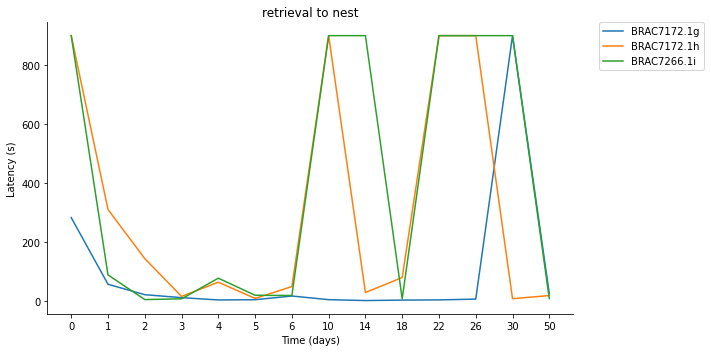

In [11]:
# # visualise latency for each ID and each behaviour with a line plot where each line is a different behaviour, the x axis is time and the y axis is latency. This is only for the mice that retrieved on day 50
# # Define the behaviours of interest
# behaviours_of_interest = ["overall retrieval", "retrieval to nest", "aborted retrieval"]

# # Filter the DataFrame for day 50 and latency < 900
# filtered_df = behaviours[(behaviours['time'] == 'day50') & (behaviours['latency'] < 900) & (behaviours['behaviour'].isin(behaviours_of_interest))]
filtered_df = behaviours[(behaviours['time'] == 'day50') & (behaviours['latency'] < 900) & (behaviours['behaviour'] == "retrieval to nest")]
IDs_retrieval_day50 = filtered_df.ID.unique().tolist()

# from the dataframe behaviours, select only the rows with the IDs of interest
df_retrieving_day50 = behaviours[behaviours.ID.isin(IDs_retrieval_day50)]
print(df_retrieving_day50.ID.unique().tolist())

subset = df_retrieving_day50[df_retrieving_day50['behaviour'] == "retrieval to nest"]
print(subset)

# Check if the subset is not empty
if not subset.empty:
    # Create a new figure for each behaviour
    fig, ax = plt.subplots(figsize=(10, 5))

    # Plotting the latency for each ID for the specific behaviour
    sns.lineplot(data=subset, x='time', y='latency', hue='ID', ax=ax, palette='tab10')
    ax.set_title("retrieval to nest")
    ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])
    ax.set_xlabel('Time (days)')
    ax.set_ylabel('Latency (s)')
    # Move legend outside the plot
    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

    # Show plot for each behaviour
    sns.despine()
    plt.tight_layout()
    plt.show()



In [ ]:
filtered_df

,ID,time,behaviour,latency,duration
210,BRAC7172.1e,day50,aborted retrieval,604.525,2.150
213,BRAC7172.1e,day50,overall retrieval,604.525,2.150
324,BRAC7172.1g,day50,retrieval to nest,26.067,9.534
325,BRAC7172.1g,day50,overall retrieval,26.067,9.534
434,BRAC7172.1h,day50,aborted retrieval,9.000,8.850
436,BRAC7172.1h,day50,retrieval to nest,19.725,2.675
437,BRAC7172.1h,day50,overall retrieval,9.000,11.525
538,BRAC7266.1i,day50,aborted retrieval,159.233,5.534
540,BRAC7266.1i,day50,retrieval to nest,9.166,5.166
541,BRAC7266.1i,day50,overall retrieval,9.166,10.700


In [ ]:
# for behaviour in behaviours_subset.behaviour.unique():
#     behav_df = behaviours_subset[behaviours_subset.behaviour == behaviour]
    
#     # plot latency for each ID  
#     fig, ax = plt.subplots(figsize = [10, 5])
#     fig.tight_layout()
    
#     sns.lineplot(x = 'time', y = 'latency', hue = 'ID', data = behav_df)

#     ax.set_xlim(['baseline', 'day50'])
#     ax.set_ylim([0, 900])
#     ax.spines['right'].set_visible(False)
#     ax.spines['top'].set_visible(False)

#     plt.xticks(fontsize = 15)
#     plt.yticks(fontsize = 15)

#     plt.grid(False)
    
#     plt.ylabel('Latency (s)', fontsize = 20)
    
#     plt.title(behaviour)
#     plt.legend(bbox_to_anchor = (1.05, 1), loc = 'upper left', borderaxespad = 0., fontsize = 15)
#     plt.show()

NameError: name 'behaviours_subset' is not defined

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_79175/3865906940.py:21: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])


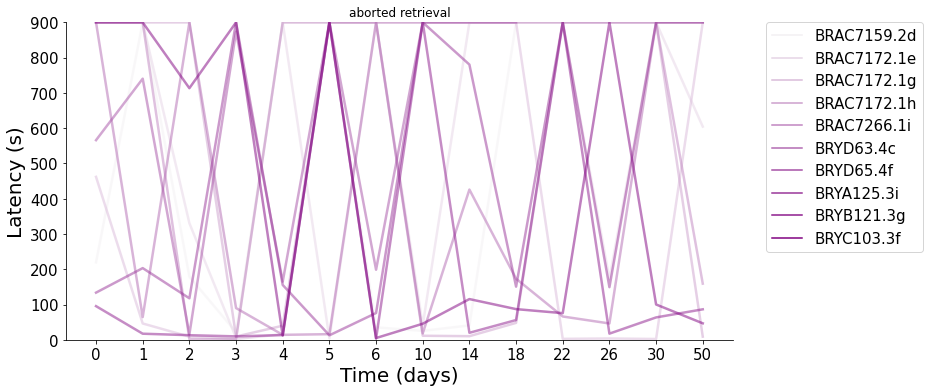

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_79175/3865906940.py:21: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])


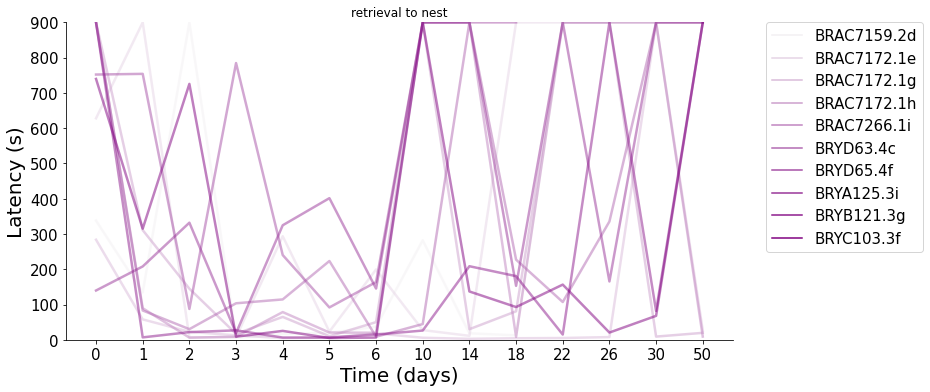

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_79175/3865906940.py:21: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])


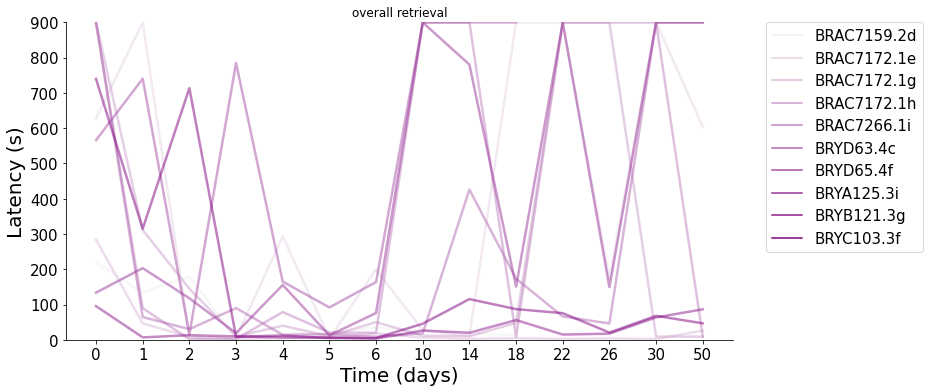

In [12]:
# plot a lineplot of the latency for each ID for the behaviours retrieval to nest, overall retrieval and aborted retrieval, 
# where each line is a different ID, the x axis is time and the y axis is latency. 

# Define the behaviours of interest
behaviours_of_interest = ["overall retrieval", "retrieval to nest", "aborted retrieval"]
# Filter the DataFrame for the behaviours of interest
behaviours_subset = behaviours[behaviours['behaviour'].isin(behaviours_of_interest)]
# Create a new figure for each behaviour
for behaviour in behaviours_subset.behaviour.unique():
    behav_df = behaviours_subset[behaviours_subset.behaviour == behaviour]
    
    # plot latency for each ID  
    fig, ax = plt.subplots(figsize = [10, 5])
    fig.tight_layout()
    
    # The colours of the lines are purple, with the number of colours equal to the number of IDs, alpha = 0.5, reverse = True and lw = 2.5.
    palette = sns.light_palette("purple", n_colors=len(behav_df.ID.unique()))

    sns.lineplot(x = 'time', y = 'latency', hue = 'ID', data = behav_df, lw = 2.5, alpha = 0.5, palette=palette)

    ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])

    ax.set_ylim([0, 900])
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    plt.xticks(fontsize = 15)
    plt.yticks(fontsize = 15)

    plt.grid(False)
    
    plt.ylabel('Latency (s)', fontsize = 20)
    plt.xlabel('Time (days)', fontsize = 20)
    plt.title(behaviour)
    plt.legend(bbox_to_anchor = (1.05, 1), loc = 'upper left', borderaxespad = 0., fontsize = 15)
    plt.show()


/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_51300/19982400.py:28: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])


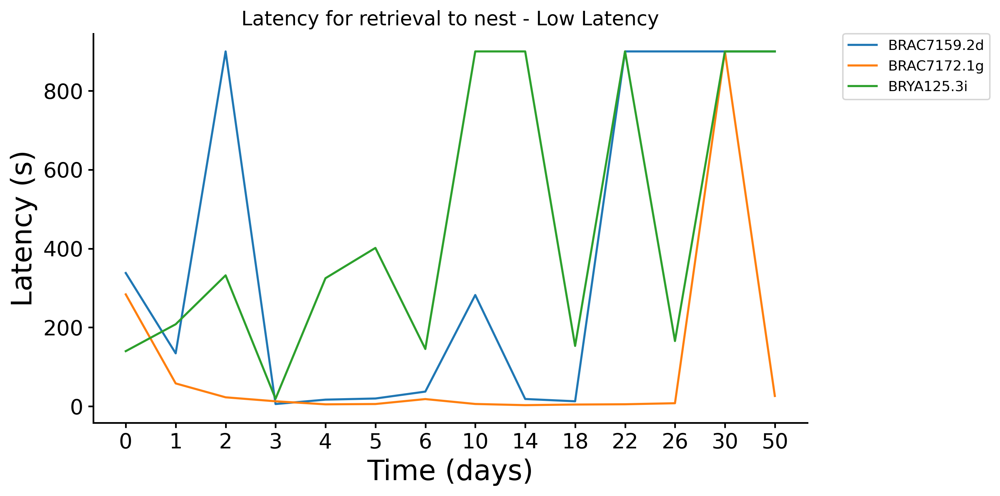

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_51300/19982400.py:28: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])


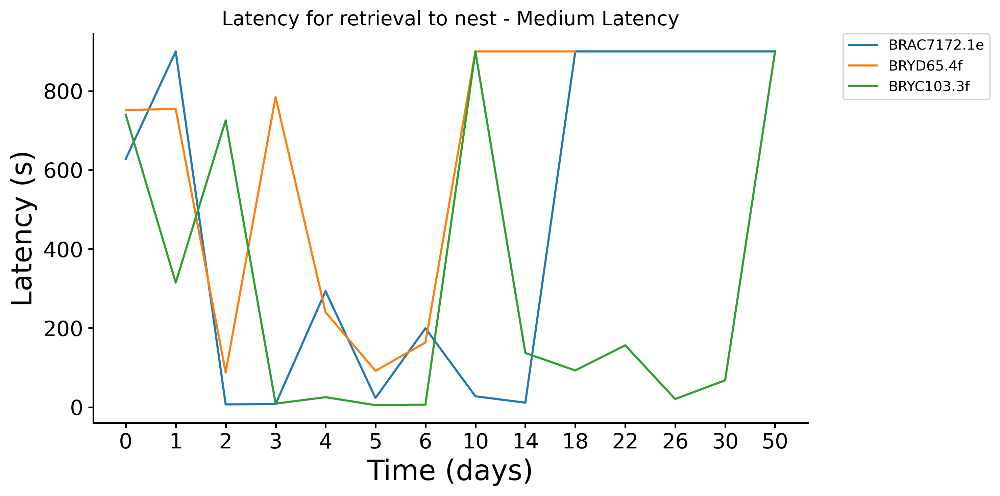

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_51300/19982400.py:28: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])


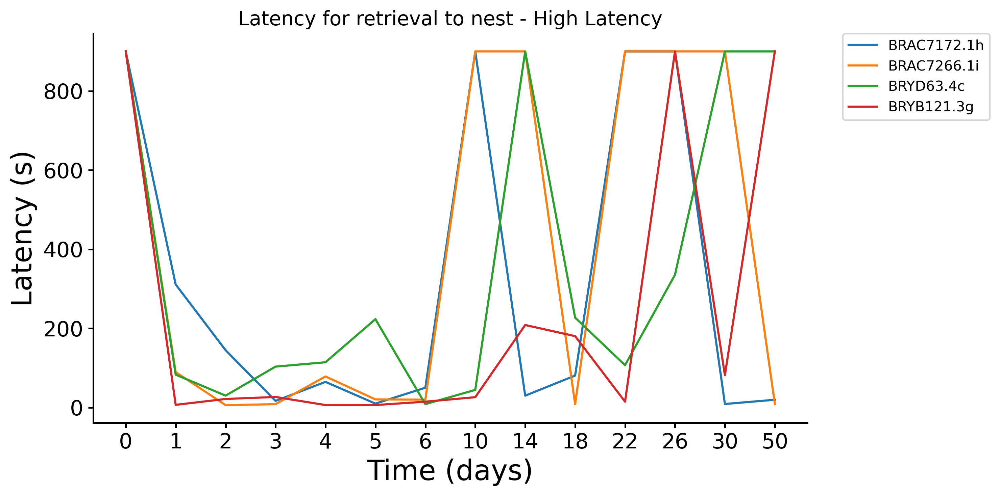

In [ ]:
# plot a lineplot of the latency for the behaviour retrieval to nest, where each line is a different ID, the x axis is time and the y axis is latency. 
# One plot has the IDs for which latency at baseline was < 400, another plot has the IDs for which latency at baseline was > 400, 
# and the last plot has the IDs for which latency at baseline was >900 

# Define the behaviour of interest
behaviour_of_interest = "retrieval to nest"
# Filter the DataFrame for the behaviour of interest
behaviours_subset = behaviours[behaviours['behaviour'] == behaviour_of_interest]
# Get the baseline latency for each ID
baseline_latencies = behaviours_subset[behaviours_subset['time'] == 'baseline'][['ID', 'latency']].set_index('ID')['latency']
# Create subsets based on baseline latency
low_latency_ids = baseline_latencies[baseline_latencies < 400].index.tolist()
medium_latency_ids = baseline_latencies[(baseline_latencies >= 400) & (baseline_latencies < 900)].index.tolist()
high_latency_ids = baseline_latencies[baseline_latencies >= 900].index.tolist()
# Create a dictionary to hold the subsets
subsets = {
    'low_latency': behaviours_subset[behaviours_subset['ID'].isin(low_latency_ids)],
    'medium_latency': behaviours_subset[behaviours_subset['ID'].isin(medium_latency_ids)],
    'high_latency': behaviours_subset[behaviours_subset['ID'].isin(high_latency_ids)]
}

# Plotting each subset
for latency_group, subset in subsets.items():
    if not subset.empty:
        fig, ax = plt.subplots(figsize=(10, 5))

        # choose a different colour palette for each plot, with the number of colours equal to the number of IDs, alpha = 0.5 and lw = 2.5.
        palette = sns.light_palette("purple", n_colors=len(subset.ID.unique()))
        
        sns.lineplot(data=subset, x='time', y='latency', hue='ID', ax=ax)
        ax.set_title(f"Latency for {behaviour_of_interest} - {latency_group.replace('_', ' ').title()}")
        ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])
        ax.set_xlabel('Time (days)')
        ax.set_ylabel('Latency (s)')
        # Move legend outside the plot
        ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
        sns.despine()
        plt.tight_layout()
        plt.show()


In [ ]:
behaviours_subset[behaviours_subset['behaviour'] == 'retrieval to nest']

,ID,time,behaviour,latency,duration,x_numeric,day
4,BRAC7159.2d,baseline,retrieval to nest,337.974,5.683,0,0
12,BRAC7159.2d,day1,retrieval to nest,134.246,4.926,1,1
20,BRAC7159.2d,day2,retrieval to nest,900,0,2,2
28,BRAC7159.2d,day3,retrieval to nest,5.657,6.476,3,3
36,BRAC7159.2d,day4,retrieval to nest,16.758,6.934,4,4
...,...,...,...,...,...,...,...
1036,BRYC103.3f,day18,retrieval to nest,92.867,4.601,9,18
1044,BRYC103.3f,day22,retrieval to nest,156.5,3.467,10,22
1052,BRYC103.3f,day26,retrieval to nest,20.533,5.5,11,26
1060,BRYC103.3f,day30,retrieval to nest,67.925,8.375,12,30


In [7]:
behaviours[behaviours['behaviour'] == 'retrieval to nest']

,ID,time,behaviour,latency,duration


In [15]:
# get the unique IDs of all the mice at day 50  
# This will give you the IDs of all mice that have data for day 50
day50_IDs = set(behaviours[behaviours['time']== 'day50']['ID'].unique().tolist())

baseline_IDs = set(behaviours[behaviours['time']== 'baseline']['ID'].unique().tolist())

# identify the IDs that are in baseline but not in day 50
missing_IDs = baseline_IDs - day50_IDs
print("IDs missing at day 50:", missing_IDs)

# Get the subset of data for 'retrieval to nest' behavior
retrieval_data = behaviours[behaviours['behaviour'] == 'retrieval to nest']

# Filter out the specific ID you want to exclude
retrieval_data = retrieval_data[retrieval_data['ID'] != 'BRYD65.4f']

# Convert latency to numeric in case it's not already
retrieval_data['latency'] = pd.to_numeric(retrieval_data['latency'])

# Pivot the DataFrame to have time as rows and ID as columns
pivot_df = retrieval_data.pivot(index='time', columns='ID', values='latency')

# Convert to numpy array
latency_matrix = pivot_df.to_numpy()

# Print the shape and preview the matrix
print(f"Matrix shape: {latency_matrix.shape}")
print("Row indices (times):")
print(pivot_df.index.tolist())
print("Column indices (mouse IDs):")
print(pivot_df.columns.tolist())
print("\nLatency matrix:")
print(latency_matrix)

IDs missing at day 50: {'BRYD65.4f'}
Matrix shape: (14, 9)
Row indices (times):
['baseline', 'day1', 'day2', 'day3', 'day4', 'day5', 'day6', 'day10', 'day14', 'day18', 'day22', 'day26', 'day30', 'day50']
Column indices (mouse IDs):
['BRAC7159.2d', 'BRAC7172.1e', 'BRAC7172.1g', 'BRAC7172.1h', 'BRAC7266.1i', 'BRYA125.3i', 'BRYB121.3g', 'BRYC103.3f', 'BRYD63.4c']

Latency matrix:
[[337.974 628.09  283.766 900.    900.    139.775 900.    739.675 900.   ]
 [134.246 900.     57.905 311.08   89.605 208.      6.866 315.025  83.166]
 [900.      6.974  22.682 144.929   6.122 332.05   21.75  725.6    30.166]
 [  5.657   7.575  12.626  16.839   8.605  19.1    26.8     8.775 103.533]
 [ 16.758 293.607   4.872  64.923  78.6   324.75    6.367  25.267 114.5  ]
 [ 19.667  23.15    5.672  10.063  20.699 401.6     6.4     5.05  223.434]
 [ 37.176 199.499  18.198  50.114  19.933 145.3    14.866   6.325   8.7  ]
 [282.15   27.533   5.8   900.    900.    900.     26.233 900.     44.65 ]
 [ 18.434  11.25    

Explained variance by PC1: 0.27
Explained variance by PC2: 0.24
Total explained variance: 0.51


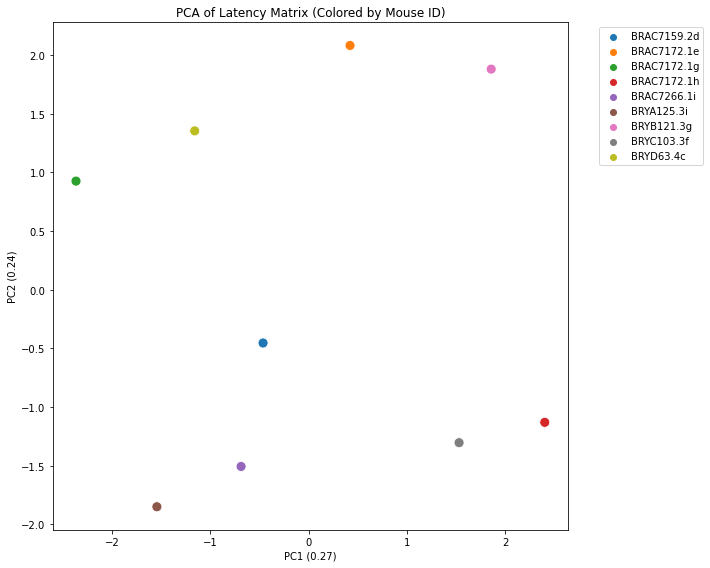

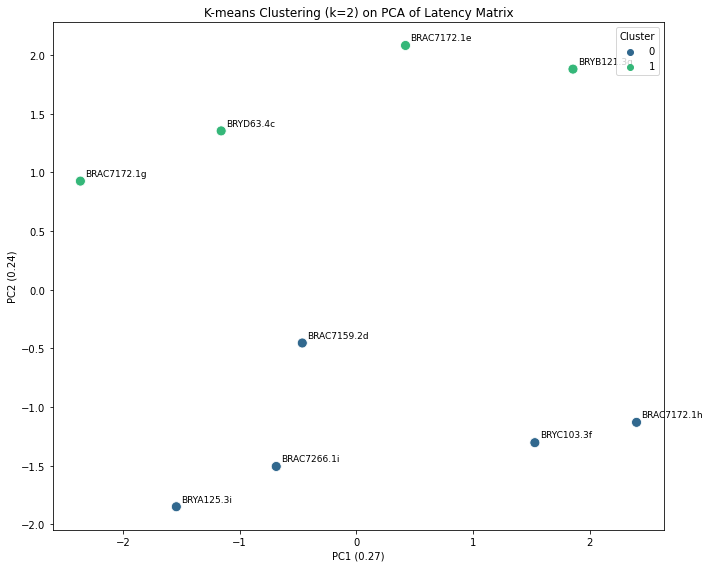

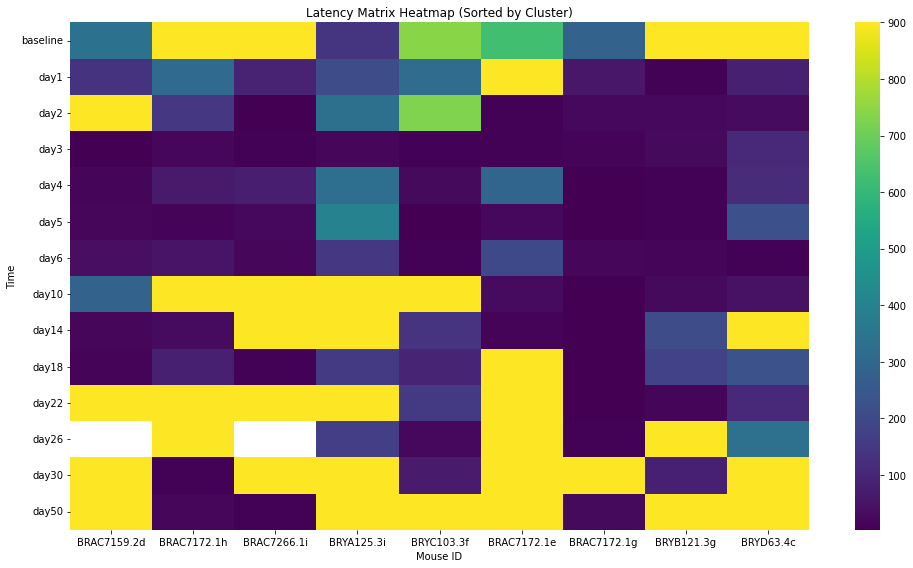

In [17]:
# Import necessary libraries
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Handle missing values in the matrix (if any)
imputer = SimpleImputer(strategy='mean')
latency_matrix_imputed = imputer.fit_transform(latency_matrix)

# Standardize the data (important for PCA)
scaler = StandardScaler()
latency_matrix_scaled = scaler.fit_transform(latency_matrix_imputed)

# Transpose the matrix so each row is a mouse and each column is a timepoint
latency_matrix_T = latency_matrix_scaled.T

# Apply PCA
pca = PCA(n_components=2)  # Using 2 components for visualization
pca_result = pca.fit_transform(latency_matrix_T)

# Calculate explained variance
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.2f}")
print(f"Explained variance by PC2: {explained_variance[1]:.2f}")
print(f"Total explained variance: {sum(explained_variance):.2f}")

# Apply K-means clustering
k = 2  # Set number of clusters (you can adjust this)
kmeans = KMeans(n_clusters=k, random_state=42)
cluster_labels = kmeans.fit_predict(latency_matrix_T)

# Create a DataFrame for plotting
import pandas as pd
pca_df = pd.DataFrame({
    'PC1': pca_result[:, 0],
    'PC2': pca_result[:, 1],
    'Mouse_ID': pivot_df.columns,
    'Cluster': cluster_labels
})

# Plot 1: PCA colored by mouse ID
plt.figure(figsize=(10, 8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, hue='Mouse_ID', s=100)
plt.title('PCA of Latency Matrix (Colored by Mouse ID)')
plt.xlabel(f'PC1 ({explained_variance[0]:.2f})')
plt.ylabel(f'PC2 ({explained_variance[1]:.2f})')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# Plot 2: PCA colored by cluster
plt.figure(figsize=(10, 8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, hue='Cluster', palette='viridis', s=100)
# Add mouse ID labels to each point
for i, txt in enumerate(pca_df['Mouse_ID']):
    plt.annotate(txt, (pca_df['PC1'][i], pca_df['PC2'][i]), fontsize=9, 
                 xytext=(5, 5), textcoords='offset points')
plt.title(f'K-means Clustering (k={k}) on PCA of Latency Matrix')
plt.xlabel(f'PC1 ({explained_variance[0]:.2f})')
plt.ylabel(f'PC2 ({explained_variance[1]:.2f})')
plt.legend(title='Cluster')
plt.tight_layout()
plt.show()

# Plot 3: Original latency matrix as heatmap with clusters
plt.figure(figsize=(14, 8))
# Sort by cluster for better visualization
sorted_indices = np.argsort(cluster_labels)
sorted_matrix = latency_matrix[:, sorted_indices]
sorted_ids = [pivot_df.columns[i] for i in sorted_indices]

# Create heatmap
ax = sns.heatmap(sorted_matrix, cmap='viridis', 
                yticklabels=pivot_df.index.tolist(),
                xticklabels=sorted_ids)
plt.title('Latency Matrix Heatmap (Sorted by Cluster)')
plt.xlabel('Mouse ID')
plt.ylabel('Time')
plt.tight_layout()
plt.show()

Explained variance by PC1: 0.27
Explained variance by PC2: 0.24
Total explained variance: 0.51
Silhouette score for k=2: 0.323
Silhouette score for k=3: 0.388
Silhouette score for k=4: 0.537
Silhouette score for k=5: 0.403
Optimal number of clusters: 4


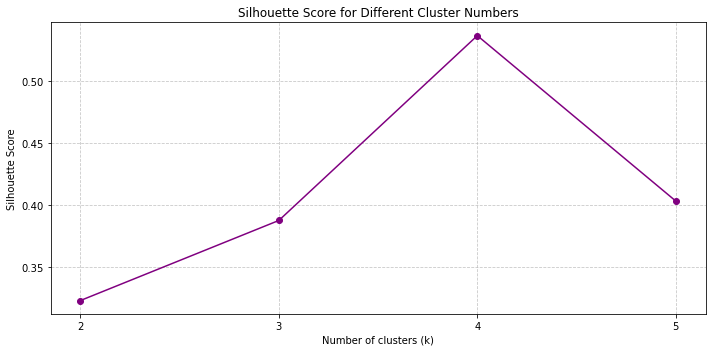

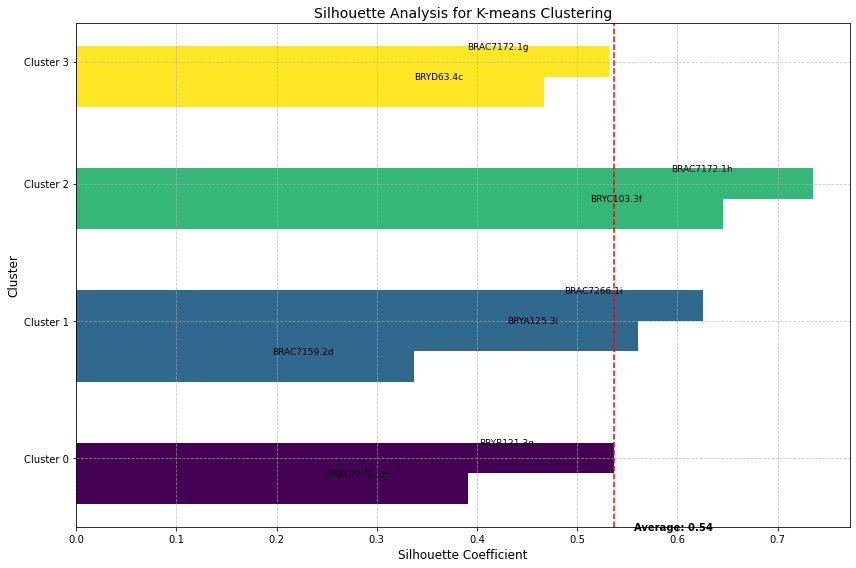

Cluster 0:
  Average silhouette score: 0.464
  Min silhouette score: 0.391
  Max silhouette score: 0.537
  Number of samples: 2

Cluster 1:
  Average silhouette score: 0.508
  Min silhouette score: 0.337
  Max silhouette score: 0.625
  Number of samples: 3

Cluster 2:
  Average silhouette score: 0.690
  Min silhouette score: 0.645
  Max silhouette score: 0.735
  Number of samples: 2

Cluster 3:
  Average silhouette score: 0.499
  Min silhouette score: 0.467
  Max silhouette score: 0.532
  Number of samples: 2



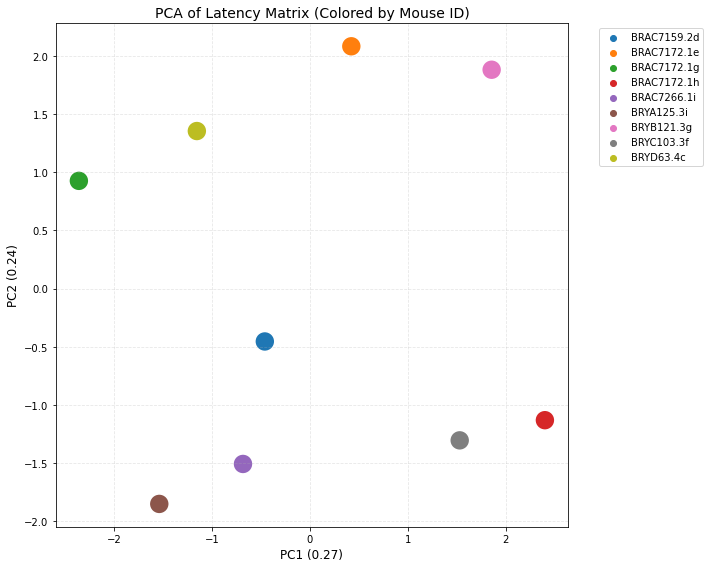

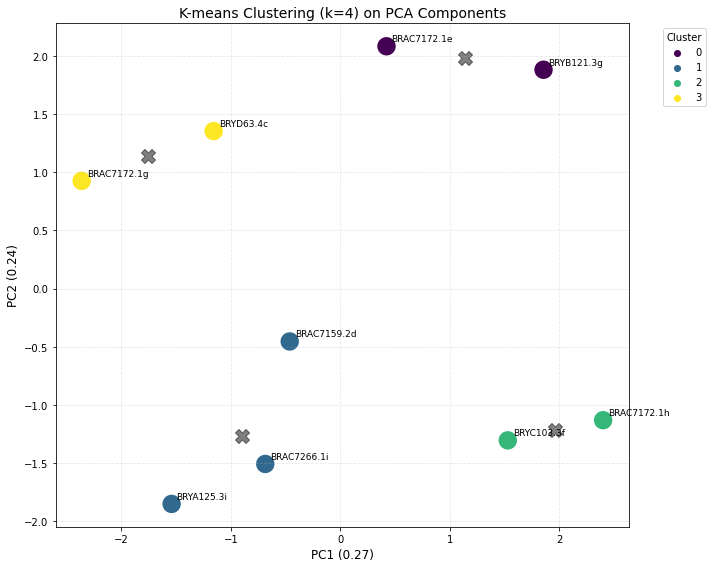

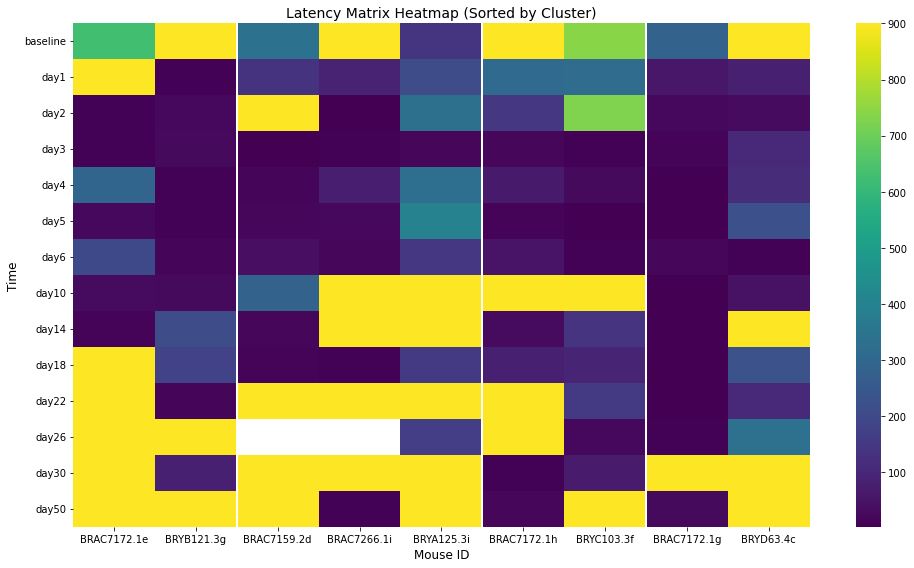

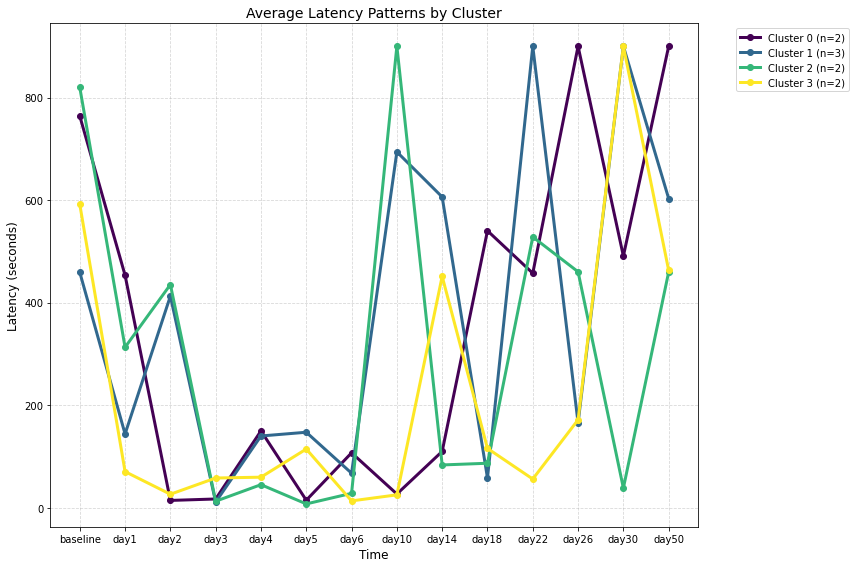

Cluster 0 mice: ['BRAC7172.1e', 'BRYB121.3g']
Cluster 1 mice: ['BRAC7159.2d', 'BRAC7266.1i', 'BRYA125.3i']
Cluster 2 mice: ['BRAC7172.1h', 'BRYC103.3f']
Cluster 3 mice: ['BRAC7172.1g', 'BRYD63.4c']


In [30]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.metrics import silhouette_score, silhouette_samples

# Handle missing values in the matrix (if any)
imputer = SimpleImputer(strategy='mean')
latency_matrix_imputed = imputer.fit_transform(latency_matrix)

# Standardize the data (important for PCA)
scaler = StandardScaler()
latency_matrix_scaled = scaler.fit_transform(latency_matrix_imputed)

# Transpose the matrix so each row is a mouse and each column is a timepoint
latency_matrix_T = latency_matrix_scaled.T

# Apply PCA
pca = PCA(n_components=2)  # Using 2 components for visualization
pca_result = pca.fit_transform(latency_matrix_T)

# Calculate explained variance
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.2f}")
print(f"Explained variance by PC2: {explained_variance[1]:.2f}")
print(f"Total explained variance: {sum(explained_variance):.2f}")

# Determine optimal number of clusters using silhouette score
silhouette_scores = []
K_range = range(2, min(6, len(latency_matrix_T)))  # Test 2-5 clusters (or fewer if limited data points)
for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    # Apply K-means to the PCA results (not the original data)
    cluster_labels = kmeans.fit_predict(pca_result)
    score = silhouette_score(pca_result, cluster_labels)
    silhouette_scores.append(score)
    print(f"Silhouette score for k={k}: {score:.3f}")

# Get optimal k (highest silhouette score)
optimal_k = K_range[np.argmax(silhouette_scores)]
print(f"Optimal number of clusters: {optimal_k}")

# Plot silhouette scores
plt.figure(figsize=(10, 5))
plt.plot(K_range, silhouette_scores, 'o-', color='purple')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Different Cluster Numbers')
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(K_range)
plt.tight_layout()
plt.show()

# Apply K-means with optimal k to the PCA results
kmeans = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
cluster_labels = kmeans.fit_predict(pca_result)

# Calculate silhouette coefficient for each sample
silhouette_vals = silhouette_samples(pca_result, cluster_labels)

# Create a DataFrame to store mouse IDs, cluster assignments, and silhouette scores
silhouette_df = pd.DataFrame({
    'Mouse_ID': pivot_df.columns,
    'Cluster': cluster_labels,
    'Silhouette': silhouette_vals
})

# Sort the DataFrame by cluster first, then by silhouette score within each cluster
silhouette_df = silhouette_df.sort_values(['Cluster', 'Silhouette'])

# Create a figure for the silhouette plot
plt.figure(figsize=(12, 8))

# Get the number of clusters
n_clusters = len(silhouette_df['Cluster'].unique())

# Set up the y position for each sample
y_lower = 10
y_ticks = []
y_ticklabels = []

# Create color palette for the clusters
colors = plt.cm.viridis(np.linspace(0, 1, n_clusters))

# Plot silhouette scores for each cluster
for i, cluster in enumerate(sorted(silhouette_df['Cluster'].unique())):
    # Get the silhouette scores for samples in this cluster
    cluster_silhouette_vals = silhouette_df[silhouette_df['Cluster'] == cluster]['Silhouette'].values
    cluster_mouse_ids = silhouette_df[silhouette_df['Cluster'] == cluster]['Mouse_ID'].values
    
    # Get the size of this cluster
    size_cluster = len(cluster_silhouette_vals)
    
    # Set y positions for this cluster
    y_upper = y_lower + size_cluster
    
    # Fill the silhouette plot with bars
    plt.barh(range(y_lower, y_upper), cluster_silhouette_vals, 
             height=1.0, edgecolor='none', color=colors[i])
    
    # Annotate with mouse IDs
    for j, (silhouette, mouse_id) in enumerate(zip(cluster_silhouette_vals, cluster_mouse_ids)):
        plt.text(silhouette - 0.08, y_lower + j + 0.5, mouse_id, 
                 fontsize=9, ha='right', va='center')
    
    # Add cluster label at the center of the cluster
    y_ticks.append(y_lower + size_cluster / 2)
    y_ticklabels.append(f'Cluster {cluster}')
    
    # Compute the new y_lower for next cluster
    y_lower = y_upper + 2  # Add spacing between clusters

# Set plot attributes
plt.axvline(x=np.mean(silhouette_vals), color="red", linestyle="--")
plt.xlabel('Silhouette Coefficient', fontsize=12)
plt.yticks(y_ticks, y_ticklabels)
plt.ylabel('Cluster', fontsize=12)
plt.title('Silhouette Analysis for K-means Clustering', fontsize=14)

# Add the average silhouette score to the plot
plt.text(np.mean(silhouette_vals) + 0.02, plt.ylim()[0], 
         f'Average: {np.mean(silhouette_vals):.2f}', 
         va='center', fontweight='bold')

plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Print statistics for each cluster
for cluster in sorted(silhouette_df['Cluster'].unique()):
    cluster_scores = silhouette_df[silhouette_df['Cluster'] == cluster]['Silhouette']
    print(f"Cluster {cluster}:")
    print(f"  Average silhouette score: {cluster_scores.mean():.3f}")
    print(f"  Min silhouette score: {cluster_scores.min():.3f}")
    print(f"  Max silhouette score: {cluster_scores.max():.3f}")
    print(f"  Number of samples: {len(cluster_scores)}")
    print()

# Create a DataFrame for plotting
pca_df = pd.DataFrame({
    'PC1': pca_result[:, 0],
    'PC2': pca_result[:, 1],
    'Mouse_ID': pivot_df.columns,
    'Cluster': cluster_labels
})

# Plot 1: PCA colored by mouse ID
plt.figure(figsize=(10, 8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, hue='Mouse_ID', s=400)
plt.title('PCA of Latency Matrix (Colored by Mouse ID)', fontsize=14)
plt.xlabel(f'PC1 ({explained_variance[0]:.2f})', fontsize=12)
plt.ylabel(f'PC2 ({explained_variance[1]:.2f})', fontsize=12)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, linestyle='--', alpha=0.3)
plt.tight_layout()
plt.show()

# Plot 2: PCA colored by cluster
plt.figure(figsize=(10, 8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, hue='Cluster', palette='viridis', s=400)

# Add mouse ID labels to each point
for i, txt in enumerate(pca_df['Mouse_ID']):
    plt.annotate(txt, (pca_df['PC1'][i], pca_df['PC2'][i]), fontsize=9, 
                 xytext=(5, 5), textcoords='offset points')

# Plot cluster centers
centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5, marker='X')

plt.title(f'K-means Clustering (k={optimal_k}) on PCA Components', fontsize=14)
plt.xlabel(f'PC1 ({explained_variance[0]:.2f})', fontsize=12)
plt.ylabel(f'PC2 ({explained_variance[1]:.2f})', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.3)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# Plot 3: Original latency matrix as heatmap with clusters
plt.figure(figsize=(14, 8))
# Sort by cluster for better visualization
sorted_indices = np.argsort(cluster_labels)
sorted_matrix = latency_matrix[:, sorted_indices]
sorted_ids = [pivot_df.columns[i] for i in sorted_indices]

# Create heatmap
ax = sns.heatmap(sorted_matrix, cmap='viridis', 
                yticklabels=pivot_df.index.tolist(),
                xticklabels=sorted_ids)

# Add cluster separation lines
current_pos = 0
for cluster in range(optimal_k):
    cluster_size = np.sum(cluster_labels[sorted_indices] == cluster)
    if current_pos > 0 and current_pos < len(sorted_indices):
        plt.axvline(x=current_pos, color='white', linestyle='-', linewidth=2)
    current_pos += cluster_size

plt.title('Latency Matrix Heatmap (Sorted by Cluster)', fontsize=14)
plt.xlabel('Mouse ID', fontsize=12)
plt.ylabel('Time', fontsize=12)
plt.tight_layout()
plt.show()

# Get the colors from viridis palette to match the PCA plot
cluster_colors = plt.cm.viridis(np.linspace(0, 1, optimal_k))

# Plot 4: Visualize the average latency patterns for each cluster
plt.figure(figsize=(12, 8))

# For each cluster
for cluster in range(optimal_k):
    # Get mice in this cluster
    cluster_mice = pca_df[pca_df['Cluster'] == cluster]['Mouse_ID'].tolist()
    
    # Get indices of these mice in the original matrix
    mouse_indices = [list(pivot_df.columns).index(mouse) for mouse in cluster_mice]
    
    # Calculate average latency pattern
    cluster_avg = np.nanmean(latency_matrix[:, mouse_indices], axis=1)
    
    # Plot with matching color from viridis palette
    plt.plot(pivot_df.index, cluster_avg, 
             color=cluster_colors[cluster],  # Use the cluster-specific color
             linewidth=3, 
             marker='o', 
             label=f'Cluster {cluster} (n={len(cluster_mice)})')

plt.title('Average Latency Patterns by Cluster', fontsize=14)
plt.xlabel('Time', fontsize=12)
plt.ylabel('Latency (seconds)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# Print mice in each cluster
for cluster in range(optimal_k):
    cluster_mice = pca_df[pca_df['Cluster'] == cluster]['Mouse_ID'].tolist()
    print(f"Cluster {cluster} mice: {cluster_mice}")

In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib as mpl

# Set publication-ready styling
plt.rcParams.update({
    'font.family': 'Arial',
    'font.size': 14,          # Increased base font size
    'axes.titlesize': 16,     # Increased title font size
    'axes.labelsize': 16,     # Increased axes labels font size
    'xtick.labelsize': 14,    # Increased tick labels size
    'ytick.labelsize': 14,
    'legend.fontsize': 14,
    'legend.title_fontsize': 15,
    'figure.titlesize': 18,   # Increased figure title size
    'figure.dpi': 300
})

# Run PCA and K-means analysis as before (unchanged)
# ...

# Plot silhouette scores with improved styling
plt.figure(figsize=(8, 5))
plt.plot(K_range, silhouette_scores, 'o-', color='#7E6BC9', linewidth=2.5, markersize=10)
plt.xlabel('Number of Clusters (k)', fontweight='bold')
plt.ylabel('Silhouette Score', fontweight='bold')
plt.title('Optimal Cluster Number Determination', fontweight='bold')
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(K_range)
plt.ylim(0, max(silhouette_scores) * 1.2)

# Add value annotations
for i, score in enumerate(silhouette_scores):
    plt.annotate(f'{score:.3f}', 
                 xy=(K_range[i], score),
                 xytext=(0, 10), 
                 textcoords='offset points',
                 ha='center',
                 fontweight='bold',
                 fontsize=12)

# Highlight the optimal k
optimal_idx = np.argmax(silhouette_scores)
plt.scatter(K_range[optimal_idx], silhouette_scores[optimal_idx], 
            s=200, facecolors='none', edgecolors='red', linewidth=2)

sns.despine()
plt.tight_layout()
plt.savefig('silhouette_scores.pdf', bbox_inches='tight')
plt.show()

# Create a more compact silhouette plot
plt.figure(figsize=(10, 6))

# Get the number of clusters
n_clusters = len(silhouette_df['Cluster'].unique())

# Set up the y position for each sample
y_lower = 5
y_ticks = []
y_ticklabels = []

# Create color palette for the clusters
colors = plt.cm.viridis(np.linspace(0, 1, n_clusters))

# Plot silhouette scores for each cluster
for i, cluster in enumerate(sorted(silhouette_df['Cluster'].unique())):
    # Get the silhouette scores for samples in this cluster
    cluster_silhouette_vals = silhouette_df[silhouette_df['Cluster'] == cluster]['Silhouette'].values
    cluster_mouse_ids = silhouette_df[silhouette_df['Cluster'] == cluster]['Mouse_ID'].values
    
    # Get the size of this cluster
    size_cluster = len(cluster_silhouette_vals)
    
    # Set y positions for this cluster
    y_upper = y_lower + size_cluster
    
    # Fill the silhouette plot with bars
    plt.barh(range(y_lower, y_upper), cluster_silhouette_vals, 
             height=1.0, edgecolor='none', color=colors[i])
    
    # Annotate with mouse IDs (larger font)
    for j, (silhouette, mouse_id) in enumerate(zip(cluster_silhouette_vals, cluster_mouse_ids)):
        plt.text(silhouette - 0.1, y_lower + j + 0.5, mouse_id, 
                 fontsize=11, ha='right', va='center', fontweight='bold')
    
    # Add cluster label at the center of the cluster
    y_ticks.append(y_lower + size_cluster / 2)
    y_ticklabels.append(f'Cluster {cluster}')
    
    # Compute the new y_lower for next cluster
    y_lower = y_upper + 2  # Add spacing between clusters

# Set plot attributes
mean_silhouette = np.mean(silhouette_vals)
plt.axvline(x=mean_silhouette, color="red", linestyle="--", linewidth=2)
plt.xlabel('Silhouette Coefficient', fontweight='bold')
plt.yticks(y_ticks, y_ticklabels, fontweight='bold')
plt.ylabel('Cluster', fontweight='bold')
plt.title('Silhouette Analysis', fontweight='bold')

# Add the average silhouette score to the plot
plt.text(mean_silhouette + 0.02, plt.ylim()[0], 
         f'Average: {mean_silhouette:.2f}', 
         va='center', fontweight='bold', fontsize=14)

plt.grid(True, linestyle='--', alpha=0.7)
plt.xlim(-0.1, 1.0)  # Constrain x-axis to silhouette range
sns.despine()
plt.tight_layout()
plt.savefig('silhouette_analysis.pdf', bbox_inches='tight')
plt.show()

# Create a compact PCA plot
plt.figure(figsize=(9, 7))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, hue='Cluster', 
                palette='viridis', s=300, edgecolor='black', linewidth=1)

# Add mouse ID labels with larger font
for i, txt in enumerate(pca_df['Mouse_ID']):
    plt.annotate(txt, (pca_df['PC1'][i], pca_df['PC2'][i]), fontsize=12, 
                fontweight='bold', xytext=(7, 7), textcoords='offset points')

# Plot cluster centers with better visibility
centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=250, 
            alpha=0.7, marker='X', linewidth=2, label='Cluster Centers')

plt.title(f'K-means Clustering (k={optimal_k})', fontweight='bold')
plt.xlabel(f'PC1 ({explained_variance[0]:.2f})', fontweight='bold')
plt.ylabel(f'PC2 ({explained_variance[1]:.2f})', fontweight='bold')
plt.grid(True, linestyle='--', alpha=0.3)

# Add a legend with improved styling
legend = plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
legend.get_frame().set_facecolor('white')
legend.get_frame().set_alpha(0.9)
legend.get_frame().set_linewidth(1)

sns.despine()
plt.tight_layout()
plt.savefig('pca_clustering.pdf', bbox_inches='tight')
plt.savefig('pca_clustering.png', dpi=600, bbox_inches='tight')
plt.show()

# Create a more compact heatmap
plt.figure(figsize=(10, 7))

# Sort by cluster for better visualization
sorted_indices = np.argsort(cluster_labels)
sorted_matrix = latency_matrix[:, sorted_indices]
sorted_ids = [pivot_df.columns[i] for i in sorted_indices]

# Create heatmap with improved styling
ax = sns.heatmap(sorted_matrix, cmap='viridis', 
                yticklabels=pivot_df.index.tolist(),
                xticklabels=sorted_ids,
                linewidths=0.5,
                cbar_kws={"shrink": 0.8, "label": "Latency (seconds)"})

# Add cluster separation lines
current_pos = 0
for cluster in range(optimal_k):
    cluster_size = np.sum(cluster_labels[sorted_indices] == cluster)
    if current_pos > 0 and current_pos < len(sorted_indices):
        plt.axvline(x=current_pos, color='white', linestyle='-', linewidth=2.5)
        
        # Add cluster label
        plt.text(current_pos - cluster_size/2, -1.5, f'Cluster {cluster}', 
                 ha='center', va='center', fontsize=14, fontweight='bold', 
                 color='black', bbox=dict(facecolor='white', alpha=0.7, boxstyle='round,pad=0.3'))
    current_pos += cluster_size

# Add the last cluster label
plt.text(len(sorted_indices) - cluster_size/2, -1.5, f'Cluster {optimal_k-1}', 
         ha='center', va='center', fontsize=14, fontweight='bold', 
         color='black', bbox=dict(facecolor='white', alpha=0.7, boxstyle='round,pad=0.3'))

plt.title('Latency Matrix Heatmap', fontweight='bold')
plt.xlabel('Mouse ID', fontweight='bold')
plt.ylabel('Time', fontweight='bold')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig('latency_heatmap.pdf', bbox_inches='tight')
plt.savefig('latency_heatmap.png', dpi=600, bbox_inches='tight')
plt.show()

# Create a compact average latency pattern plot
plt.figure(figsize=(10, 6))

# For each cluster
for cluster in range(optimal_k):
    # Get mice in this cluster
    cluster_mice = pca_df[pca_df['Cluster'] == cluster]['Mouse_ID'].tolist()
    
    # Get indices of these mice in the original matrix
    mouse_indices = [list(pivot_df.columns).index(mouse) for mouse in cluster_mice]
    
    # Calculate average latency pattern
    cluster_avg = np.nanmean(latency_matrix[:, mouse_indices], axis=1)
    
    # Plot with matching color from viridis palette, improved styling
    plt.plot(pivot_df.index, cluster_avg, 
             color=cluster_colors[cluster],
             linewidth=3.5, 
             marker='o',
             markersize=8,
             label=f'Cluster {cluster} (n={len(cluster_mice)})')

# Add horizontal line at 900 to indicate no retrieval threshold
plt.axhline(y=900, color='gray', linestyle='--', alpha=0.7, linewidth=1.5,
            label='No retrieval observed')

plt.title('Average Latency Patterns by Cluster', fontweight='bold')
plt.xlabel('Time Point', fontweight='bold')
plt.ylabel('Latency (seconds)', fontweight='bold')
plt.grid(True, linestyle='--', alpha=0.5)
plt.xticks(rotation=45, ha='right')

# Create a more prominent legend
legend = plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
legend.get_frame().set_facecolor('white')
legend.get_frame().set_alpha(0.9)
legend.get_frame().set_linewidth(1)

sns.despine()
plt.tight_layout()
plt.savefig('cluster_latency_patterns.pdf', bbox_inches='tight')
plt.savefig('cluster_latency_patterns.png', dpi=600, bbox_inches='tight')
plt.show()

# Print mice in each cluster in a more readable format
print("\nCLUSTER MEMBERSHIP:")
print("=" * 50)
for cluster in range(optimal_k):
    cluster_mice = pca_df[pca_df['Cluster'] == cluster]['Mouse_ID'].tolist()
    print(f"Cluster {cluster} (n={len(cluster_mice)}):")
    print(f"  Mice: {', '.join(cluster_mice)}")
    print("-" * 50)

Explained variance by PC1: 0.27
Explained variance by PC2: 0.24
Total explained variance: 0.51
Silhouette score for k=2: 0.323
Silhouette score for k=3: 0.388
Silhouette score for k=4: 0.537
Silhouette score for k=5: 0.403
Optimal number of clusters: 4


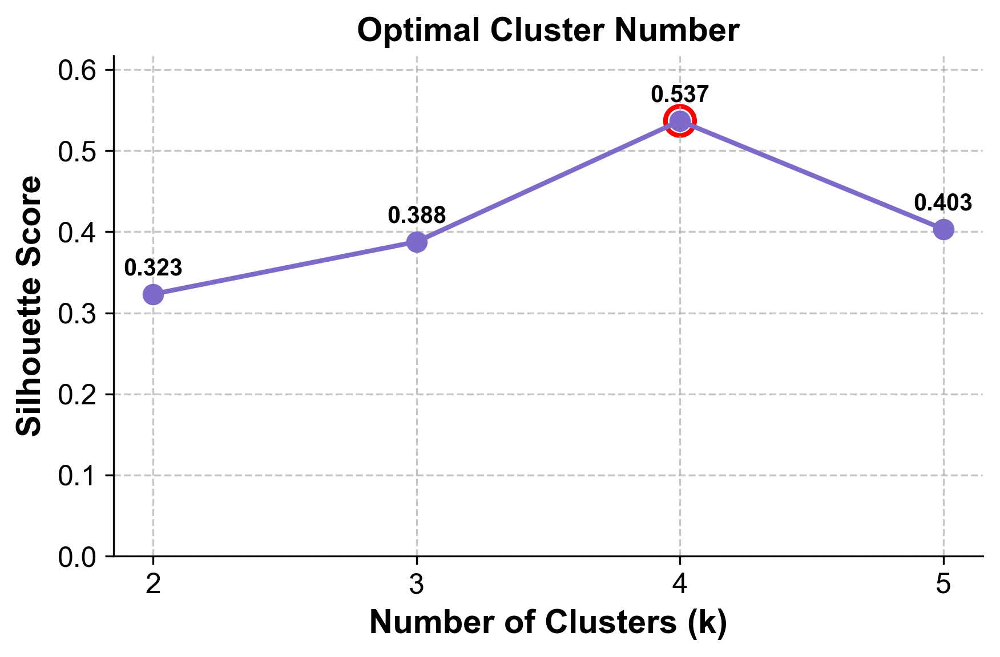

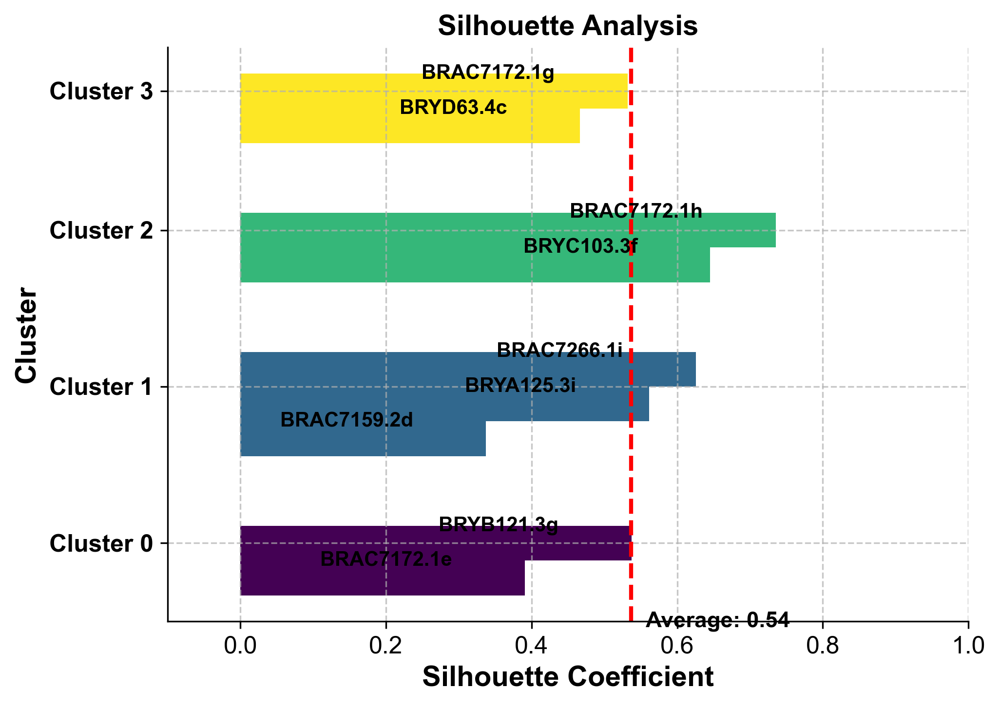

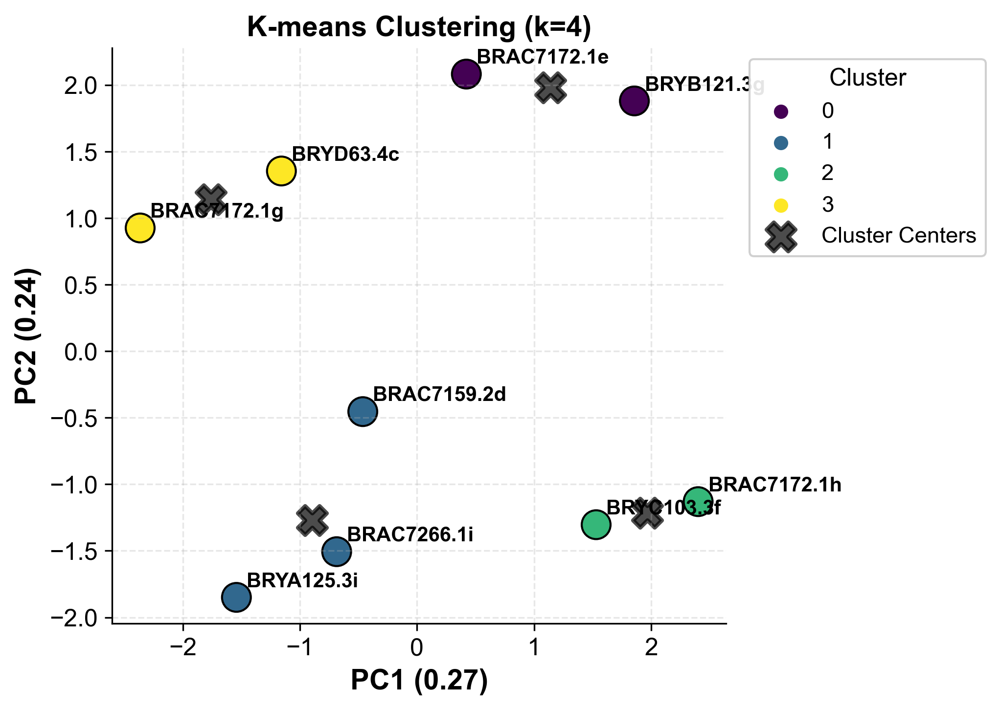

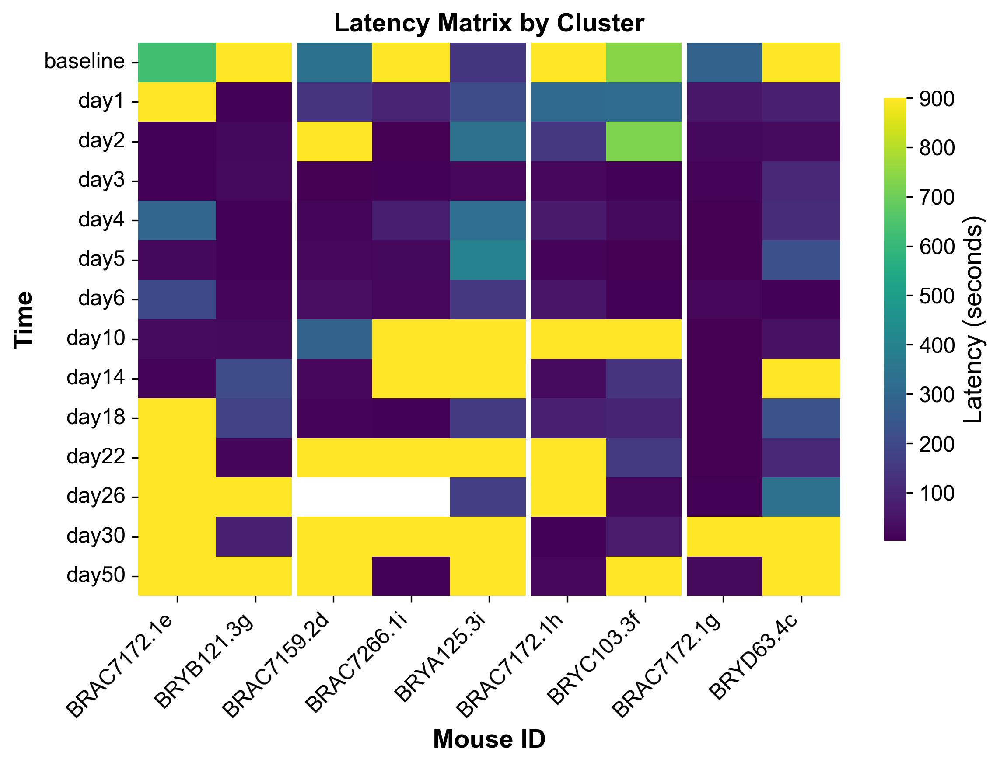

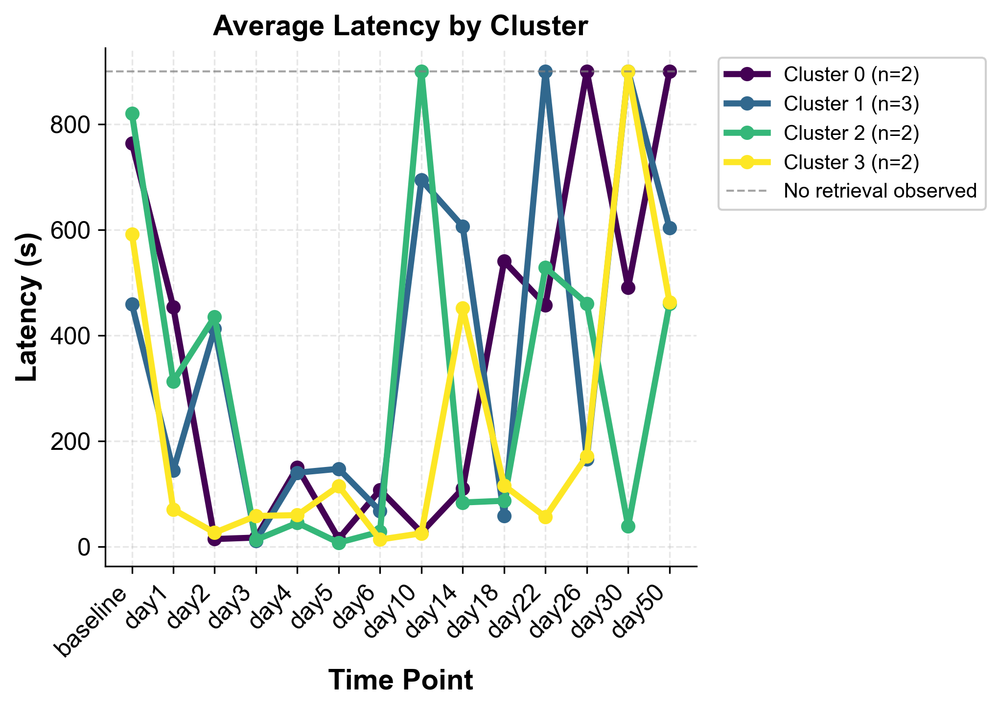


CLUSTER MEMBERSHIP:
Cluster 0 (n=2):
  Mice: BRAC7172.1e, BRYB121.3g
--------------------------------------------------
Cluster 1 (n=3):
  Mice: BRAC7159.2d, BRAC7266.1i, BRYA125.3i
--------------------------------------------------
Cluster 2 (n=2):
  Mice: BRAC7172.1h, BRYC103.3f
--------------------------------------------------
Cluster 3 (n=2):
  Mice: BRAC7172.1g, BRYD63.4c
--------------------------------------------------


In [34]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib as mpl

# Set publication-ready styling with slightly smaller sizes for compactness
plt.rcParams.update({
    'font.family': 'Arial',
    'font.size': 12,          # Slightly smaller base font size
    'axes.titlesize': 14,     # Smaller title font size
    'axes.labelsize': 14,     # Smaller axes labels font size
    'xtick.labelsize': 12,    # Smaller tick labels size
    'ytick.labelsize': 12,
    'legend.fontsize': 11,
    'legend.title_fontsize': 12,
    'figure.titlesize': 16,
    'figure.dpi': 300
})

# Handle missing values in the matrix (if any)
imputer = SimpleImputer(strategy='mean')
latency_matrix_imputed = imputer.fit_transform(latency_matrix)

# Standardize the data (important for PCA)
scaler = StandardScaler()
latency_matrix_scaled = scaler.fit_transform(latency_matrix_imputed)

# Transpose the matrix so each row is a mouse and each column is a timepoint
latency_matrix_T = latency_matrix_scaled.T

# Apply PCA
pca = PCA(n_components=2)  # Using 2 components for visualization
pca_result = pca.fit_transform(latency_matrix_T)

# Calculate explained variance
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.2f}")
print(f"Explained variance by PC2: {explained_variance[1]:.2f}")
print(f"Total explained variance: {sum(explained_variance):.2f}")

# Determine optimal number of clusters using silhouette score
silhouette_scores = []
K_range = range(2, min(6, len(latency_matrix_T)))  # Test 2-5 clusters (or fewer if limited data points)
for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    # Apply K-means to the PCA results (not the original data)
    cluster_labels = kmeans.fit_predict(pca_result)
    score = silhouette_score(pca_result, cluster_labels)
    silhouette_scores.append(score)
    print(f"Silhouette score for k={k}: {score:.3f}")

# Get optimal k (highest silhouette score)
optimal_k = K_range[np.argmax(silhouette_scores)]
print(f"Optimal number of clusters: {optimal_k}")

# Plot silhouette scores with improved styling - more compact
plt.figure(figsize=(6, 4))
plt.plot(K_range, silhouette_scores, 'o-', color='#7E6BC9', linewidth=2, markersize=8)
plt.xlabel('Number of Clusters (k)', fontweight='bold')
plt.ylabel('Silhouette Score', fontweight='bold')
plt.title('Optimal Cluster Number', fontweight='bold')
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(K_range)
plt.ylim(0, max(silhouette_scores) * 1.15)

# Add value annotations
for i, score in enumerate(silhouette_scores):
    plt.annotate(f'{score:.3f}', 
                 xy=(K_range[i], score),
                 xytext=(0, 8), 
                 textcoords='offset points',
                 ha='center',
                 fontweight='bold',
                 fontsize=10)

# Highlight the optimal k
optimal_idx = np.argmax(silhouette_scores)
plt.scatter(K_range[optimal_idx], silhouette_scores[optimal_idx], 
            s=150, facecolors='none', edgecolors='red', linewidth=2)

sns.despine()
plt.tight_layout()
plt.savefig('plots/silhouette_scores.png', dpi=600, bbox_inches='tight')
plt.show()

# Apply K-means with optimal k to the PCA results
kmeans = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
cluster_labels = kmeans.fit_predict(pca_result)

# Calculate silhouette coefficient for each sample
silhouette_vals = silhouette_samples(pca_result, cluster_labels)

# Create a DataFrame to store mouse IDs, cluster assignments, and silhouette scores
silhouette_df = pd.DataFrame({
    'Mouse_ID': pivot_df.columns,
    'Cluster': cluster_labels,
    'Silhouette': silhouette_vals
})

# Sort the DataFrame by cluster first, then by silhouette score within each cluster
silhouette_df = silhouette_df.sort_values(['Cluster', 'Silhouette'])

# Create a more compact silhouette plot
plt.figure(figsize=(7, 5))

# Get the number of clusters
n_clusters = len(silhouette_df['Cluster'].unique())

# Set up the y position for each sample
y_lower = 5
y_ticks = []
y_ticklabels = []

# Create color palette for the clusters
colors = plt.cm.viridis(np.linspace(0, 1, n_clusters))

# Plot silhouette scores for each cluster
for i, cluster in enumerate(sorted(silhouette_df['Cluster'].unique())):
    # Get the silhouette scores for samples in this cluster
    cluster_silhouette_vals = silhouette_df[silhouette_df['Cluster'] == cluster]['Silhouette'].values
    cluster_mouse_ids = silhouette_df[silhouette_df['Cluster'] == cluster]['Mouse_ID'].values
    
    # Get the size of this cluster
    size_cluster = len(cluster_silhouette_vals)
    
    # Set y positions for this cluster
    y_upper = y_lower + size_cluster
    
    # Fill the silhouette plot with bars
    plt.barh(range(y_lower, y_upper), cluster_silhouette_vals, 
             height=1.0, edgecolor='none', color=colors[i])
    
    # Annotate with mouse IDs (larger font)
    for j, (silhouette, mouse_id) in enumerate(zip(cluster_silhouette_vals, cluster_mouse_ids)):
        plt.text(silhouette - 0.1, y_lower + j + 0.5, mouse_id, 
                 fontsize=10, ha='right', va='center', fontweight='bold')
    
    # Add cluster label at the center of the cluster
    y_ticks.append(y_lower + size_cluster / 2)
    y_ticklabels.append(f'Cluster {cluster}')
    
    # Compute the new y_lower for next cluster
    y_lower = y_upper + 2  # Add spacing between clusters

# Set plot attributes
mean_silhouette = np.mean(silhouette_vals)
plt.axvline(x=mean_silhouette, color="red", linestyle="--", linewidth=2)
plt.xlabel('Silhouette Coefficient', fontweight='bold')
plt.yticks(y_ticks, y_ticklabels, fontweight='bold')
plt.ylabel('Cluster', fontweight='bold')
plt.title('Silhouette Analysis', fontweight='bold')

# Add the average silhouette score to the plot
plt.text(mean_silhouette + 0.02, plt.ylim()[0], 
         f'Average: {mean_silhouette:.2f}', 
         va='center', fontweight='bold', fontsize=11)

plt.grid(True, linestyle='--', alpha=0.7)
plt.xlim(-0.1, 1.0)  # Constrain x-axis to silhouette range
sns.despine()
plt.tight_layout()
plt.savefig('plots/silhouette_analysis.png', dpi=600, bbox_inches='tight')
plt.show()

# Create a DataFrame for plotting
pca_df = pd.DataFrame({
    'PC1': pca_result[:, 0],
    'PC2': pca_result[:, 1],
    'Mouse_ID': pivot_df.columns,
    'Cluster': cluster_labels
})

# Create a compact PCA plot with grid
plt.figure(figsize=(7, 5))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, hue='Cluster', 
                palette='viridis', s=200, edgecolor='black', linewidth=1)

# Add mouse ID labels with compact layout
for i, txt in enumerate(pca_df['Mouse_ID']):
    plt.annotate(txt, (pca_df['PC1'][i], pca_df['PC2'][i]), fontsize=10, 
                fontweight='bold', xytext=(5, 5), textcoords='offset points')

# Plot cluster centers with better visibility
centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, 
            alpha=0.7, marker='X', linewidth=2, label='Cluster Centers')

plt.title(f'K-means Clustering (k={optimal_k})', fontweight='bold')
plt.xlabel(f'PC1 ({explained_variance[0]:.2f})', fontweight='bold')
plt.ylabel(f'PC2 ({explained_variance[1]:.2f})', fontweight='bold')
plt.grid(True, linestyle='--', alpha=0.3)  # Keeping the grid as requested

# Add a legend with improved styling
legend = plt.legend(title='Cluster', bbox_to_anchor=(1.02, 1), loc='upper left', frameon=True)
legend.get_frame().set_facecolor('white')
legend.get_frame().set_alpha(0.9)
legend.get_frame().set_linewidth(1)

sns.despine()
plt.tight_layout()
plt.savefig('plots/pca_clustering.png', dpi=600, bbox_inches='tight')
plt.show()

# Create a more compact heatmap with no spacing between cells and no cluster labels
plt.figure(figsize=(8, 6))

# Sort by cluster for better visualization
sorted_indices = np.argsort(cluster_labels)
sorted_matrix = latency_matrix[:, sorted_indices]
sorted_ids = [pivot_df.columns[i] for i in sorted_indices]

# Create heatmap with NO spaces between cells but with cluster separations
ax = sns.heatmap(sorted_matrix, cmap='viridis', 
                yticklabels=pivot_df.index.tolist(),
                xticklabels=sorted_ids,
                linewidths=0,  # No grid lines between cells
                linecolor='none',  # No grid color
                cbar_kws={"shrink": 0.8, "label": "Latency (seconds)"})

# Add ONLY cluster separation lines without labels
current_pos = 0
for cluster in range(optimal_k):
    cluster_size = np.sum(cluster_labels[sorted_indices] == cluster)
    if current_pos > 0 and current_pos < len(sorted_indices):
        plt.axvline(x=current_pos, color='white', linestyle='-', linewidth=3)
    current_pos += cluster_size

plt.title('Latency Matrix by Cluster', fontweight='bold')
plt.xlabel('Mouse ID', fontweight='bold')
plt.ylabel('Time', fontweight='bold')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig('plots/latency_heatmap.png', dpi=600, bbox_inches='tight')
plt.show()

# Get the colors from viridis palette to match the PCA plot
cluster_colors = plt.cm.viridis(np.linspace(0, 1, optimal_k))

# Create a compact average latency pattern plot
plt.figure(figsize=(7, 5))

# For each cluster
for cluster in range(optimal_k):
    # Get mice in this cluster
    cluster_mice = pca_df[pca_df['Cluster'] == cluster]['Mouse_ID'].tolist()
    
    # Get indices of these mice in the original matrix
    mouse_indices = [list(pivot_df.columns).index(mouse) for mouse in cluster_mice]
    
    # Calculate average latency pattern
    cluster_avg = np.nanmean(latency_matrix[:, mouse_indices], axis=1)
    
    # Plot with matching color from viridis palette, improved styling
    plt.plot(pivot_df.index, cluster_avg, 
             color=cluster_colors[cluster],
             linewidth=3, 
             marker='o',
             markersize=6,
             label=f'Cluster {cluster} (n={len(cluster_mice)})')

# Add horizontal line at 900 to indicate no retrieval threshold
plt.axhline(y=900, color='gray', linestyle='--', alpha=0.7, linewidth=1,
            label='No retrieval observed')

plt.title('Average Latency by Cluster', fontweight='bold')
plt.xlabel('Time Point', fontweight='bold')
plt.ylabel('Latency (s)', fontweight='bold')
plt.grid(True, linestyle='--', alpha=0.3)
plt.xticks(rotation=45, ha='right')

# Create a more prominent legend but more compact
legend = plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', frameon=True, fontsize=10)
legend.get_frame().set_facecolor('white')
legend.get_frame().set_alpha(0.9)
legend.get_frame().set_linewidth(1)

sns.despine()
plt.tight_layout()
plt.savefig('plots/cluster_latency_patterns.png', dpi=600, bbox_inches='tight')
plt.show()

# Print mice in each cluster
print("\nCLUSTER MEMBERSHIP:")
print("=" * 50)
for cluster in range(optimal_k):
    cluster_mice = pca_df[pca_df['Cluster'] == cluster]['Mouse_ID'].tolist()
    print(f"Cluster {cluster} (n={len(cluster_mice)}):")
    print(f"  Mice: {', '.join(cluster_mice)}")
    print("-" * 50)

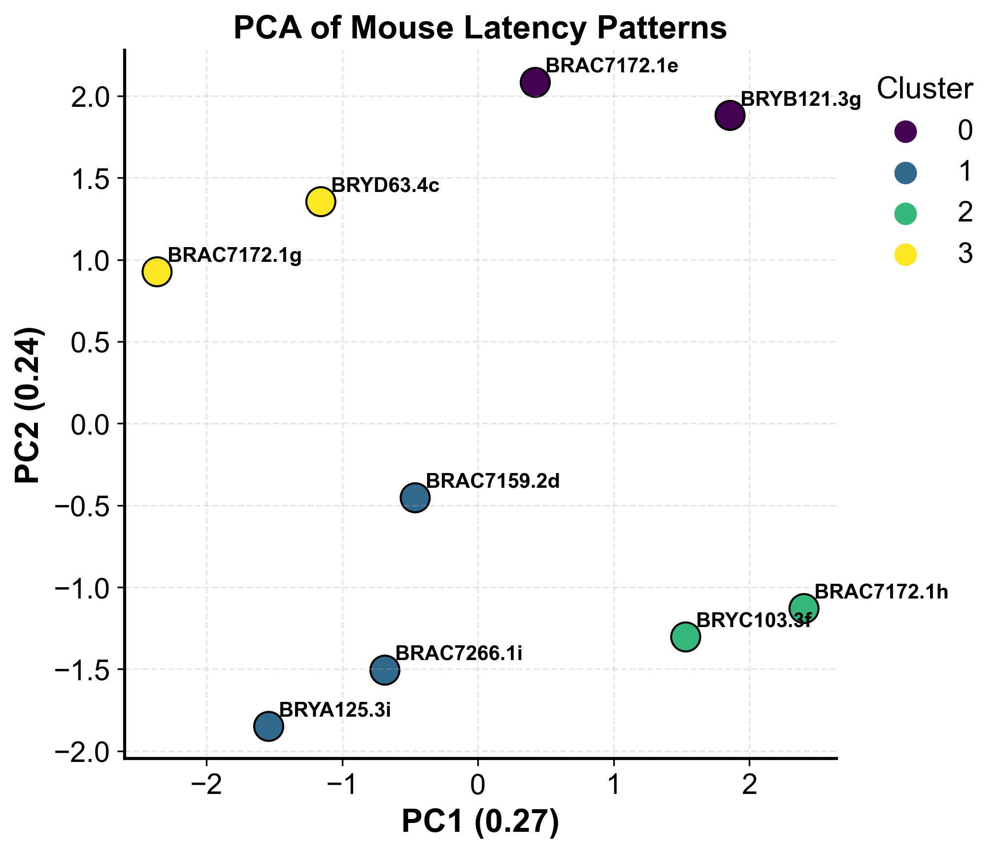

In [43]:
# Create a publication-ready PCA plot with matching style to the k-means clustering plot
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Set publication-ready styling to match the clustering plot
plt.rcParams.update({
    'font.family': 'Arial',
    'font.size': 14,
    'axes.titlesize': 16,
    'axes.labelsize': 16,
    'xtick.labelsize': 14,
    'ytick.labelsize': 14,
    'legend.fontsize': 14,
    'legend.title_fontsize': 15
})

# Create a figure with the same dimensions as the clustering plot
plt.figure(figsize=(7, 6))

# Create the scatter plot with larger points, black edges, and viridis color palette
# (Using cluster labels from the clustering plot instead of individual mouse colors)
sns.scatterplot(x='PC1', y='PC2', data=pca_df, hue='Cluster', 
                palette='viridis', s=200, edgecolor='black', linewidth=1)

# Add mouse ID labels with the same style as in the clustering plot
for i, txt in enumerate(pca_df['Mouse_ID']):
    plt.annotate(txt, (pca_df['PC1'][i], pca_df['PC2'][i]), 
                fontsize=10, fontweight='bold', 
                xytext=(5, 5), textcoords='offset points')

# Add grid with matching style to the clustering plot
plt.grid(True, linestyle='--', alpha=0.3)

# Set title and axis labels with bold styling
plt.title('PCA of Mouse Latency Patterns', fontweight='bold')
plt.xlabel(f'PC1 ({explained_variance[0]:.2f})', fontweight='bold')
plt.ylabel(f'PC2 ({explained_variance[1]:.2f})', fontweight='bold')

# Create a legend that matches the clustering plot style
legend = plt.legend(title='Cluster', bbox_to_anchor=(1.02, 1), 
                   loc='upper left', frameon=False)
legend.get_frame().set_facecolor('white')
legend.get_frame().set_alpha(0.9)
legend.get_frame().set_linewidth(1)

# Remove top and right spines for cleaner look
sns.despine()

# Ensure tight layout
plt.tight_layout()

# Save with high resolution
plt.savefig('plots/pca_plot_publication.png', dpi=600, bbox_inches='tight')
plt.savefig('plots/pca_plot_publication.pdf', bbox_inches='tight')

plt.show()

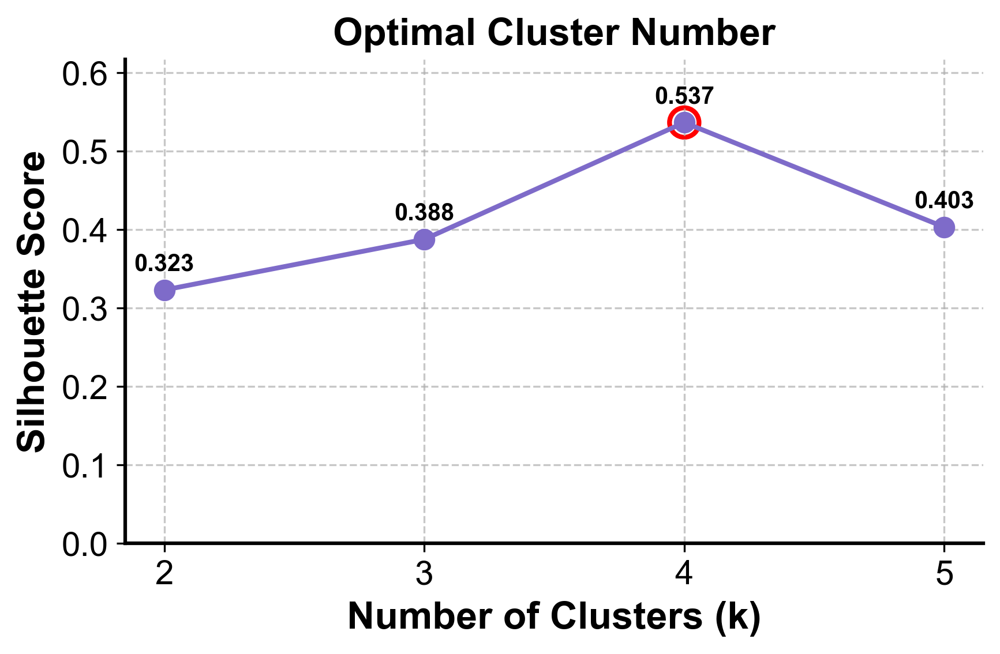

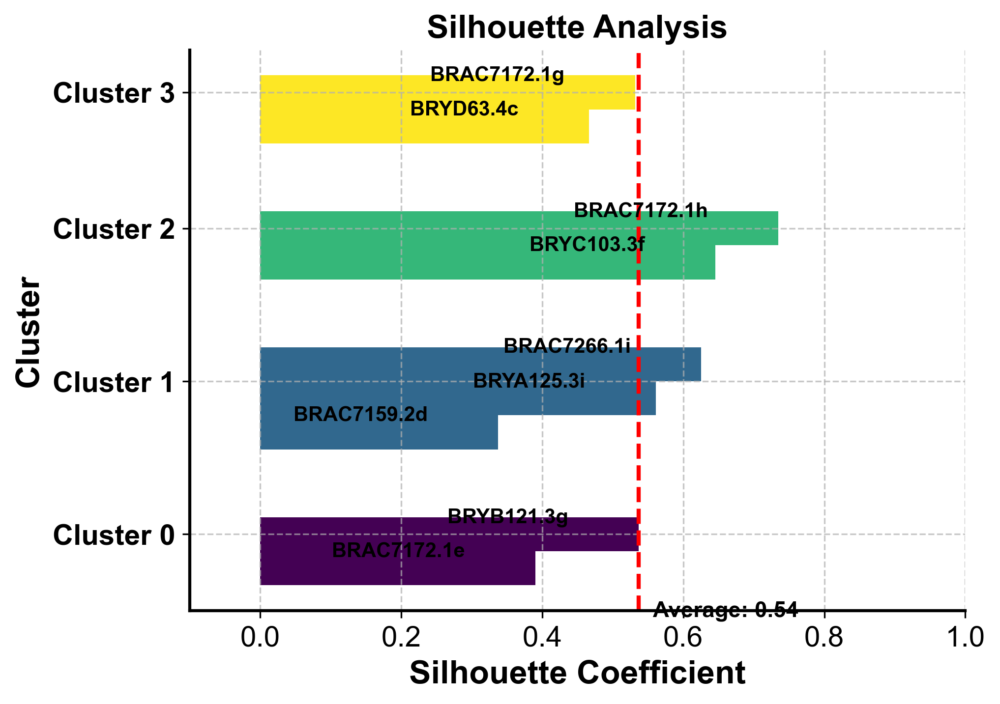

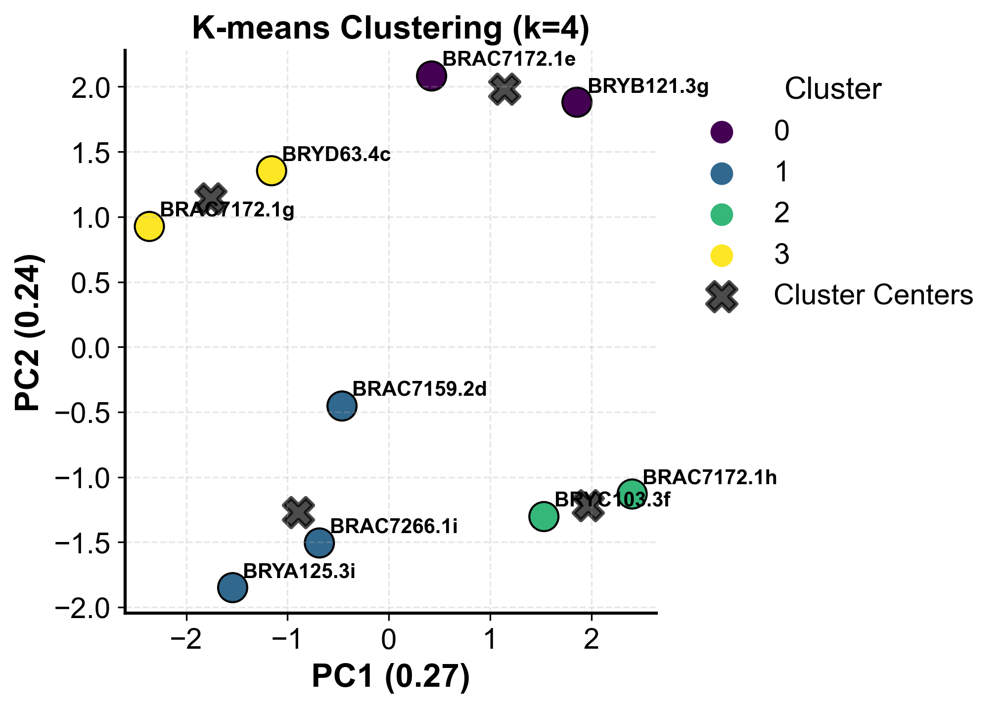

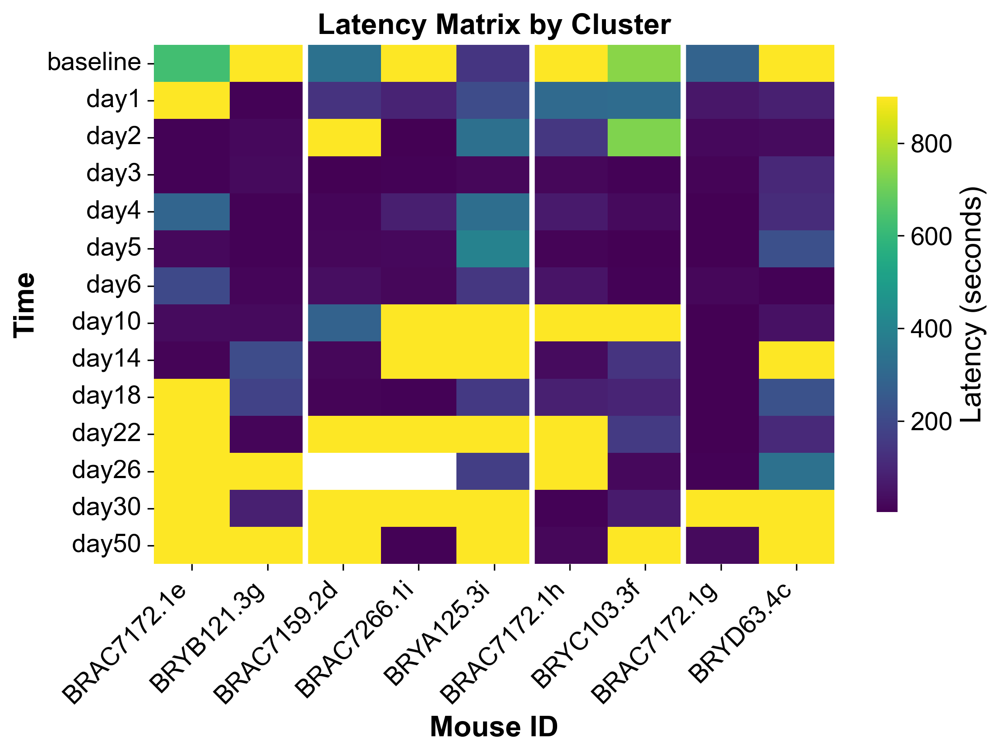

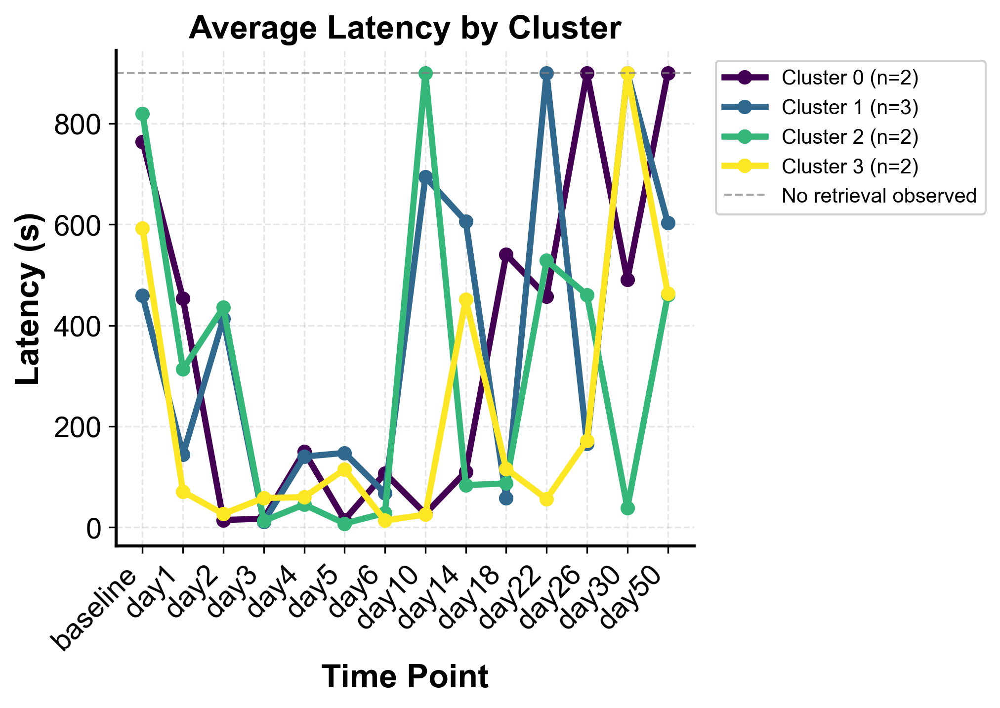


CLUSTER MEMBERSHIP:
Cluster 0 (n=2):
  Mice: BRAC7172.1e, BRYB121.3g
--------------------------------------------------
Cluster 1 (n=3):
  Mice: BRAC7159.2d, BRAC7266.1i, BRYA125.3i
--------------------------------------------------
Cluster 2 (n=2):
  Mice: BRAC7172.1h, BRYC103.3f
--------------------------------------------------
Cluster 3 (n=2):
  Mice: BRAC7172.1g, BRYD63.4c
--------------------------------------------------


In [42]:
# Plot silhouette scores with improved styling - more compact
plt.figure(figsize=(6, 4))
plt.plot(K_range, silhouette_scores, 'o-', color='#7E6BC9', linewidth=2, markersize=8)
plt.xlabel('Number of Clusters (k)', fontweight='bold')
plt.ylabel('Silhouette Score', fontweight='bold')
plt.title('Optimal Cluster Number', fontweight='bold')
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(K_range)
plt.ylim(0, max(silhouette_scores) * 1.15)

# Add value annotations
for i, score in enumerate(silhouette_scores):
    plt.annotate(f'{score:.3f}', 
                 xy=(K_range[i], score),
                 xytext=(0, 8), 
                 textcoords='offset points',
                 ha='center',
                 fontweight='bold',
                 fontsize=10)

# Highlight the optimal k
optimal_idx = np.argmax(silhouette_scores)
plt.scatter(K_range[optimal_idx], silhouette_scores[optimal_idx], 
            s=150, facecolors='none', edgecolors='red', linewidth=2)

sns.despine()
plt.tight_layout()
plt.savefig('plots/silhouette_scores.png', dpi=600, bbox_inches='tight')
plt.show()

# Apply K-means with optimal k to the PCA results
kmeans = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
cluster_labels = kmeans.fit_predict(pca_result)

# Calculate silhouette coefficient for each sample
silhouette_vals = silhouette_samples(pca_result, cluster_labels)

# Create a DataFrame to store mouse IDs, cluster assignments, and silhouette scores
silhouette_df = pd.DataFrame({
    'Mouse_ID': pivot_df.columns,
    'Cluster': cluster_labels,
    'Silhouette': silhouette_vals
})

# Sort the DataFrame by cluster first, then by silhouette score within each cluster
silhouette_df = silhouette_df.sort_values(['Cluster', 'Silhouette'])

# Create a more compact silhouette plot
plt.figure(figsize=(7, 5))

# Get the number of clusters
n_clusters = len(silhouette_df['Cluster'].unique())

# Set up the y position for each sample
y_lower = 5
y_ticks = []
y_ticklabels = []

# Create color palette for the clusters
colors = plt.cm.viridis(np.linspace(0, 1, n_clusters))

# Plot silhouette scores for each cluster
for i, cluster in enumerate(sorted(silhouette_df['Cluster'].unique())):
    # Get the silhouette scores for samples in this cluster
    cluster_silhouette_vals = silhouette_df[silhouette_df['Cluster'] == cluster]['Silhouette'].values
    cluster_mouse_ids = silhouette_df[silhouette_df['Cluster'] == cluster]['Mouse_ID'].values
    
    # Get the size of this cluster
    size_cluster = len(cluster_silhouette_vals)
    
    # Set y positions for this cluster
    y_upper = y_lower + size_cluster
    
    # Fill the silhouette plot with bars
    plt.barh(range(y_lower, y_upper), cluster_silhouette_vals, 
             height=1.0, edgecolor='none', color=colors[i])
    
    # Annotate with mouse IDs (larger font)
    for j, (silhouette, mouse_id) in enumerate(zip(cluster_silhouette_vals, cluster_mouse_ids)):
        plt.text(silhouette - 0.1, y_lower + j + 0.5, mouse_id, 
                 fontsize=10, ha='right', va='center', fontweight='bold')
    
    # Add cluster label at the center of the cluster
    y_ticks.append(y_lower + size_cluster / 2)
    y_ticklabels.append(f'Cluster {cluster}')
    
    # Compute the new y_lower for next cluster
    y_lower = y_upper + 2  # Add spacing between clusters

# Set plot attributes
mean_silhouette = np.mean(silhouette_vals)
plt.axvline(x=mean_silhouette, color="red", linestyle="--", linewidth=2)
plt.xlabel('Silhouette Coefficient', fontweight='bold')
plt.yticks(y_ticks, y_ticklabels, fontweight='bold')
plt.ylabel('Cluster', fontweight='bold')
plt.title('Silhouette Analysis', fontweight='bold')

# Add the average silhouette score to the plot
plt.text(mean_silhouette + 0.02, plt.ylim()[0], 
         f'Average: {mean_silhouette:.2f}', 
         va='center', fontweight='bold', fontsize=11)

plt.grid(True, linestyle='--', alpha=0.7)
plt.xlim(-0.1, 1.0)  # Constrain x-axis to silhouette range
sns.despine()
plt.tight_layout()
plt.savefig('plots/silhouette_analysis.png', dpi=600, bbox_inches='tight')
plt.show()

# Create a DataFrame for plotting
pca_df = pd.DataFrame({
    'PC1': pca_result[:, 0],
    'PC2': pca_result[:, 1],
    'Mouse_ID': pivot_df.columns,
    'Cluster': cluster_labels
})

# Create a compact PCA plot with grid
plt.figure(figsize=(7, 5))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, hue='Cluster', 
                palette='viridis', s=200, edgecolor='black', linewidth=1)

# Add mouse ID labels with compact layout
for i, txt in enumerate(pca_df['Mouse_ID']):
    plt.annotate(txt, (pca_df['PC1'][i], pca_df['PC2'][i]), fontsize=10, 
                fontweight='bold', xytext=(5, 5), textcoords='offset points')

# Plot cluster centers with better visibility
centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, 
            alpha=0.7, marker='X', linewidth=2, label='Cluster Centers')

plt.title(f'K-means Clustering (k={optimal_k})', fontweight='bold')
plt.xlabel(f'PC1 ({explained_variance[0]:.2f})', fontweight='bold')
plt.ylabel(f'PC2 ({explained_variance[1]:.2f})', fontweight='bold')
plt.grid(True, linestyle='--', alpha=0.3)  # Keeping the grid as requested

# Add a legend with improved styling
legend = plt.legend(title='Cluster', bbox_to_anchor=(1.02, 1), loc='upper left', frameon=False)
legend.get_frame().set_facecolor('white')
legend.get_frame().set_alpha(0.9)
legend.get_frame().set_linewidth(1)

sns.despine()
plt.tight_layout()
plt.savefig('plots/pca_clustering.png', dpi=600, bbox_inches='tight')
plt.show()

# Create a more compact heatmap with no spacing between cells and no cluster labels
plt.figure(figsize=(8, 6))

# Sort by cluster for better visualization
sorted_indices = np.argsort(cluster_labels)
sorted_matrix = latency_matrix[:, sorted_indices]
sorted_ids = [pivot_df.columns[i] for i in sorted_indices]

# Create heatmap with NO spaces between cells but with cluster separations
ax = sns.heatmap(sorted_matrix, cmap='viridis', 
                yticklabels=pivot_df.index.tolist(),
                xticklabels=sorted_ids,
                linewidths=0,  # No grid lines between cells
                linecolor='none',  # No grid color
                cbar_kws={"shrink": 0.8, "label": "Latency (seconds)"})

# Add ONLY cluster separation lines without labels
current_pos = 0
for cluster in range(optimal_k):
    cluster_size = np.sum(cluster_labels[sorted_indices] == cluster)
    if current_pos > 0 and current_pos < len(sorted_indices):
        plt.axvline(x=current_pos, color='white', linestyle='-', linewidth=3)
    current_pos += cluster_size

plt.title('Latency Matrix by Cluster', fontweight='bold')
plt.xlabel('Mouse ID', fontweight='bold')
plt.ylabel('Time', fontweight='bold')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig('plots/latency_heatmap.png', dpi=600, bbox_inches='tight')
plt.show()

# Get the colors from viridis palette to match the PCA plot
cluster_colors = plt.cm.viridis(np.linspace(0, 1, optimal_k))

# Create a compact average latency pattern plot
plt.figure(figsize=(7, 5))

# For each cluster
for cluster in range(optimal_k):
    # Get mice in this cluster
    cluster_mice = pca_df[pca_df['Cluster'] == cluster]['Mouse_ID'].tolist()
    
    # Get indices of these mice in the original matrix
    mouse_indices = [list(pivot_df.columns).index(mouse) for mouse in cluster_mice]
    
    # Calculate average latency pattern
    cluster_avg = np.nanmean(latency_matrix[:, mouse_indices], axis=1)
    
    # Plot with matching color from viridis palette, improved styling
    plt.plot(pivot_df.index, cluster_avg, 
             color=cluster_colors[cluster],
             linewidth=3, 
             marker='o',
             markersize=6,
             label=f'Cluster {cluster} (n={len(cluster_mice)})')

# Add horizontal line at 900 to indicate no retrieval threshold
plt.axhline(y=900, color='gray', linestyle='--', alpha=0.7, linewidth=1,
            label='No retrieval observed')

plt.title('Average Latency by Cluster', fontweight='bold')
plt.xlabel('Time Point', fontweight='bold')
plt.ylabel('Latency (s)', fontweight='bold')
plt.grid(True, linestyle='--', alpha=0.3)
plt.xticks(rotation=45, ha='right')

# Create a more prominent legend but more compact
legend = plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', frameon=True, fontsize=10)
legend.get_frame().set_facecolor('white')
legend.get_frame().set_alpha(0.9)
legend.get_frame().set_linewidth(1)

sns.despine()
plt.tight_layout()
plt.savefig('plots/cluster_latency_patterns.png', dpi=600, bbox_inches='tight')
plt.show()

# Print mice in each cluster
print("\nCLUSTER MEMBERSHIP:")
print("=" * 50)
for cluster in range(optimal_k):
    cluster_mice = pca_df[pca_df['Cluster'] == cluster]['Mouse_ID'].tolist()
    print(f"Cluster {cluster} (n={len(cluster_mice)}):")
    print(f"  Mice: {', '.join(cluster_mice)}")
    print("-" * 50)

Cluster 0 mice: ['BRAC7172.1e', 'BRYB121.3g']
Cluster 1 mice: ['BRAC7159.2d', 'BRAC7266.1i', 'BRYA125.3i']
Cluster 2 mice: ['BRAC7172.1h', 'BRYC103.3f']
Cluster 3 mice: ['BRAC7172.1g', 'BRYD63.4c']


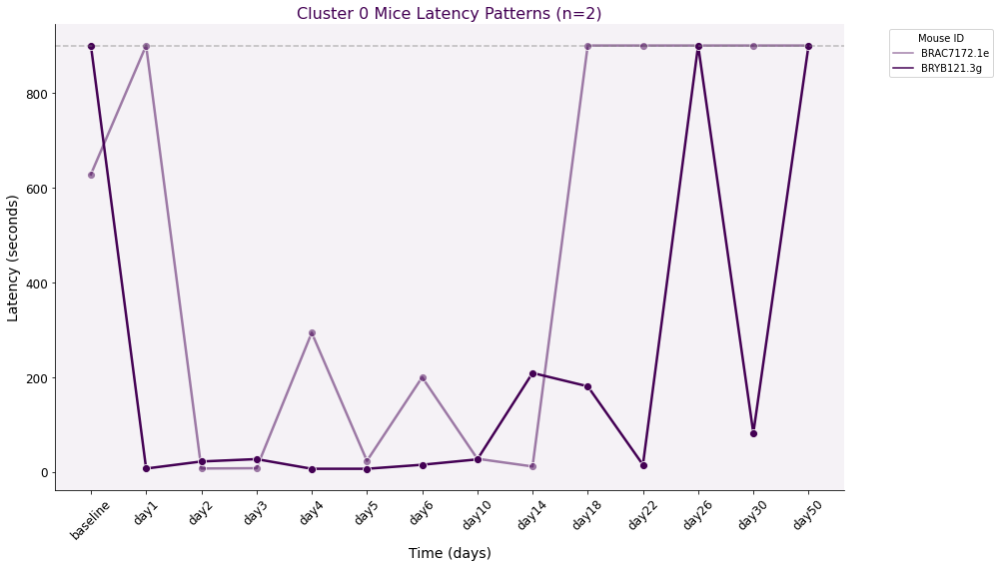

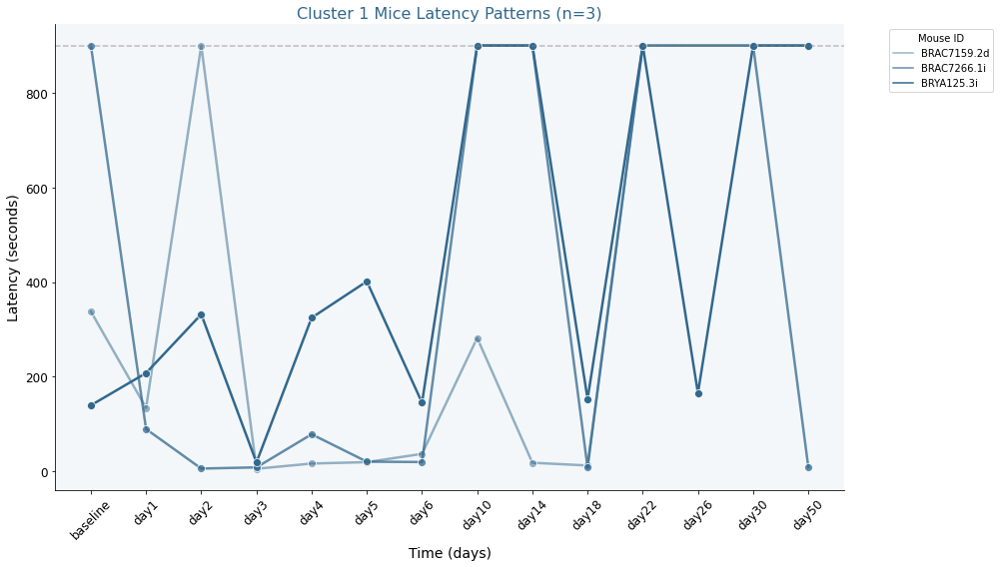

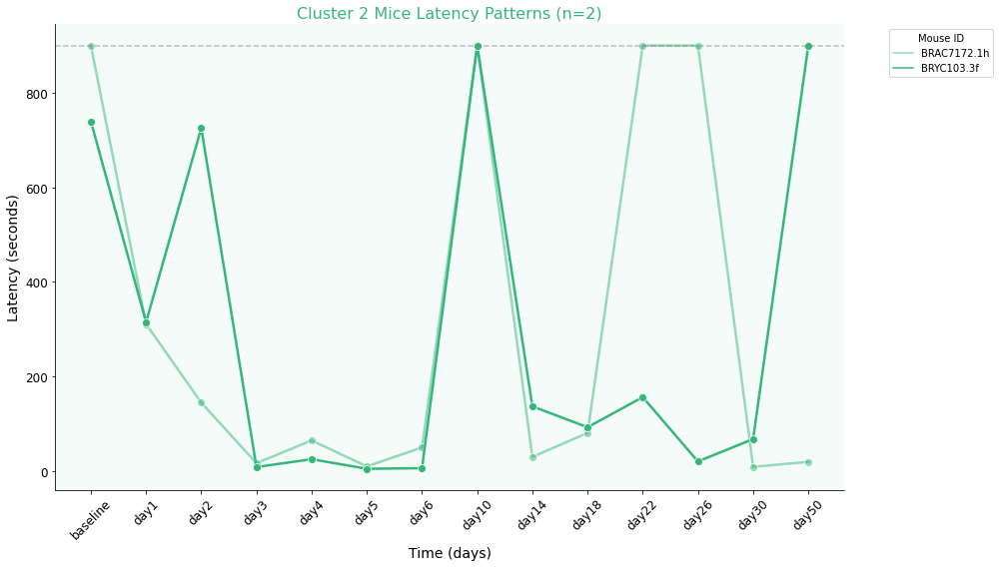

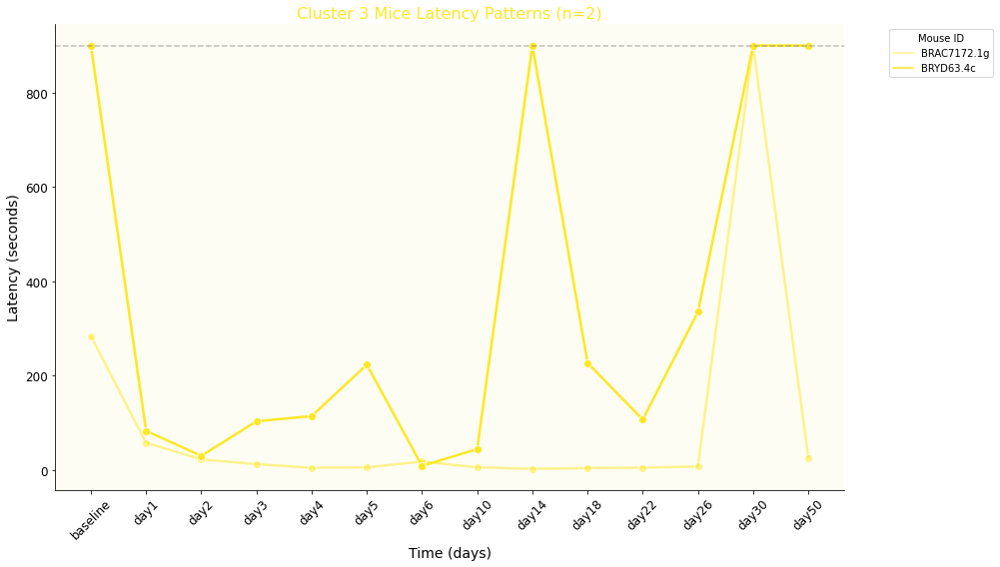

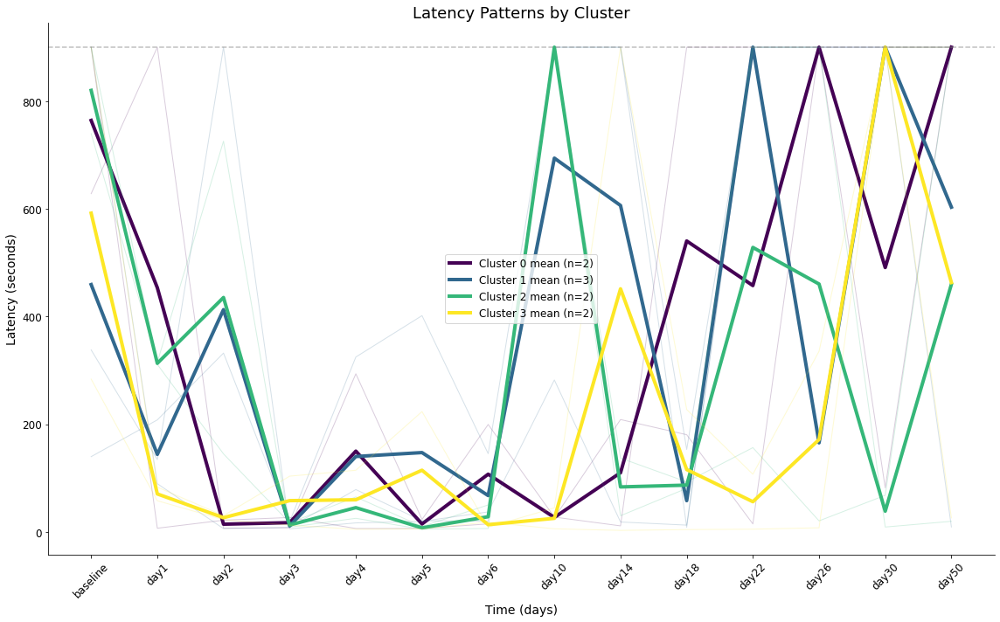

In [22]:
# Visualise the individual latency patterns for each cluster
# Create a DataFrame with cluster assignments
cluster_df = pd.DataFrame({
    'Mouse_ID': pivot_df.columns,
    'Cluster': cluster_labels
})

# Get the IDs for each cluster
cluster_ids = {}
for cluster in range(optimal_k):
    cluster_ids[cluster] = cluster_df[cluster_df['Cluster'] == cluster]['Mouse_ID'].tolist()
    print(f"Cluster {cluster} mice: {cluster_ids[cluster]}")

# Get the colors from viridis palette to match the PCA plot
cluster_colors = plt.cm.viridis(np.linspace(0, 1, optimal_k))

# Create separate plots for each cluster
for cluster in range(optimal_k):
    plt.figure(figsize=(14, 8))
    
    # Get data for this cluster
    subset = retrieval_data[retrieval_data['ID'].isin(cluster_ids[cluster])]
    
    # Get the color for this cluster from the viridis palette
    cluster_color = cluster_colors[cluster]
    
    # Create a custom palette for this plot based on the cluster color
    # (using slight variations of the cluster color for each mouse)
    n_mice = len(cluster_ids[cluster])
    custom_palette = {}
    
    for i, mouse_id in enumerate(cluster_ids[cluster]):
        # Create variations of the cluster color with different alpha values
        alpha = 0.5 + (0.5 * i / max(1, n_mice-1))  # Scale between 0.5 and 1.0
        custom_palette[mouse_id] = (*cluster_color[:3], alpha)
    
    # Plot each mouse's latency trajectory
    sns.lineplot(
        data=subset, 
        x='time', 
        y='latency', 
        hue='ID', 
        palette=custom_palette,
        linewidth=2.5, 
        marker='o', 
        markersize=8
    )
    
    plt.title(f'Cluster {cluster} Mice Latency Patterns (n={len(cluster_ids[cluster])})', 
              fontsize=16, 
              color=cluster_color)
    plt.xlabel('Time (days)', fontsize=14)
    plt.ylabel('Latency (seconds)', fontsize=14)
    plt.xticks(rotation=45, fontsize=12)
    plt.yticks(fontsize=12)
    plt.legend(title='Mouse ID', bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Add a background color hint matching the cluster color
    plt.gca().set_facecolor((*cluster_color[:3], 0.05))
    
    # Add horizontal line at 900 seconds to indicate censored data
    plt.axhline(y=900, color='gray', linestyle='--', alpha=0.5, 
                label='No retrieval observed')
    
    sns.despine()
    plt.tight_layout()
    plt.show()

# Create a combined plot with all clusters (optional)
plt.figure(figsize=(16, 10))

for cluster in range(optimal_k):
    subset = retrieval_data[retrieval_data['ID'].isin(cluster_ids[cluster])]
    
    # Calculate mean latency for each timepoint for this cluster
    mean_latencies = subset.groupby('time')['latency'].mean().reset_index()
    
    # Plot the mean latency line for this cluster
    plt.plot(
        mean_latencies['time'], 
        mean_latencies['latency'], 
        color=cluster_colors[cluster], 
        linewidth=4,
        label=f'Cluster {cluster} mean (n={len(cluster_ids[cluster])})'
    )
    
    # Plot individual mice with lighter colors
    for mouse_id in cluster_ids[cluster]:
        mouse_data = subset[subset['ID'] == mouse_id]
        plt.plot(
            mouse_data['time'], 
            mouse_data['latency'], 
            color=cluster_colors[cluster],
            alpha=0.2,
            linewidth=1,
            linestyle='-'
        )

plt.title('Latency Patterns by Cluster', fontsize=18)
plt.xlabel('Time (days)', fontsize=14)
plt.ylabel('Latency (seconds)', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.legend(fontsize=12)
plt.axhline(y=900, color='gray', linestyle='--', alpha=0.5, 
            label='No retrieval observed')
sns.despine()
plt.tight_layout()
plt.show()

Cluster 0 mice: ['BRAC7172.1e', 'BRYB121.3g']
Cluster 1 mice: ['BRAC7159.2d', 'BRAC7266.1i', 'BRYA125.3i']
Cluster 2 mice: ['BRAC7172.1h', 'BRYC103.3f']
Cluster 3 mice: ['BRAC7172.1g', 'BRYD63.4c']


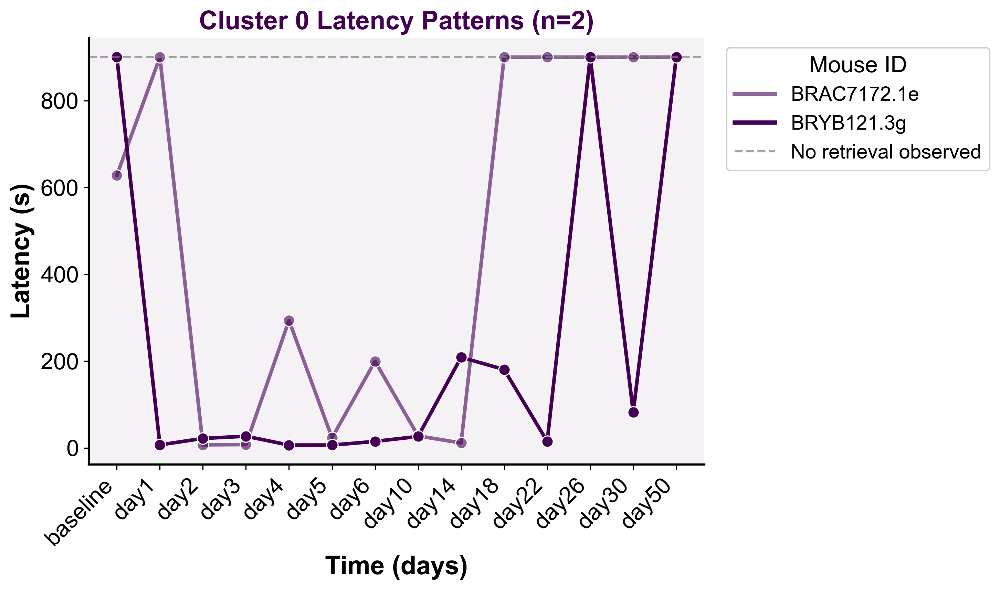

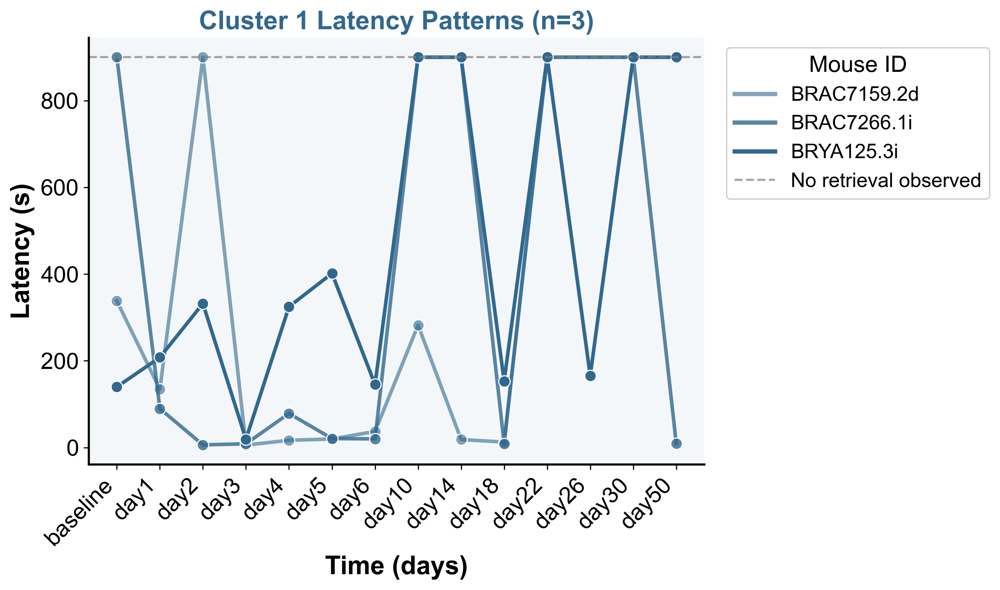

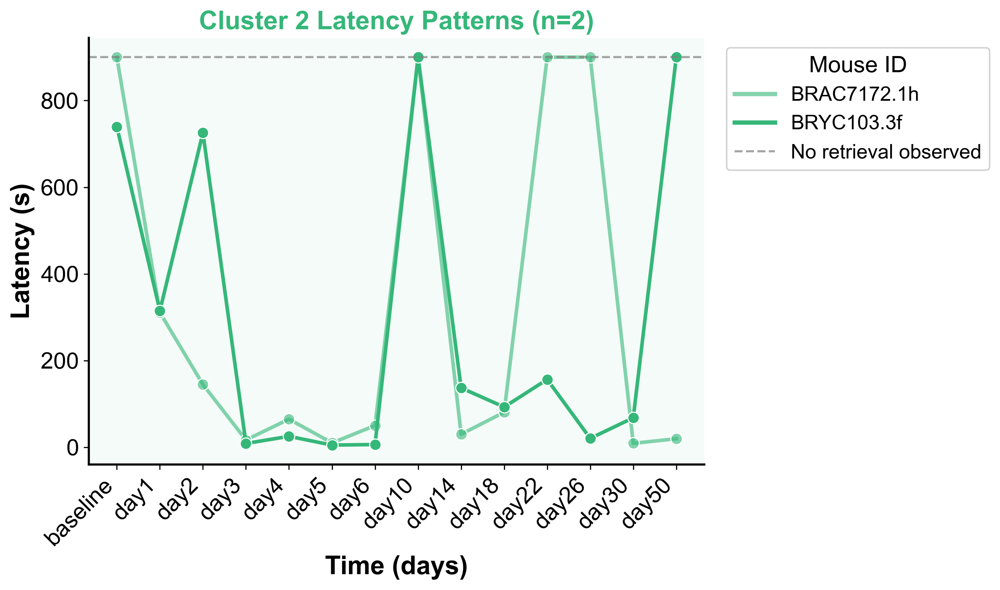

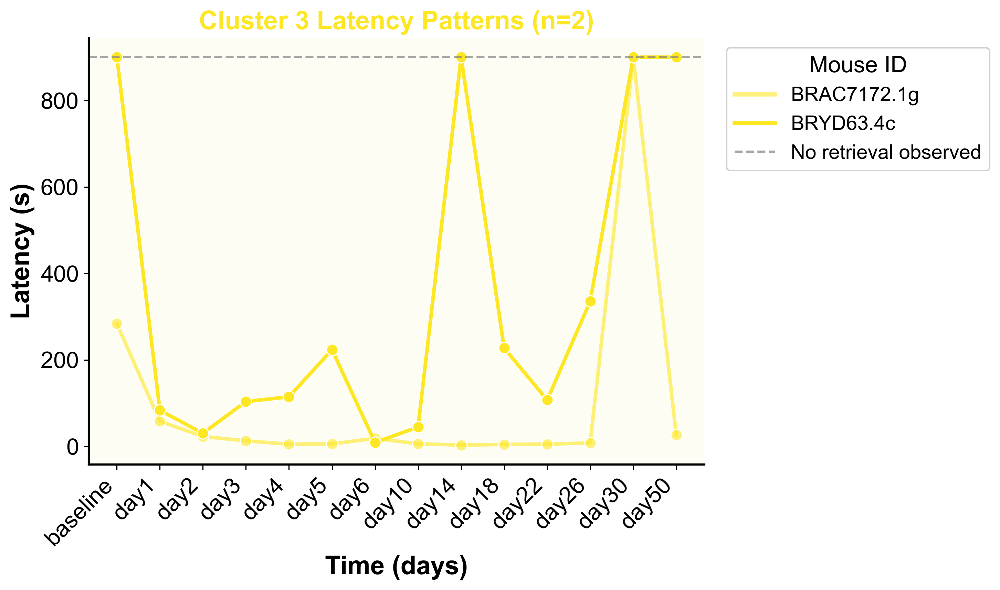

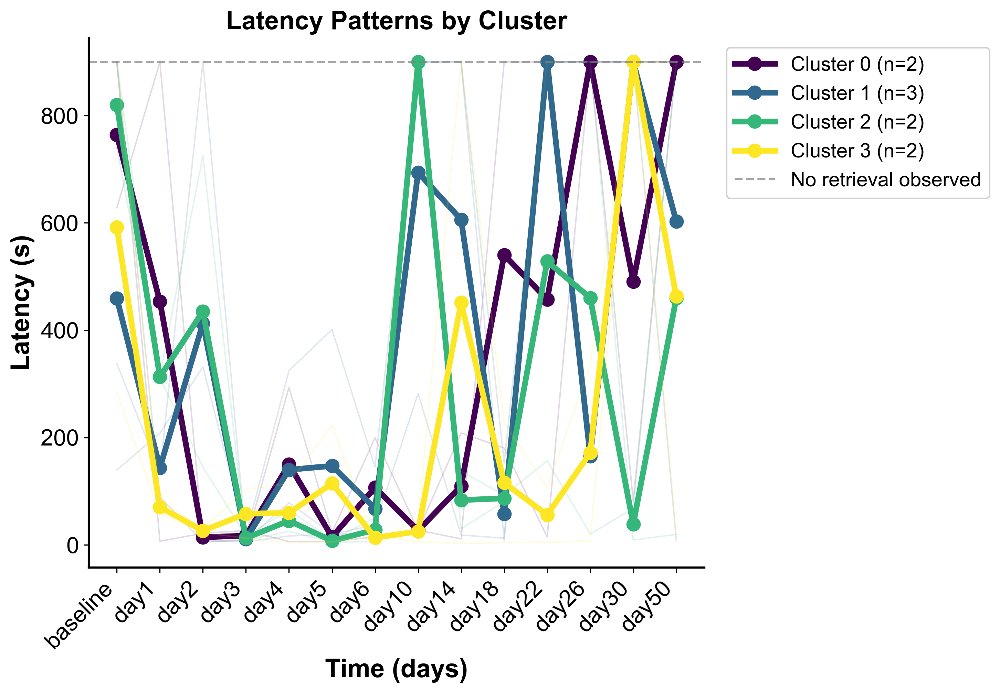

In [37]:
# Visualize the individual latency patterns for each cluster with publication-quality styling
# Create a DataFrame with cluster assignments
cluster_df = pd.DataFrame({
    'Mouse_ID': pivot_df.columns,
    'Cluster': cluster_labels
})

# Set publication-ready styling
plt.rcParams.update({
    'font.family': 'Arial',
    'font.size': 16,          # Larger base font size
    'axes.titlesize': 18,     # Larger title font size
    'axes.labelsize': 18,     # Larger axes labels font size
    'xtick.labelsize': 16,    # Larger tick labels size
    'ytick.labelsize': 16,
    'legend.fontsize': 14,    # Slightly smaller legend for compactness
    'figure.titlesize': 20,   # Large figure title size
    'figure.dpi': 300,
    'axes.linewidth': 1.5,    # Thicker axis lines for visibility
    'lines.linewidth': 3,     # Thicker lines for better visibility
    'lines.markersize': 8     # Good sized markers
})

# Get the IDs for each cluster
cluster_ids = {}
for cluster in range(optimal_k):
    cluster_ids[cluster] = cluster_df[cluster_df['Cluster'] == cluster]['Mouse_ID'].tolist()
    print(f"Cluster {cluster} mice: {cluster_ids[cluster]}")

# Get the colors from viridis palette to match the PCA plot
cluster_colors = plt.cm.viridis(np.linspace(0, 1, optimal_k))

# Create separate plots for each cluster - more compact but with larger fonts
for cluster in range(optimal_k):
    plt.figure(figsize=(10, 6))  # More compact figure size
    
    # Get data for this cluster
    subset = retrieval_data[retrieval_data['ID'].isin(cluster_ids[cluster])]
    
    # Get the color for this cluster from the viridis palette
    cluster_color = cluster_colors[cluster]
    
    # Create a custom palette for this plot based on the cluster color
    n_mice = len(cluster_ids[cluster])
    custom_palette = {}
    
    for i, mouse_id in enumerate(cluster_ids[cluster]):
        # Create variations of the cluster color with different alpha values
        alpha = 0.6 + (0.4 * i / max(1, n_mice-1))  # Scale between 0.6 and 1.0 for better visibility
        custom_palette[mouse_id] = (*cluster_color[:3], alpha)
    
    # Plot each mouse's latency trajectory
    sns.lineplot(
        data=subset, 
        x='time', 
        y='latency', 
        hue='ID', 
        palette=custom_palette,
        linewidth=2.5, 
        marker='o', 
        markersize=8
    )
    
    plt.title(f'Cluster {cluster} Latency Patterns (n={len(cluster_ids[cluster])})', 
              fontweight='bold',
              color=cluster_color)
    plt.xlabel('Time (days)', fontweight='bold')
    plt.ylabel('Latency (s)', fontweight='bold')
    plt.xticks(rotation=45, ha='right')
    
    # Add a background color hint matching the cluster color - very subtle
    plt.gca().set_facecolor((*cluster_color[:3], 0.05))
    
    # Add horizontal line at 900 seconds to indicate censored data
    plt.axhline(y=900, color='gray', linestyle='--', alpha=0.7, linewidth=1.5,
                label='No retrieval observed')
    
    # Format the legend to be more compact but still readable
    legend = plt.legend(title='Mouse ID', bbox_to_anchor=(1.02, 1), loc='upper left', frameon=True, 
               title_fontsize=16, framealpha=0.9)
    legend.get_frame().set_linewidth(1.0)
    
    sns.despine()
    plt.tight_layout()
    plt.savefig(f'plots/cluster{cluster}_latency_patterns.pdf', bbox_inches='tight')
    plt.savefig(f'plots/cluster{cluster}_latency_patterns.png', dpi=600, bbox_inches='tight')
    plt.show()

# Create a more compact combined plot with all clusters
plt.figure(figsize=(10, 7))  # More compact size for publication

for cluster in range(optimal_k):
    subset = retrieval_data[retrieval_data['ID'].isin(cluster_ids[cluster])]
    
    # Calculate mean latency for each timepoint for this cluster
    mean_latencies = subset.groupby('time')['latency'].mean().reset_index()
    
    # Plot the mean latency line for this cluster - make it prominent
    plt.plot(
        mean_latencies['time'], 
        mean_latencies['latency'], 
        color=cluster_colors[cluster], 
        linewidth=4,
        marker='o',
        markersize=9,
        label=f'Cluster {cluster} (n={len(cluster_ids[cluster])})'
    )
    
    # Plot individual mice with lighter colors - subtle background
    for mouse_id in cluster_ids[cluster]:
        mouse_data = subset[subset['ID'] == mouse_id]
        plt.plot(
            mouse_data['time'], 
            mouse_data['latency'], 
            color=cluster_colors[cluster],
            alpha=0.15,  # Very transparent
            linewidth=1,
            linestyle='-'
        )

plt.title('Latency Patterns by Cluster', fontweight='bold')
plt.xlabel('Time (days)', fontweight='bold')
plt.ylabel('Latency (s)', fontweight='bold')
plt.xticks(rotation=45, ha='right')

# Add horizontal line for no retrieval threshold
plt.axhline(y=900, color='gray', linestyle='--', alpha=0.7, linewidth=1.5,
            label='No retrieval observed')

# Create a more prominent legend with better formatting
legend = plt.legend(frameon=True, bbox_to_anchor=(1.02, 1), loc='upper left', framealpha=0.9)
legend.get_frame().set_linewidth(1.0)

sns.despine()
plt.tight_layout()
plt.savefig('plots/combined_cluster_patterns.pdf', bbox_inches='tight')
plt.savefig('plots/combined_cluster_patterns.png', dpi=600, bbox_inches='tight')
plt.show()

Cluster 0 mice: ['BRAC7159.2d', 'BRAC7172.1h', 'BRAC7266.1i', 'BRYA125.3i', 'BRYC103.3f']
Cluster 1 mice: ['BRAC7172.1e', 'BRAC7172.1g', 'BRYB121.3g', 'BRYD63.4c']


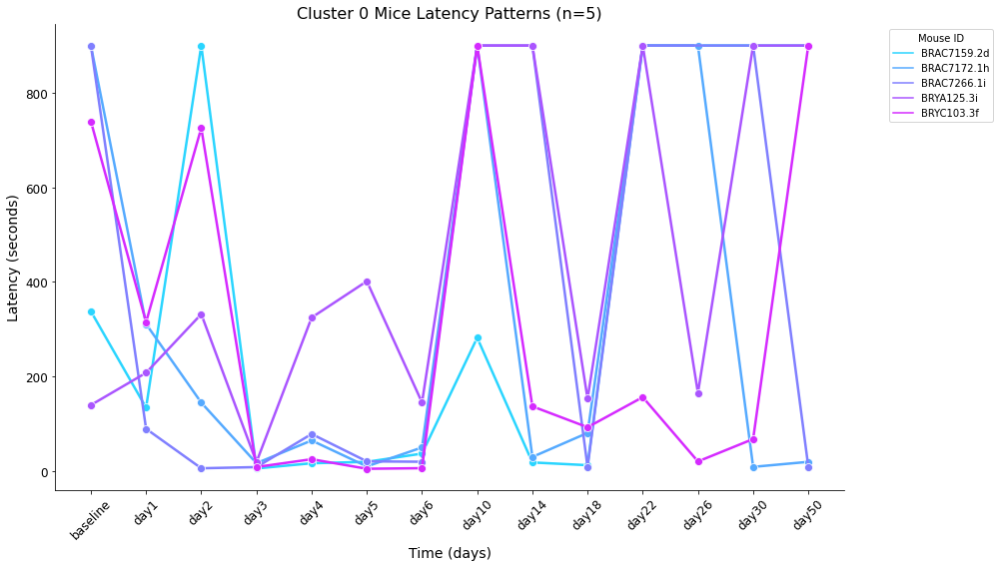

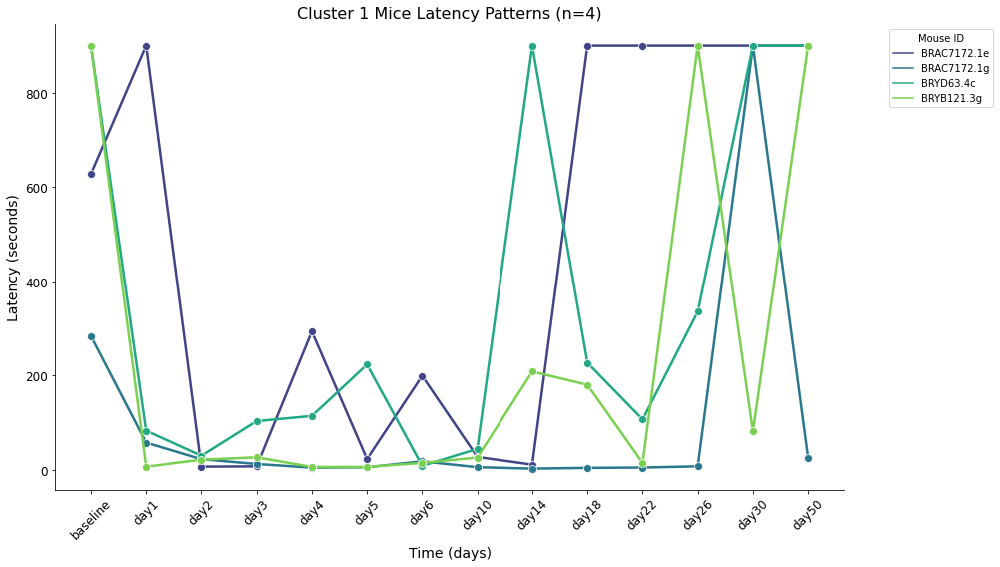

In [19]:
# Get the IDs for each cluster
cluster0_ids = cluster_df[cluster_df['Cluster'] == 0]['Mouse_ID'].tolist()
cluster1_ids = cluster_df[cluster_df['Cluster'] == 1]['Mouse_ID'].tolist()

print("Cluster 0 mice:", cluster0_ids)
print("Cluster 1 mice:", cluster1_ids)

# Create separate plots for each cluster
# Cluster 0
plt.figure(figsize=(14, 8))
subset = retrieval_data[retrieval_data['ID'].isin(cluster0_ids)]

# Plot each mouse's latency trajectory
sns.lineplot(data=subset, x='time', y='latency', hue='ID', palette='cool', 
             linewidth=2.5, marker='o', markersize=8)

plt.title(f'Cluster 0 Mice Latency Patterns (n={len(cluster0_ids)})', fontsize=16)
plt.xlabel('Time (days)', fontsize=14)
plt.ylabel('Latency (seconds)', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Mouse ID', bbox_to_anchor=(1.05, 1), loc='upper left')
sns.despine()
plt.tight_layout()
plt.show()

# Cluster 1
plt.figure(figsize=(14, 8))
subset = retrieval_data[retrieval_data['ID'].isin(cluster1_ids)]

# Plot each mouse's latency trajectory
sns.lineplot(data=subset, x='time', y='latency', hue='ID', palette='viridis', 
             linewidth=2.5, marker='o', markersize=8)

plt.title(f'Cluster 1 Mice Latency Patterns (n={len(cluster1_ids)})', fontsize=16)
plt.xlabel('Time (days)', fontsize=14)
plt.ylabel('Latency (seconds)', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Mouse ID', bbox_to_anchor=(1.05, 1), loc='upper left')
sns.despine()
plt.tight_layout()
plt.show()

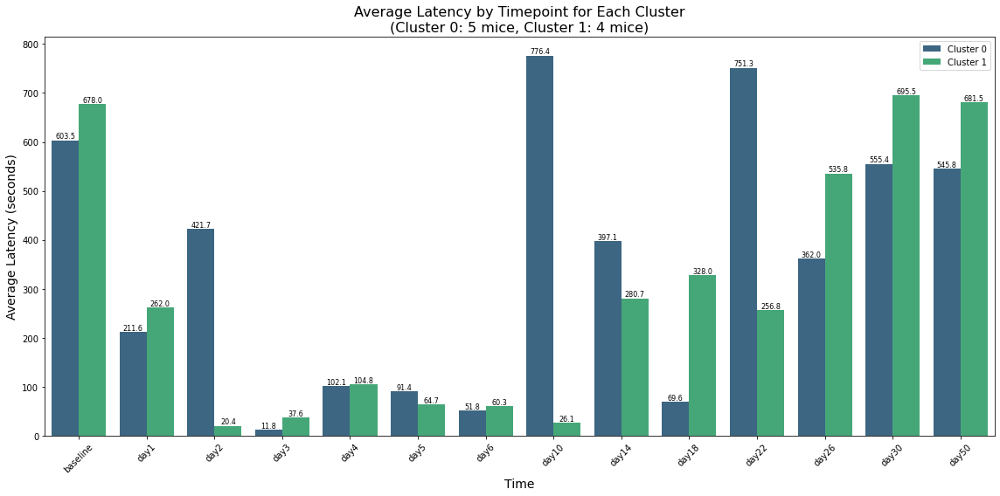

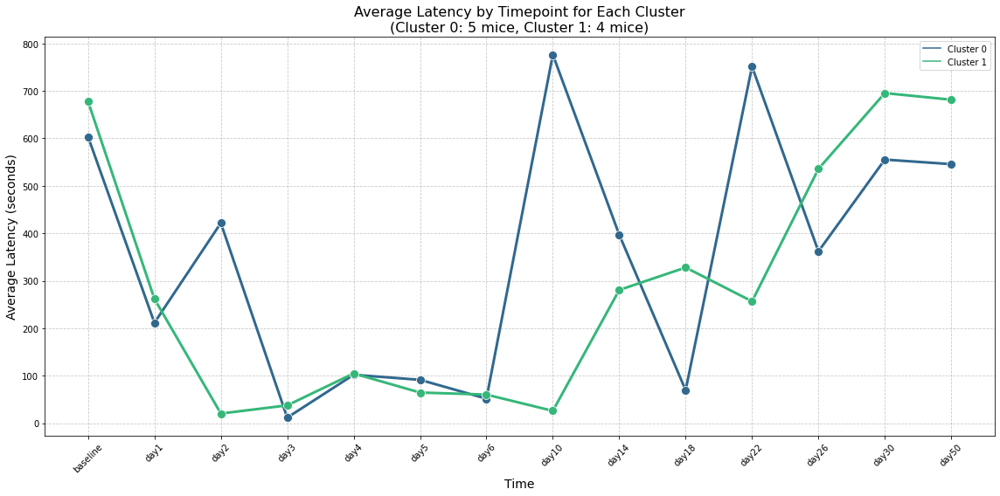

In [18]:
# Create a DataFrame with cluster assignments
cluster_df = pd.DataFrame({
    'Mouse_ID': pivot_df.columns,
    'Cluster': cluster_labels
})

# Get the average latency for each timepoint for each cluster
cluster_latencies = []

# For each timepoint
for i, time in enumerate(pivot_df.index):
    # For each cluster
    for cluster in range(k):
        # Get mouse IDs in this cluster
        cluster_mice = cluster_df[cluster_df['Cluster'] == cluster]['Mouse_ID'].tolist()
        
        # Calculate average latency for this timepoint for this cluster
        avg_latency = np.nanmean([latency_matrix[i, j] 
                              for j, mouse in enumerate(pivot_df.columns) 
                              if mouse in cluster_mice])
        
        cluster_latencies.append({
            'Time': time,
            'Cluster': f'Cluster {cluster}',
            'Avg_Latency': avg_latency
        })

# Convert to DataFrame
cluster_latency_df = pd.DataFrame(cluster_latencies)

# Plot bar chart comparing clusters
plt.figure(figsize=(16, 8))
g = sns.barplot(x='Time', y='Avg_Latency', hue='Cluster', data=cluster_latency_df, palette='viridis')

# Count mice in each cluster for the title
cluster_counts = cluster_df['Cluster'].value_counts().sort_index()
mice_counts = [f"Cluster {i}: {count} mice" for i, count in enumerate(cluster_counts)]
cluster_info = ", ".join(mice_counts)

# Customize the plot
plt.title(f'Average Latency by Timepoint for Each Cluster\n({cluster_info})', fontsize=16)
plt.xlabel('Time', fontsize=14)
plt.ylabel('Average Latency (seconds)', fontsize=14)
plt.xticks(rotation=45)
plt.legend(title='')

# Add value labels on top of bars
for container in g.containers:
    g.bar_label(container, fmt='%.1f', fontsize=8)

plt.tight_layout()
plt.show()

# Also create a line plot which might show the trends more clearly
plt.figure(figsize=(16, 8))
sns.lineplot(x='Time', y='Avg_Latency', hue='Cluster', 
             data=cluster_latency_df, palette='viridis', 
             marker='o', markersize=10, linewidth=3)

plt.title(f'Average Latency by Timepoint for Each Cluster\n({cluster_info})', fontsize=16)
plt.xlabel('Time', fontsize=14)
plt.ylabel('Average Latency (seconds)', fontsize=14)
plt.xticks(rotation=45)
plt.legend(title='')
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [5]:
# get percentage of animals that performed each behaviour at each time point
percentages = pd.DataFrame(columns = ["time", "behaviour", "percentage"])

for time in times:
    for behaviour in behaviours.behaviour.unique():
        per_df = behaviours[(behaviours.behaviour == behaviour) & (behaviours.time == time)]
        num = per_df[per_df.duration == 0].shape[0] #animals that did not perform the behaviour
        percent = (per_df.shape[0] - num) / per_df.shape[0]
        
        percentage = {}
        percentage['time'] = time
        percentage['behaviour'] = behaviour
        percentage['percentage'] = percent
        
        percentage = pd.DataFrame(percentage, index = [0])
            
        percentages = pd.concat([percentages, percentage])

In [6]:
from scipy.stats import chi2
from statsmodels.stats.multitest import multipletests

In [8]:
# Manual implementation of mcnemar's test with fdr correction for multiple comparisons
# Modified to only compare baseline vs other timepoints

# Filter data for only "retrieval to nest" behavior
retrieval_data = behaviours[behaviours['behaviour'] == 'retrieval to nest']

def mcnemar_test_manual(day1, day2, data):
    """Manually implement McNemar's test without using scipy.stats.mcnemar"""
    # Get the IDs of all mice in the dataset
    all_mice = data['ID'].unique()
    
    # Initialize the 2x2 contingency table counts
    a = 0  # Both days retrieved
    b = 0  # day1 retrieved, day2 not retrieved 
    c = 0  # day1 not retrieved, day2 retrieved
    d = 0  # Neither day retrieved
    
    for mouse in all_mice:
        # Get this mouse's retrieval data for both days
        day1_data = data[(data['ID'] == mouse) & (data['time'] == day1)]
        day2_data = data[(data['ID'] == mouse) & (data['time'] == day2)]
        
        # Skip if we don't have data for both days
        if len(day1_data) == 0 or len(day2_data) == 0:
            continue
        
        # Determine if retrieval occurred (duration > 0 means retrieval happened)
        day1_retrieved = day1_data['duration'].values[0] > 0
        day2_retrieved = day2_data['duration'].values[0] > 0
        
        # Update the contingency table
        if day1_retrieved and day2_retrieved:
            a += 1
        elif day1_retrieved and not day2_retrieved:
            b += 1
        elif not day1_retrieved and day2_retrieved:
            c += 1
        else:
            d += 1
    
    # Calculate McNemar's test statistic with continuity correction
    if b + c == 0:
        statistic = 0
        p_value = 1.0
    else:
        # With continuity correction for better approximation
        numerator = abs(b - c) - 1
        if numerator < 0:
            numerator = 0
        statistic = (numerator ** 2) / (b + c)
        
        # Calculate p-value using chi-square with df=1
        p_value = chi2.sf(statistic, df=1)
    
    return {
        'day1': day1, 
        'day2': day2,
        'a': a, 'b': b, 'c': c, 'd': d,
        'n_total': a + b + c + d,
        'statistic': statistic,
        'p_value': p_value
    }

# Run McNemar test for baseline vs. each other day only
baseline = 'baseline'
results = []
for day in times:
    if day != baseline:  # Skip comparison of baseline with itself
        result = mcnemar_test_manual(baseline, day, retrieval_data)
        results.append(result)

# Convert results to DataFrame
results_df = pd.DataFrame(results)

# Apply FDR correction to p-values
_, corrected_p_values, _, _ = multipletests(results_df['p_value'], method='fdr_bh')
results_df['corrected_p_value'] = corrected_p_values

# Create a summary table and format for display
summary_df = results_df[['day1', 'day2', 'a', 'b', 'c', 'd', 'n_total', 'p_value', 'corrected_p_value']]
summary_df = summary_df.sort_values('day2')  # Sort by the second day for easier reading

# Format p-values and add significance indicators
summary_df['p_value'] = summary_df['p_value'].apply(lambda p: f"{p:.4f}")
summary_df['corrected_p_value'] = summary_df['corrected_p_value'].apply(lambda p: f"{p:.4f}")
summary_df['significance'] = summary_df['corrected_p_value'].apply(
    lambda p: 'ns' if float(p) > 0.05 else 
              ('*' if float(p) <= 0.05 and float(p) > 0.01 else 
               ('**' if float(p) <= 0.01 and float(p) > 0.001 else 
                ('***' if float(p) <= 0.001 and float(p) > 0.0001 else '****')))
)

# Display the summary table
print("\nMcNemar Test Results for 'retrieval to nest' (Baseline vs Other Days):")
print("="*100)
print(summary_df.to_string(index=False))
print("="*100)
print("a: Both days retrieved")
print("b: Baseline retrieved, compared day not retrieved")
print("c: Baseline not retrieved, compared day retrieved")
print("d: Neither day retrieved")
print("n_total: Total number of mice with data for both days")
print("Significance: ns = not significant, * p≤0.05, ** p≤0.01, *** p≤0.001, **** p≤0.0001")


McNemar Test Results for 'retrieval to nest' (Baseline vs Other Days):
    day1  day2  a  b  c  d  n_total p_value corrected_p_value significance
baseline  day1  5  1  4  0       10  0.3711            0.8040           ns
baseline day10  3  3  2  2       10  1.0000            1.0000           ns
baseline day14  4  2  2  2       10  1.0000            1.0000           ns
baseline day18  4  2  4  0       10  0.6831            0.9867           ns
baseline  day2  5  1  4  0       10  0.3711            0.8040           ns
baseline day22  2  3  2  2        9  1.0000            1.0000           ns
baseline day26  3  1  1  2        7  1.0000            1.0000           ns
baseline  day3  6  0  4  0       10  0.1336            0.4342           ns
baseline day30  1  4  2  2        9  0.6831            0.9867           ns
baseline  day4  6  0  4  0       10  0.1336            0.4342           ns
baseline  day5  6  0  4  0       10  0.1336            0.4342           ns
baseline day50  1  4  2  2  

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_74601/4059368498.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.latency = pd.to_numeric(behav_df.latency)


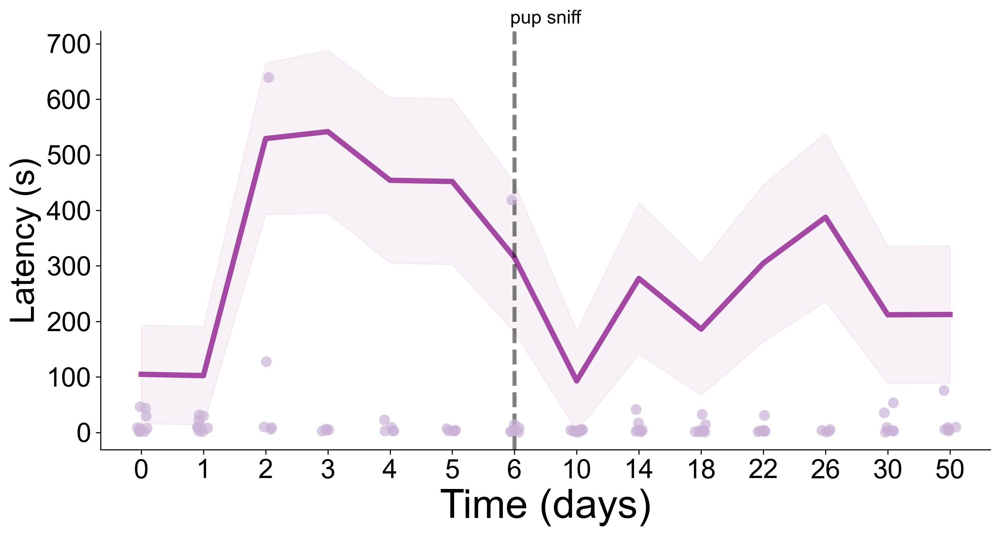

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_74601/4059368498.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.latency = pd.to_numeric(behav_df.latency)


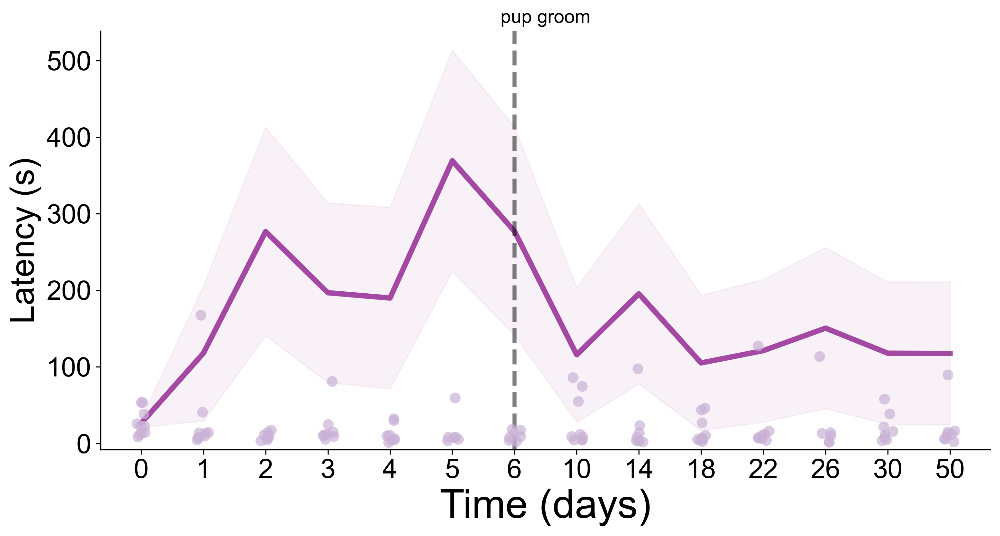

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_74601/4059368498.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.latency = pd.to_numeric(behav_df.latency)


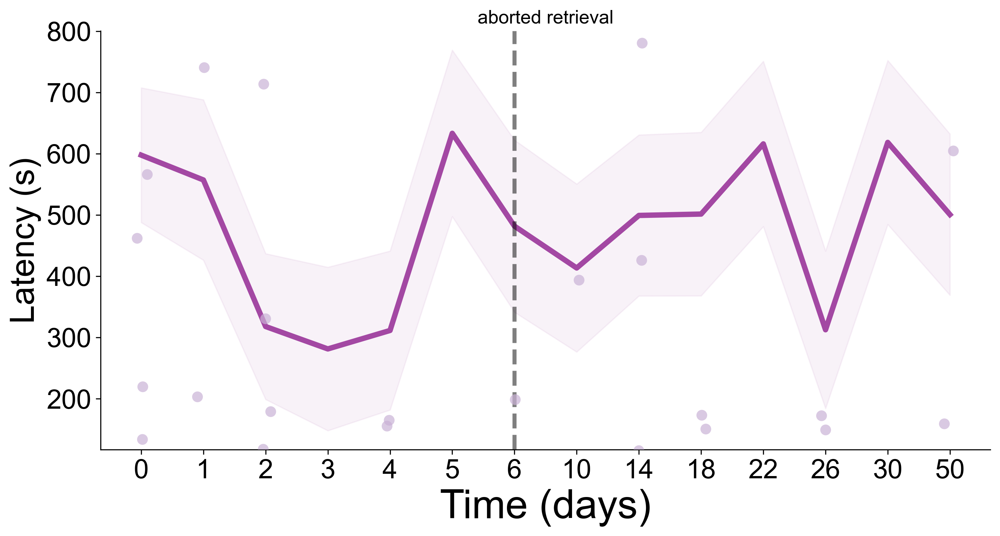

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_74601/4059368498.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.latency = pd.to_numeric(behav_df.latency)


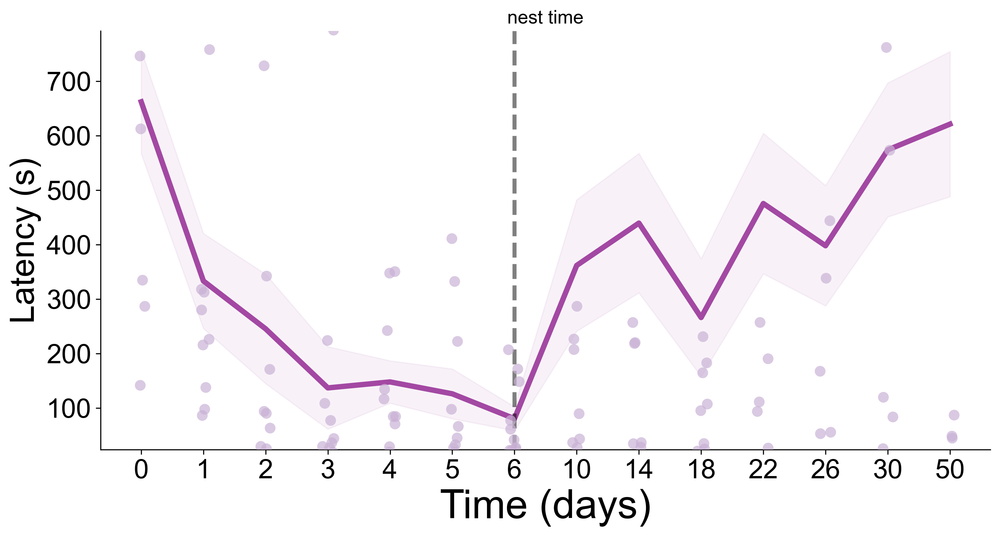

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_74601/4059368498.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.latency = pd.to_numeric(behav_df.latency)


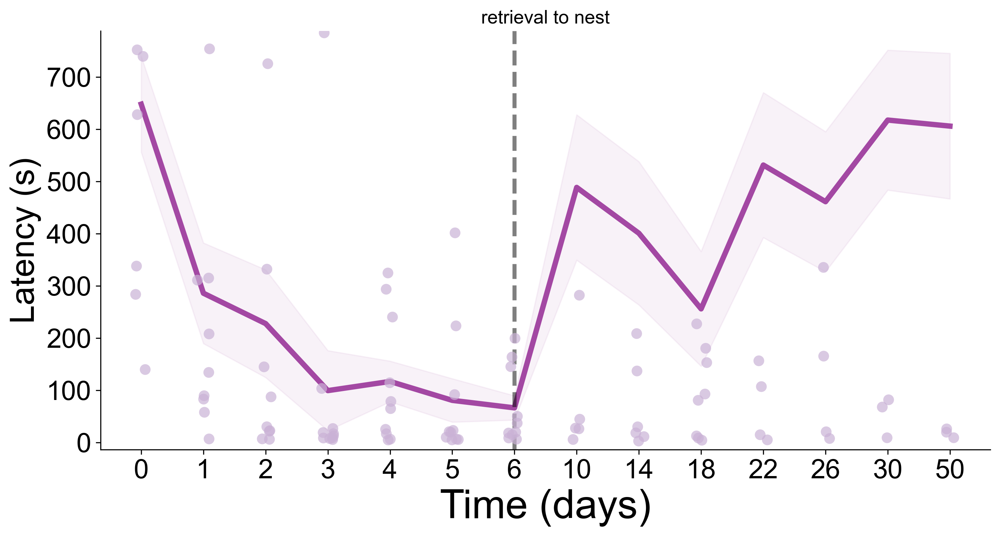

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_74601/4059368498.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.latency = pd.to_numeric(behav_df.latency)


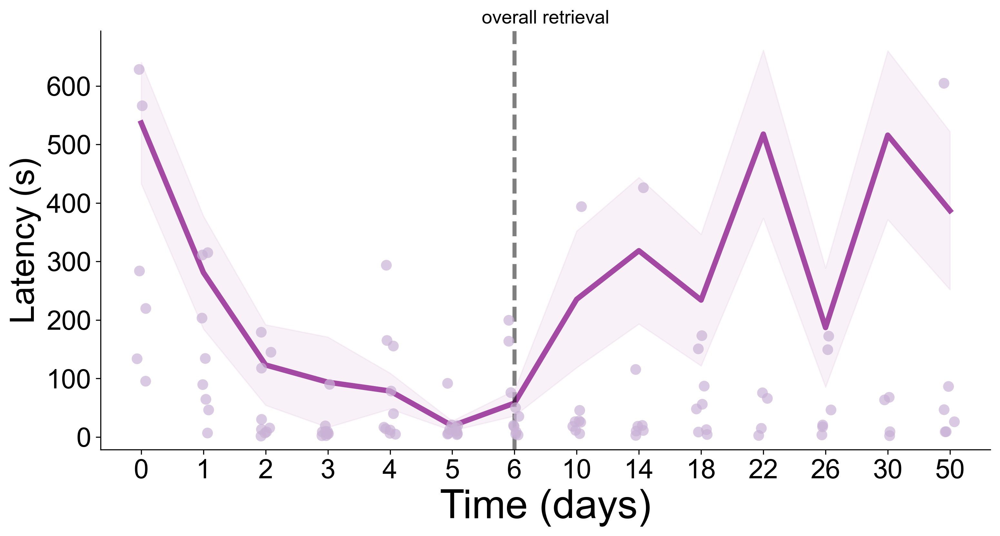

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_74601/4059368498.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.latency = pd.to_numeric(behav_df.latency)


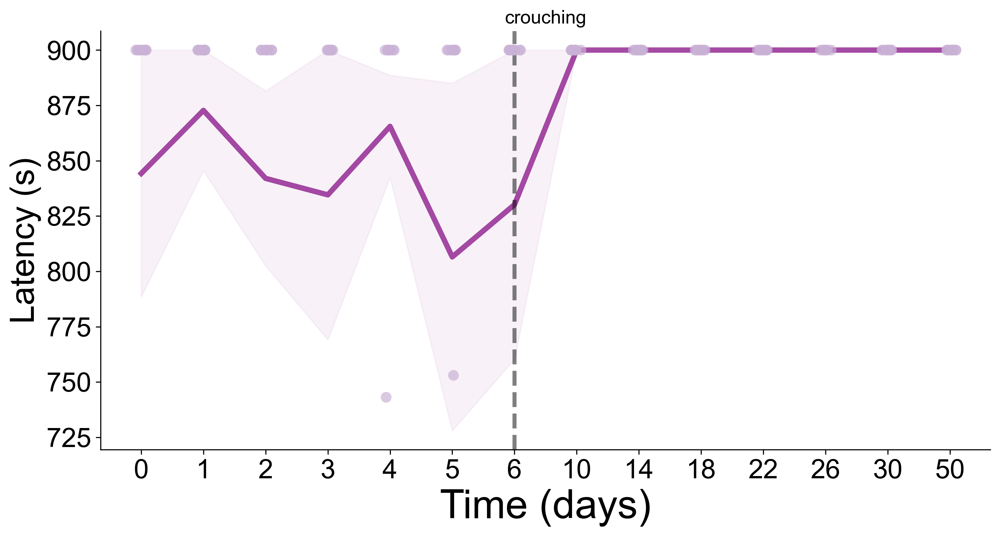

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_74601/4059368498.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.latency = pd.to_numeric(behav_df.latency)


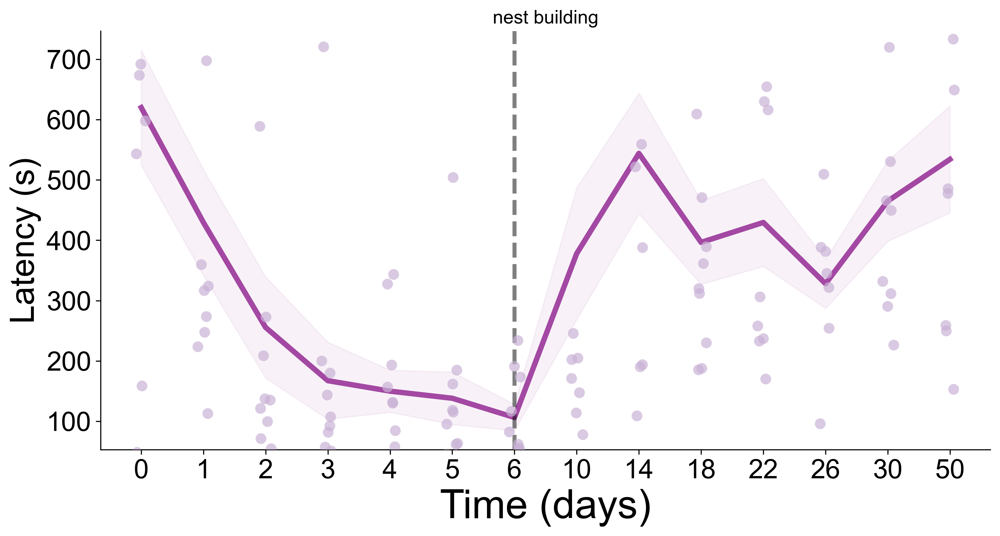

In [17]:
for behaviour in behaviours.behaviour.unique():
    behav_df = behaviours[behaviours.behaviour == behaviour]
    
    behav_df.latency = pd.to_numeric(behav_df.latency)
    mean = behav_df.groupby(by = 'time').mean().reset_index()
    st_error = behav_df.groupby(by = 'time').std()/np.sqrt(len(behav_df.ID.unique()))
    st_error = st_error.reset_index()
    
    # model = smf.ols('latency ~ C(time)', data = behav_df).fit()
    # print(sm.stats.anova_lm(model, typ = 2))
    
    # m_comp = pairwise_tukeyhsd(endog=behav_df.latency, groups = behav_df.time, alpha = 0.05)
    # print(m_comp._results_table)

    
    fig, ax = plt.subplots(figsize = [10, 5])
    fig.tight_layout()
    
    sns.stripplot(x="time", y="latency", data=behav_df, color='#cab2d6', alpha=0.7, size=8, ax=ax, jitter=True)
    plt.plot(mean.time, mean.latency, color = 'purple', alpha = 0.7, lw = 4)
    plt.fill_between(mean.time,  mean.latency + st_error.latency, mean.latency - st_error.latency, 
                     color = 'purple', alpha = 0.05)
    
    # ax.set_xlim(['baseline', 'day50'])
    # ax.set_ylim([0, 900])
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    
    plt.axvline(x = 'day6', color = 'black', linestyle = '--', alpha = 0.5, lw = 3)

    plt.xticks(fontsize = 20)
    plt.yticks(fontsize = 20)
    
    ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])

    plt.ylabel('Latency (s)', fontsize = 25)
    plt.xlabel('Time (days)', fontsize = 30)
    
    plt.title(behaviour)
    
    # plt.savefig(f'plots/{behaviour}_latency.jpg', dpi = 300, bbox_inches = 'tight')
    plt.show()

    
#     fig, ax = plt.subplots(figsize = [10, 5])
#     fig.tight_layout()
    
#     sns.pointplot(mean.time, mean.latency, color = 'purple', alpha = 0.7)
#     # plt.fill_between(mean.time,  mean.latency + st_error.latency, mean.latency - st_error.latency, 
#                      # color = 'purple', alpha = 0.05)
#     ax.spines['right'].set_visible(False)
#     ax.spines['top'].set_visible(False)
    
#     plt.xticks(fontsize = 12)
#     plt.yticks(fontsize = 12)
    
#     plt.ylabel('Latency (s)', fontsize = 14)
#     plt.title(behaviour)
#     plt.show()
    
    # plt.subplots(figsize = [5,3])
    # sns.stripplot(x = "time", y = "latency", data = behav_df, palette = ['Tab:purple'], alpha = 0.7, size = 7)
    # plt.title(behaviour)
    # sns.despine()
    # plt.savefig(f'plots_mesh/{behaviour}_latency.jpg', dpi = 300, bbox_inches = 'tight')
    # plt.show()
    


Analyzing behavior: pup sniff

Diagnostic for pup sniff - baseline vs day1:
Number of paired subjects: 10
First few baseline values: [43.55299999999988, 45.15200000000007, 7.550000000000001, 11.16799999999985, 17.97499999999996]
First few day1 values: [26.684000000000047, 16.424999999999958, 5.534000000000006, 6.532999999999991, 8.100000000000016]
All zeros in baseline: False
All zeros in day1: False
All pairs have identical values: False

Diagnostic for pup sniff - baseline vs day2:
Number of paired subjects: 10
First few baseline values: [43.55299999999988, 45.15200000000007, 7.550000000000001, 11.16799999999985, 17.97499999999996]
First few day2 values: [24.998999999999842, 10.848000000000035, 0.0, 4.732999999999993, 0.0]
All zeros in baseline: False
All zeros in day2: False
All pairs have identical values: False

Diagnostic for pup sniff - baseline vs day3:
Number of paired subjects: 10
First few baseline values: [43.55299999999988, 45.15200000000007, 7.550000000000001, 11.1679999

/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


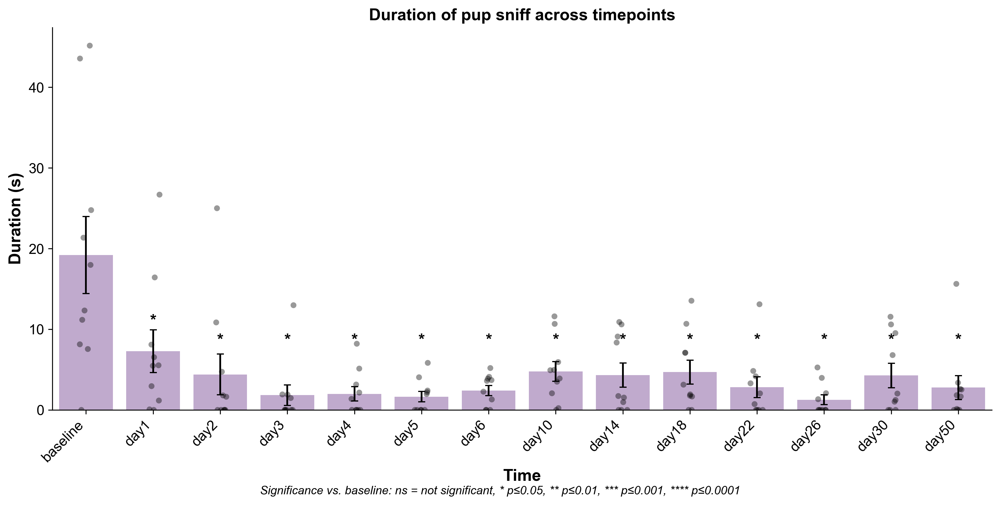

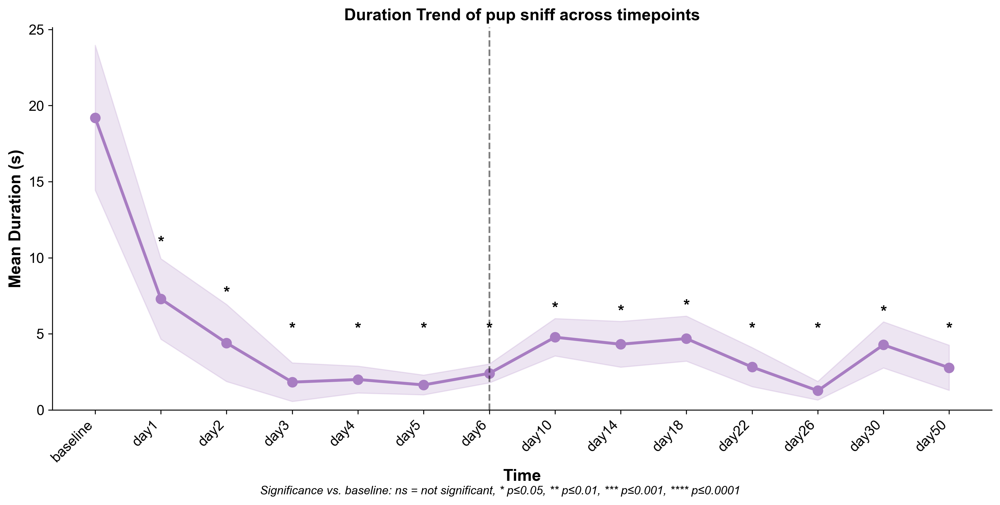


Analyzing behavior: pup groom

Diagnostic for pup groom - baseline vs day1:
Number of paired subjects: 10
First few baseline values: [306.817, 90.31899999999999, 83.54999999999998, 93.66700000000012, 102.57499999999985]
First few day1 values: [210.71199999999993, 148.31000000000034, 6.934000000000026, 43.46499999999992, 24.133000000000003]
All zeros in baseline: False
All zeros in day1: False
All pairs have identical values: False

Diagnostic for pup groom - baseline vs day2:
Number of paired subjects: 10
First few baseline values: [306.817, 90.31899999999999, 83.54999999999998, 93.66700000000012, 102.57499999999985]
First few day2 values: [271.65499999999986, 139.19400000000007, 0.0, 10.333000000000027, 0.0]
All zeros in baseline: False
All zeros in day2: False
All pairs have identical values: False

Diagnostic for pup groom - baseline vs day3:
Number of paired subjects: 10
First few baseline values: [306.817, 90.31899999999999, 83.54999999999998, 93.66700000000012, 102.5749999999998

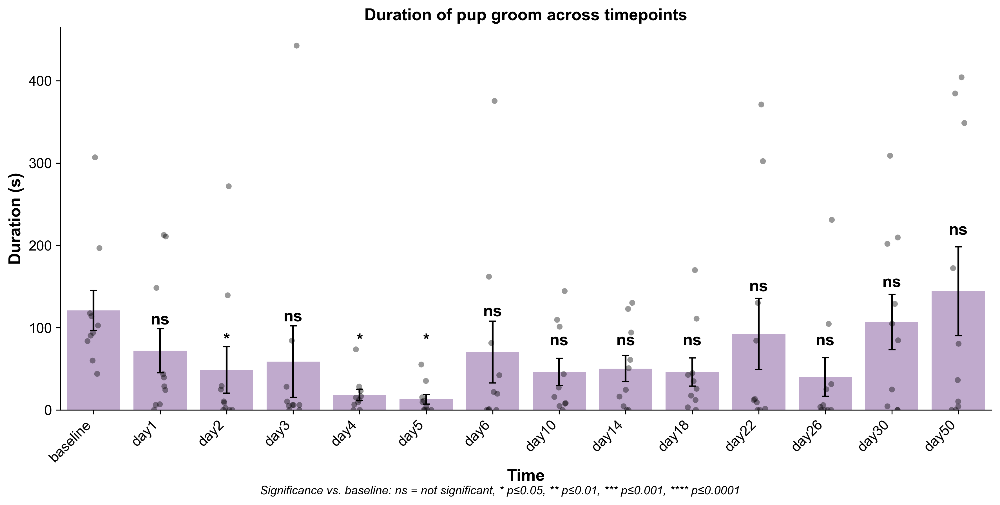

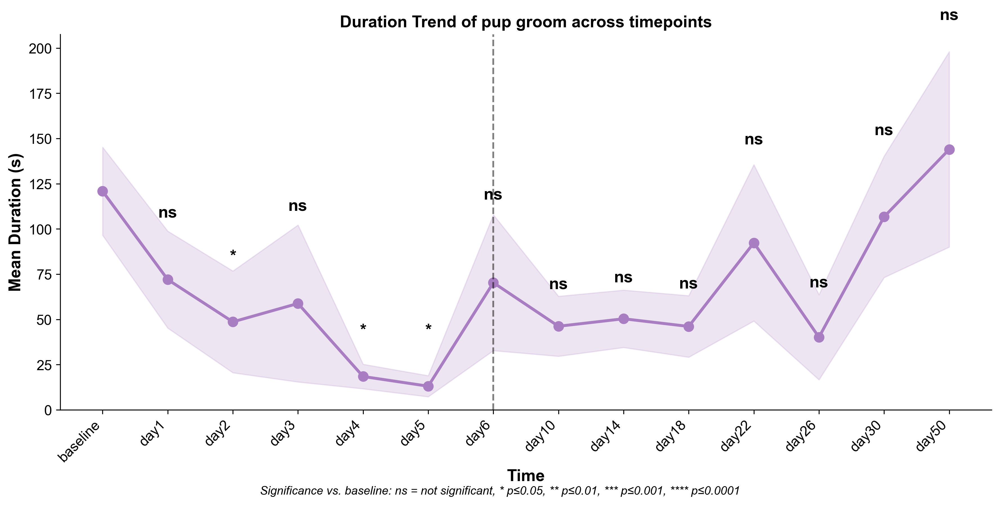


Analyzing behavior: aborted retrieval

Diagnostic for aborted retrieval - baseline vs day1:
Number of paired subjects: 10
First few baseline values: [2.4329999999999927, 0.0, 3.305000000000007, 0.0, 0.0]
First few day1 values: [0.0, 0.0, 1.8249999999999957, 0.0, 0.0]
All zeros in baseline: False
All zeros in day1: False
All pairs have identical values: False

Diagnostic for aborted retrieval - baseline vs day2:
Number of paired subjects: 10
First few baseline values: [2.4329999999999927, 0.0, 3.305000000000007, 0.0, 0.0]
First few day2 values: [1.1989999999999839, 3.3000000000000114, 10.444999999999993, 0.0, 3.847999999999999]
All zeros in baseline: False
All zeros in day2: False
All pairs have identical values: False

Diagnostic for aborted retrieval - baseline vs day3:
Number of paired subjects: 10
First few baseline values: [2.4329999999999927, 0.0, 3.305000000000007, 0.0, 0.0]
First few day3 values: [1.1000000000000014, 0.5739999999999981, 3.826999999999998, 7.851999999999993, 1.5

/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


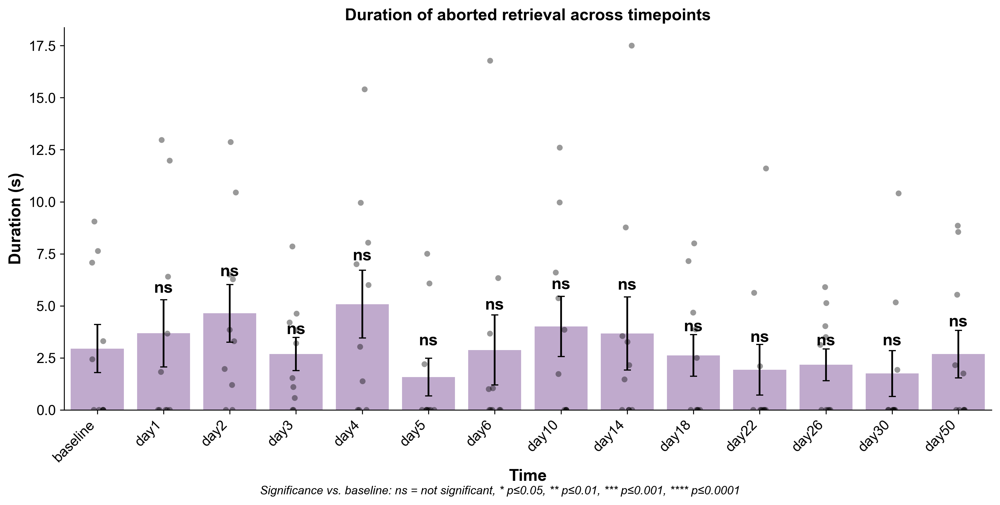

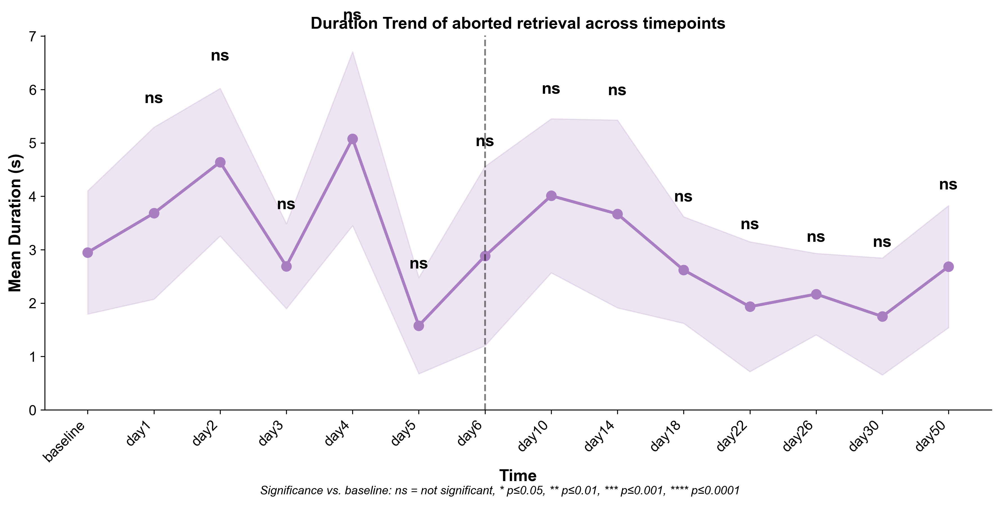


Analyzing behavior: nest time

SIGNIFICANCE SUMMARY FOR NEST TIME:
Timepoint Raw p-value Corrected p-value Significance  n pairs
     day1      0.1097            0.1783           ns       10
     day2      0.0488            0.1058           ns       10
     day3      0.0137            0.0679           ns       10
     day4      0.0273            0.0711           ns       10
     day5      0.0195            0.0679           ns       10
     day6      0.0137            0.0679           ns       10
    day10      0.0858            0.1594           ns       10
    day14      0.3270            0.3864           ns       10
    day18      0.0209            0.0679           ns       10
    day22      0.1282            0.1852           ns       10
    day26      0.1614            0.2099           ns       10
    day30      0.4008            0.4342           ns       10
    day50      0.4990            0.4990           ns       10


/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


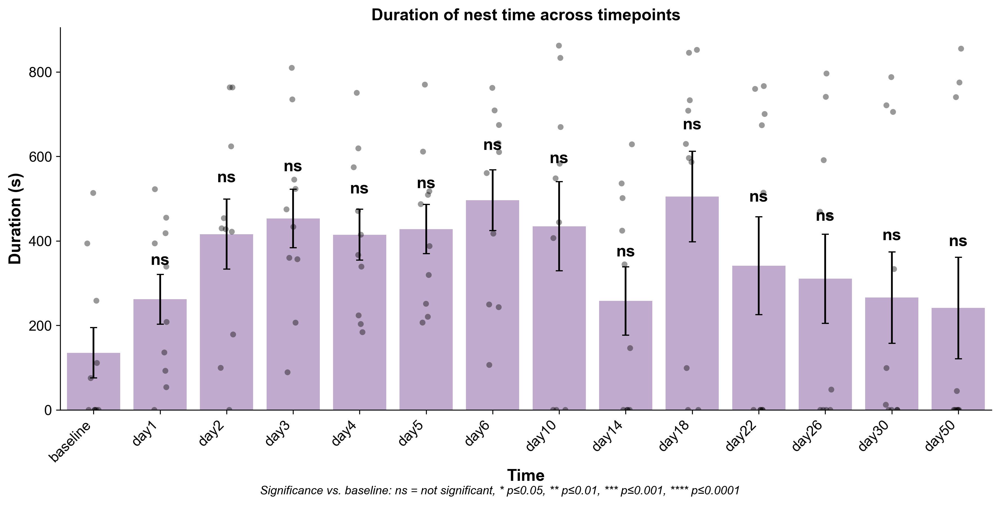

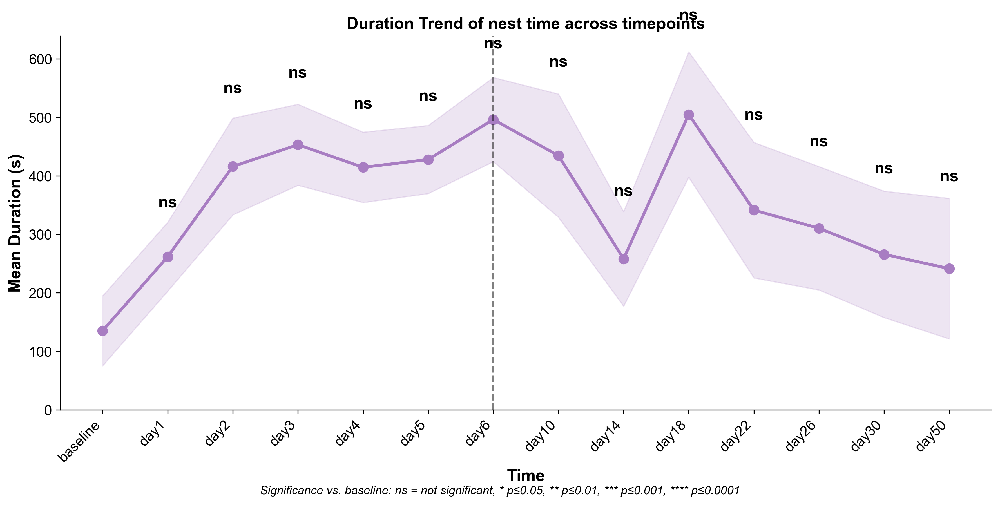


Analyzing behavior: retrieval to nest

SIGNIFICANCE SUMMARY FOR RETRIEVAL TO NEST:
Timepoint Raw p-value Corrected p-value Significance  n pairs
     day1      0.0273            0.0711           ns       10
     day2      0.0488            0.1058           ns       10
     day3      0.0020            0.0085           **       10
     day4      0.0059            0.0190            *       10
     day5      0.0020            0.0085           **       10
     day6      0.0020            0.0085           **       10
    day10      0.6744            0.8444           ns       10
    day14      0.3270            0.5314           ns       10
    day18      0.0645            0.1197           ns       10
    day22      0.4838            0.6989           ns       10
    day26      0.8658            0.8658           ns       10
    day30      0.7794            0.8444           ns       10
    day50      0.7794            0.8444           ns       10


/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


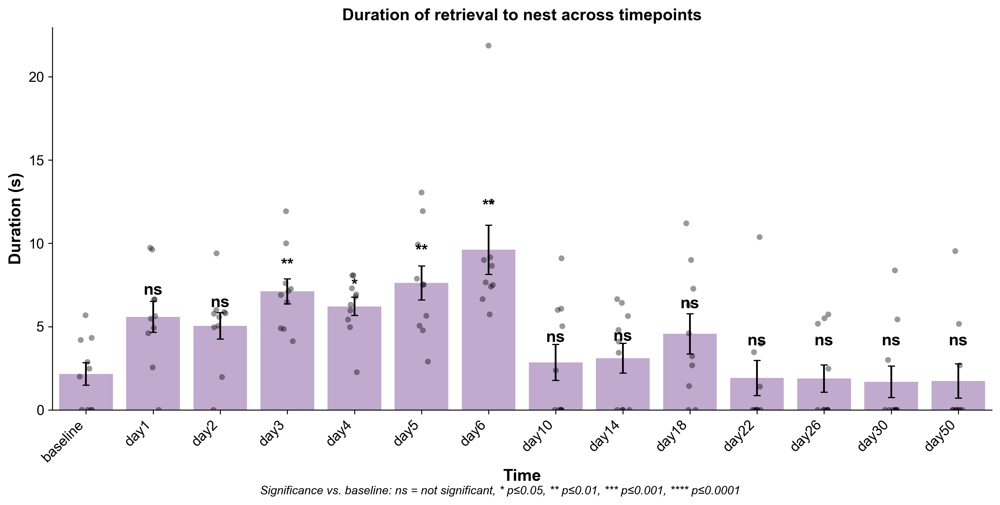

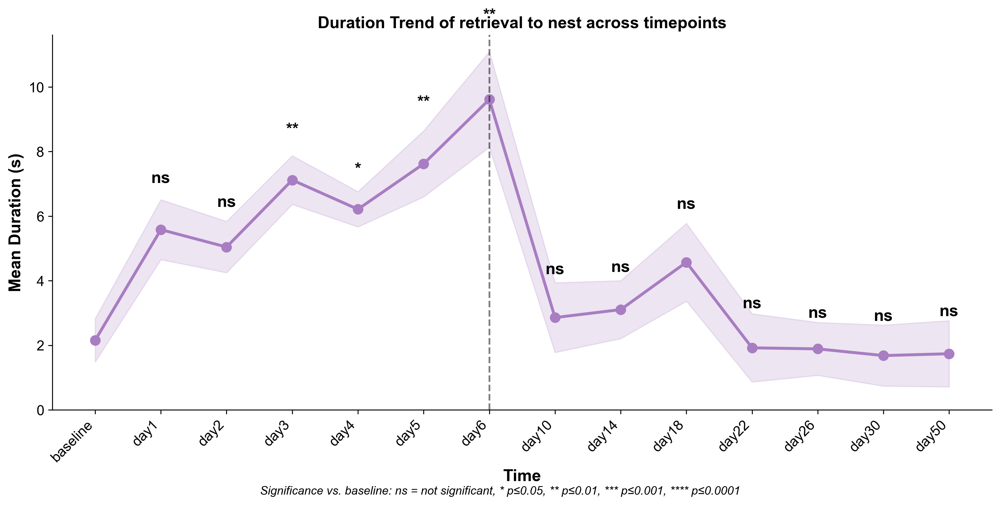


Analyzing behavior: overall retrieval

Diagnostic for overall retrieval - baseline vs day1:
Number of paired subjects: 10
First few baseline values: [8.115999999999929, 2.0, 5.78000000000003, 0.0, 0.0]
First few day1 values: [4.926000000000016, 0.0, 11.452000000000005, 5.4809999999999945, 6.634999999999991]
All zeros in baseline: False
All zeros in day1: False
All pairs have identical values: False

Diagnostic for overall retrieval - baseline vs day2:
Number of paired subjects: 10
First few baseline values: [8.115999999999929, 2.0, 5.78000000000003, 0.0, 0.0]
First few day2 values: [1.1989999999999839, 12.699999999999957, 16.026999999999987, 5.0519999999999925, 9.624000000000006]
All zeros in baseline: False
All zeros in day2: False
All pairs have identical values: False

Diagnostic for overall retrieval - baseline vs day3:
Number of paired subjects: 10
First few baseline values: [8.115999999999929, 2.0, 5.78000000000003, 0.0, 0.0]
First few day3 values: [7.575999999999976, 7.474, 7.9

/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


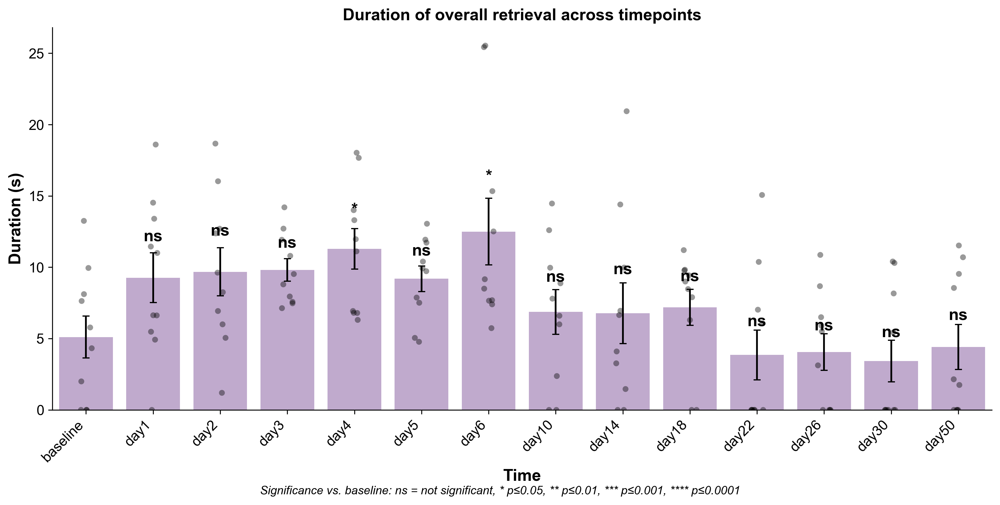

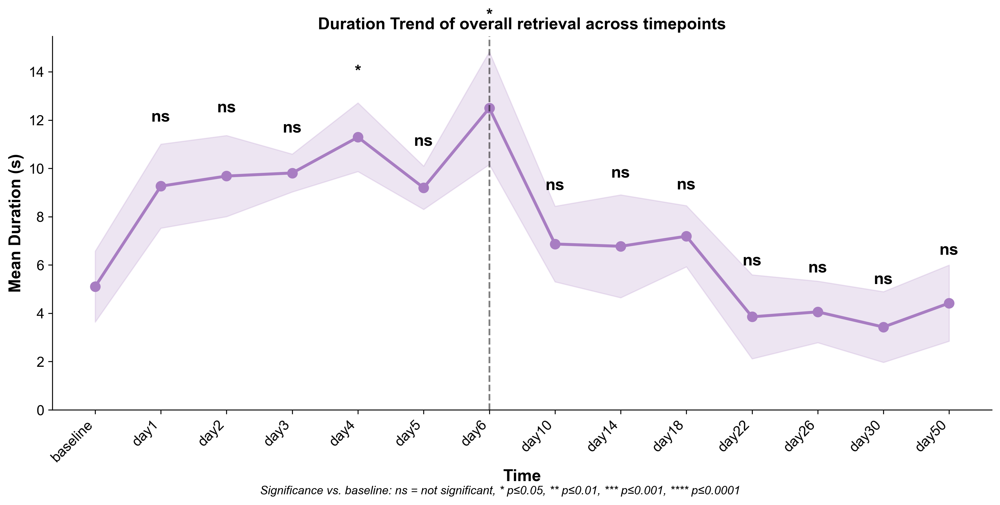


Analyzing behavior: crouching

SIGNIFICANCE SUMMARY FOR CROUCHING:
Timepoint Raw p-value Corrected p-value Significance  n pairs
     day1      0.3173            0.3438           ns       10
     day2      0.1797            0.3438           ns       10
     day3      0.3173            0.3438           ns       10
     day4      0.6547            0.6547           ns       10
     day5      0.1797            0.3438           ns       10
     day6      0.3173            0.3438           ns       10
    day10      0.3173            0.3438           ns       10
    day14      0.3173            0.3438           ns       10
    day18      0.3173            0.3438           ns       10
    day22      0.3173            0.3438           ns       10
    day26      0.3173            0.3438           ns       10
    day30      0.3173            0.3438           ns       10
    day50      0.3173            0.3438           ns       10


/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


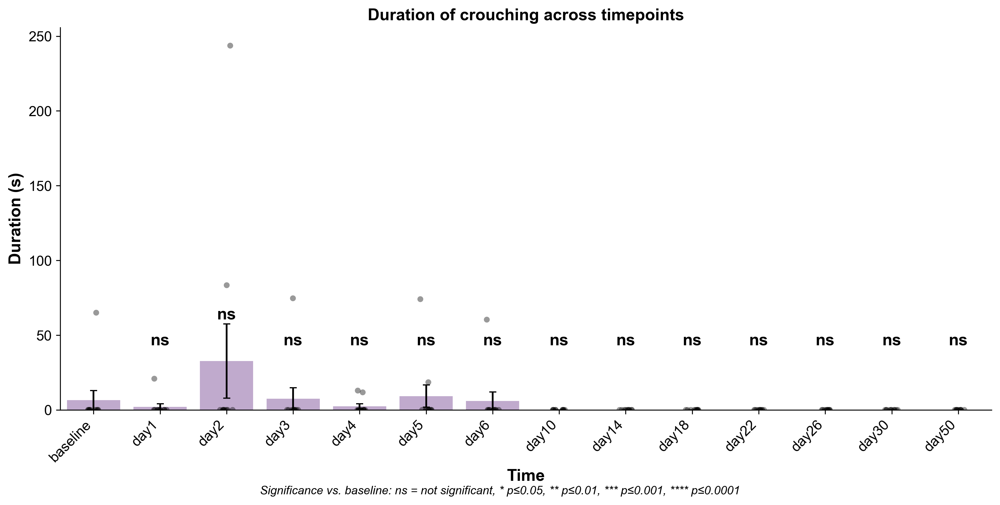

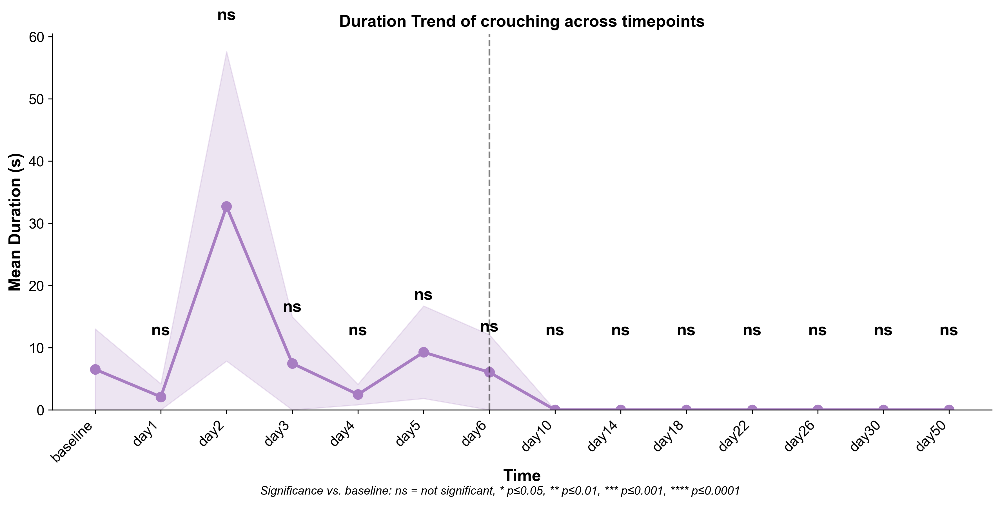


Analyzing behavior: nest building

Diagnostic for nest building - baseline vs day1:
Number of paired subjects: 10
First few baseline values: [4.043000000000006, 30.152000000000022, 2.1499999999999773, 0.0, 0.0]
First few day1 values: [82.65200000000013, 4.073999999999955, 19.867000000000075, 34.93299999999999, 88.9659999999999]
All zeros in baseline: False
All zeros in day1: False
All pairs have identical values: False

Diagnostic for nest building - baseline vs day2:
Number of paired subjects: 10
First few baseline values: [4.043000000000006, 30.152000000000022, 2.1499999999999773, 0.0, 0.0]
First few day2 values: [9.826000000000136, 237.87099999999987, 32.366000000000014, 155.50000000000006, 40.174999999999926]
All zeros in baseline: False
All zeros in day2: False
All pairs have identical values: False

Diagnostic for nest building - baseline vs day3:
Number of paired subjects: 10
First few baseline values: [4.043000000000006, 30.152000000000022, 2.1499999999999773, 0.0, 0.0]
First 

/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


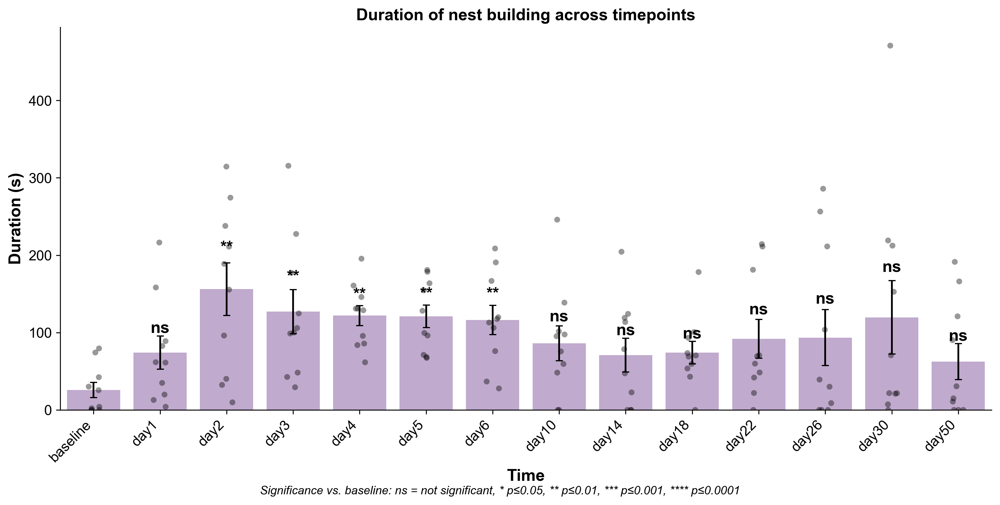

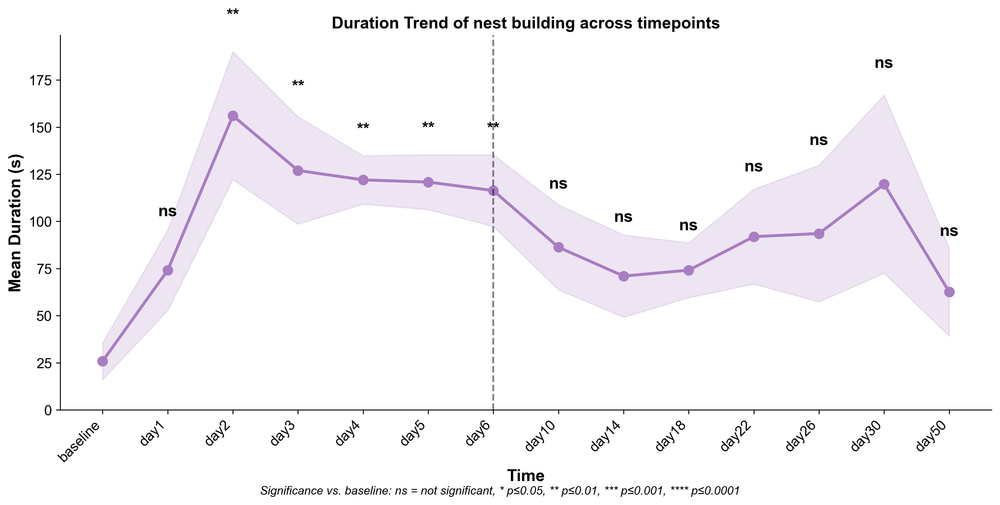

In [23]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from statsmodels.stats.multitest import multipletests
import matplotlib.ticker as mticker

# Make sure behaviors data is numeric
behaviours['duration'] = pd.to_numeric(behaviours['duration'])

# Get unique behaviors
unique_behaviors = behaviours['behaviour'].unique()

# Set up plotting style
plt.rcParams.update({
    'font.family': 'Arial',
    'font.size': 12,
    'axes.titlesize': 14,
    'axes.labelsize': 14,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'figure.figsize': (12, 6),
    'figure.dpi': 300
})

for behaviour in unique_behaviors:
    print(f"\n{'='*80}\nAnalyzing behavior: {behaviour}\n{'='*80}")
    
    # Filter data for this behavior
    behav_df = behaviours[behaviours['behaviour'] == behaviour].copy()
    
    # Create a complete dataframe with all IDs and timepoints
    all_ids = behav_df['ID'].unique()
    all_times = times  # Using the times list defined earlier
    complete_index = pd.MultiIndex.from_product([all_ids, all_times], names=['ID', 'time'])
    
    # Create a complete dataframe with all combinations and fill missing with 0
    complete_df = pd.DataFrame(index=complete_index).reset_index()
    complete_df = complete_df.merge(behav_df[['ID', 'time', 'duration']], 
                                   on=['ID', 'time'], how='left')
    complete_df['duration'] = complete_df['duration'].fillna(0)
    
    # Group by time and calculate statistics
    time_stats = complete_df.groupby('time')['duration'].agg(['mean', 'std', 'count']).reset_index()
    time_stats['sem'] = time_stats['std'] / np.sqrt(time_stats['count'])
    
    # Make sure time_stats is in the correct order
    time_stats['time'] = pd.Categorical(time_stats['time'], categories=times, ordered=True)
    time_stats = time_stats.sort_values('time')
    
    # Perform Wilcoxon signed-rank tests only between baseline and each timepoint
    wilcoxon_results = []
    baseline = 'baseline'
    
    # Only compare baseline with each other timepoint
    for timepoint in times:
        if timepoint != baseline:
            # Create paired data for this comparison
            paired_baseline = []
            paired_timepoint = []
            paired_ids = []  # Track which subjects are included
            
            # Iterate through each subject
            for subject_id in complete_df['ID'].unique():
                # Get baseline duration for this subject
                baseline_dur = complete_df[(complete_df['ID'] == subject_id) & 
                                        (complete_df['time'] == baseline)]['duration'].values
                
                # Get timepoint duration for this subject
                timepoint_dur = complete_df[(complete_df['ID'] == subject_id) & 
                                        (complete_df['time'] == timepoint)]['duration'].values
                
                # Only include this subject if they have data for both timepoints
                if len(baseline_dur) == 1 and len(timepoint_dur) == 1:
                    paired_baseline.append(baseline_dur[0])
                    paired_timepoint.append(timepoint_dur[0])
                    paired_ids.append(subject_id)
            
            # Debug print to help understand the data for problematic behaviors
            if behaviour in ["pup sniff", "pup groom", "aborted retrieval", "overall retrieval", "nest building"]:
                print(f"\nDiagnostic for {behaviour} - {baseline} vs {timepoint}:")
                print(f"Number of paired subjects: {len(paired_ids)}")
                if len(paired_baseline) > 0:
                    print(f"First few baseline values: {paired_baseline[:5]}")
                    print(f"First few {timepoint} values: {paired_timepoint[:5]}")
                    # Check if values are all the same
                    all_zeros_baseline = all(x == 0 for x in paired_baseline)
                    all_zeros_timepoint = all(x == 0 for x in paired_timepoint)
                    all_same = all(paired_baseline[i] == paired_timepoint[i] for i in range(len(paired_baseline)))
                    print(f"All zeros in baseline: {all_zeros_baseline}")
                    print(f"All zeros in {timepoint}: {all_zeros_timepoint}")
                    print(f"All pairs have identical values: {all_same}")
            
            # Perform Wilcoxon test on the paired data
            if paired_baseline and paired_timepoint:
                try:
                    # Check if all differences are zero (this causes identical p-values)
                    differences = [b - t for b, t in zip(paired_baseline, paired_timepoint)]
                    non_zero_diff = [d for d in differences if d != 0]
                    
                    if len(non_zero_diff) == 0:
                        # All differences are zero, explicitly set p-value to 1.0
                        print(f"All differences are zero for {behaviour} - {baseline} vs {timepoint}")
                        stat, p = np.nan, 1.0
                    else:
                        stat, p = stats.wilcoxon(paired_baseline, paired_timepoint)
                except ValueError as e:
                    print(f"Wilcoxon error for {behaviour} - {baseline} vs {timepoint}: {e}")
                    stat, p = np.nan, 1.0
                    
                wilcoxon_results.append({
                    'time1': baseline,
                    'time2': timepoint,
                    'statistic': stat,
                    'pvalue': p,
                    'n_pairs': len(paired_baseline)
                })
            else:
                # No paired data available
                wilcoxon_results.append({
                    'time1': baseline,
                    'time2': timepoint,
                    'statistic': np.nan,
                    'pvalue': np.nan,
                    'n_pairs': 0
                })
    
    # Convert to DataFrame
    results_df = pd.DataFrame(wilcoxon_results)
    
    # Apply FDR correction
    if not results_df.empty and not results_df['pvalue'].isna().all():
        # Check if all p-values are identical
        unique_pvals = results_df['pvalue'].unique()
        if len(unique_pvals) == 1:
            print(f"\nWARNING: All p-values for {behaviour} are identical: {unique_pvals[0]}")
            
        # Apply FDR correction
        _, corrected_p, _, _ = multipletests(results_df['pvalue'].fillna(1), method='fdr_bh')
        results_df['corrected_pvalue'] = corrected_p
        
        # Add significance stars
        sign = []
        for x in corrected_p:
            if x > 0.05:
                sign.append('ns')
            elif x <= 0.05 and x > 0.01:
                sign.append('*')
            elif x <= 0.01 and x > 0.001:
                sign.append('**')
            elif x <= 0.001 and x > 0.0001:
                sign.append('***')
            else:
                sign.append('****')
        
        results_df['significance'] = sign
        
        # Create a summary table of significance for visualization
        print("\n" + "=" * 40)
        print(f"SIGNIFICANCE SUMMARY FOR {behaviour.upper()}:")
        print("=" * 40)
        
        # Create a nicely formatted summary table
        summary_table = pd.DataFrame({
            'Timepoint': results_df['time2'],
            'Raw p-value': [f"{p:.4f}" for p in results_df['pvalue']],
            'Corrected p-value': [f"{p:.4f}" for p in results_df['corrected_pvalue']],
            'Significance': results_df['significance'],
            'n pairs': results_df['n_pairs']
        })
        
        # Sort by timepoint in the defined order
        summary_table['Timepoint'] = pd.Categorical(summary_table['Timepoint'], categories=times[1:], ordered=True)
        summary_table = summary_table.sort_values('Timepoint')
        
        # Display the summary table
        print(summary_table.to_string(index=False))
        print("=" * 40)
        
        # Create a map of timepoint to significance for plot annotations
        sig_map = dict(zip(results_df['time2'], results_df['significance']))
    else:
        sig_map = {}  # Empty map if no significance testing was performed
    
    # Create visualization
    plt.figure(figsize=(12, 6))
    
    # Plot duration across timepoints - ensure time is in correct order
    ax = sns.barplot(x='time', y='mean', data=time_stats, color='xkcd:wisteria', alpha=0.7, order=times)
    
    # Add error bars
    for i, time_point in enumerate(times):
        if time_point in time_stats['time'].values:
            idx = time_stats.index[time_stats['time'] == time_point].tolist()[0]
            ax.errorbar(i, time_stats.loc[idx, 'mean'], 
                        yerr=time_stats.loc[idx, 'sem'], 
                        fmt='none', color='black', capsize=3)
    
    # Add individual data points with proper ordering
    sns.stripplot(x='time', y='duration', data=complete_df, color='black', alpha=0.4, jitter=True, order=times)
    
    # Add significance annotations above each bar except baseline
    if sig_map:
        max_y = ax.get_ylim()[1] * 0.9  # Get 90% of the y-axis limit for annotation position
        for i, time_point in enumerate(times):
            if time_point != baseline and time_point in sig_map:
                if time_point in time_stats['time'].values:
                    idx = time_stats.index[time_stats['time'] == time_point].tolist()[0]
                    bar_height = time_stats.loc[idx, 'mean'] + time_stats.loc[idx, 'sem']
                    # Position the annotation above the error bar
                    y_pos = max(bar_height * 1.1, max_y * 0.2)
                    ax.annotate(sig_map[time_point], 
                                xy=(i, y_pos),
                                ha='center', va='center',
                                fontsize=14, fontweight='bold')
    
    # Customize plot
    plt.title(f'Duration of {behaviour} across timepoints', fontweight='bold')
    plt.xlabel('Time', fontweight='bold')
    plt.ylabel('Duration (s)', fontweight='bold')
    plt.xticks(rotation=45, ha='right')
    
    # Set y-axis to start at 0
    plt.ylim(bottom=0)
    
    # Remove top and right spines
    sns.despine()
    
    # Add a subtitle with significance info
    if sig_map:
        # Add a subtitle explaining significance markers
        plt.figtext(0.5, 0.01, 
                   "Significance vs. baseline: ns = not significant, * p≤0.05, ** p≤0.01, *** p≤0.001, **** p≤0.0001", 
                   ha="center", fontsize=10, style='italic')
    
    plt.tight_layout()
    plt.savefig(f'plots/{behaviour}_duration_analysis.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # Also create a line plot for trend visualization with correct ordering
    plt.figure(figsize=(12, 6))
    
    # Create numeric x positions for the line plot
    x_positions = np.arange(len(times))
    time_to_position = {time: pos for pos, time in enumerate(times)}
    
    # Create the plot using the x positions
    mean_values = []
    sem_upper = []
    sem_lower = []
    
    # Get values in the correct order
    for time_point in times:
        if time_point in time_stats['time'].values:
            idx = time_stats.index[time_stats['time'] == time_point].tolist()[0]
            mean_values.append(time_stats.loc[idx, 'mean'])
            sem_upper.append(time_stats.loc[idx, 'mean'] + time_stats.loc[idx, 'sem'])
            sem_lower.append(time_stats.loc[idx, 'mean'] - time_stats.loc[idx, 'sem'])
        else:
            # If no data for this timepoint, use NaN
            mean_values.append(np.nan)
            sem_upper.append(np.nan)
            sem_lower.append(np.nan)
    
    # Plot the line
    plt.plot(x_positions, mean_values, marker='o', markersize=8, color='xkcd:wisteria', linewidth=2.5)
    
    # Add error region
    plt.fill_between(x_positions, sem_lower, sem_upper, alpha=0.2, color='xkcd:wisteria')
    
    # Add significance markers to the line plot
    if sig_map:
        max_y = max([x for x in sem_upper if not np.isnan(x)]) * 1.1
        for i, time_point in enumerate(times):
            if time_point != baseline and time_point in sig_map:
                if i < len(mean_values) and not np.isnan(mean_values[i]):
                    y_pos = max(sem_upper[i] * 1.1, max_y * 0.2)
                    plt.text(i, y_pos, sig_map[time_point], 
                             ha='center', va='center', fontsize=14, fontweight='bold')
    
    # Set the x-ticks to the time labels
    plt.xticks(x_positions, times, rotation=45, ha='right')
    
    # Customize plot
    plt.title(f'Duration Trend of {behaviour} across timepoints', fontweight='bold')
    plt.xlabel('Time', fontweight='bold')
    plt.ylabel('Mean Duration (s)', fontweight='bold')
    
    # Set y-axis to start at 0
    plt.ylim(bottom=0)
    
    # Add vertical line at day 6
    if 'day6' in times:
        day6_idx = times.index('day6')
        plt.axvline(x=day6_idx, color='black', linestyle='--', alpha=0.5, linewidth=1.5)
    
    # Remove top and right spines
    sns.despine()
    
    # Add a subtitle with significance info
    if sig_map:
        # Add a subtitle explaining significance markers
        plt.figtext(0.5, 0.01, 
                   "Significance vs. baseline: ns = not significant, * p≤0.05, ** p≤0.01, *** p≤0.001, **** p≤0.0001", 
                   ha="center", fontsize=10, style='italic')
    
    plt.tight_layout()
    plt.savefig(f'plots/{behaviour}_duration_trend.png', dpi=300, bbox_inches='tight')
    plt.show()


Processing visualization for: pup sniff

Wilcoxon Test Results with FDR correction (baseline vs. other timepoints):
       time1  time2    pvalue  corrected_pvalue significance
0   baseline   day1  0.007686          0.012489            *
1   baseline   day2  0.007686          0.012489            *
2   baseline   day3  0.007686          0.012489            *
3   baseline   day4  0.007686          0.012489            *
4   baseline   day5  0.007686          0.012489            *
5   baseline   day6  0.003906          0.012489            *
6   baseline  day10  0.007686          0.012489            *
7   baseline  day14  0.027344          0.029622            *
8   baseline  day18  0.037109          0.037109            *
9   baseline  day22  0.009766          0.014106            *
10  baseline  day26  0.003906          0.012489            *
11  baseline  day30  0.019531          0.023082            *
12  baseline  day50  0.013672          0.017773            *

Significant timepoints compa

/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


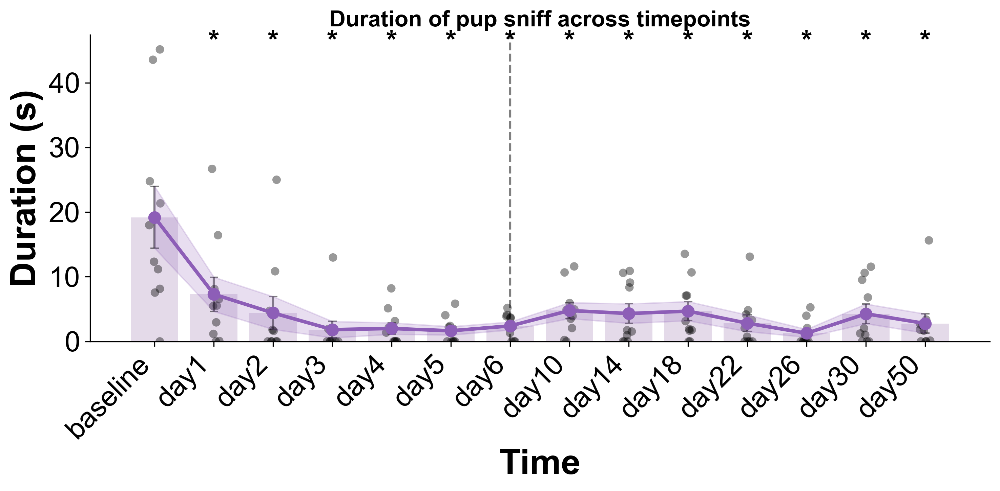


Processing visualization for: pup groom

Wilcoxon Test Results with FDR correction (baseline vs. other timepoints):
       time1  time2    pvalue  corrected_pvalue significance
0   baseline   day1  0.130859          0.170117           ns
1   baseline   day2  0.009766          0.042318            *
2   baseline   day3  0.064453          0.104736           ns
3   baseline   day4  0.001953          0.012695            *
4   baseline   day5  0.001953          0.012695            *
5   baseline   day6  0.105469          0.152344           ns
6   baseline  day10  0.064453          0.104736           ns
7   baseline  day14  0.037109          0.096484           ns
8   baseline  day18  0.027344          0.088867           ns
9   baseline  day22  0.160156          0.189276           ns
10  baseline  day26  0.064453          0.104736           ns
11  baseline  day30  0.769531          0.833659           ns
12  baseline  day50  1.000000          1.000000           ns

Significant timepoints compa

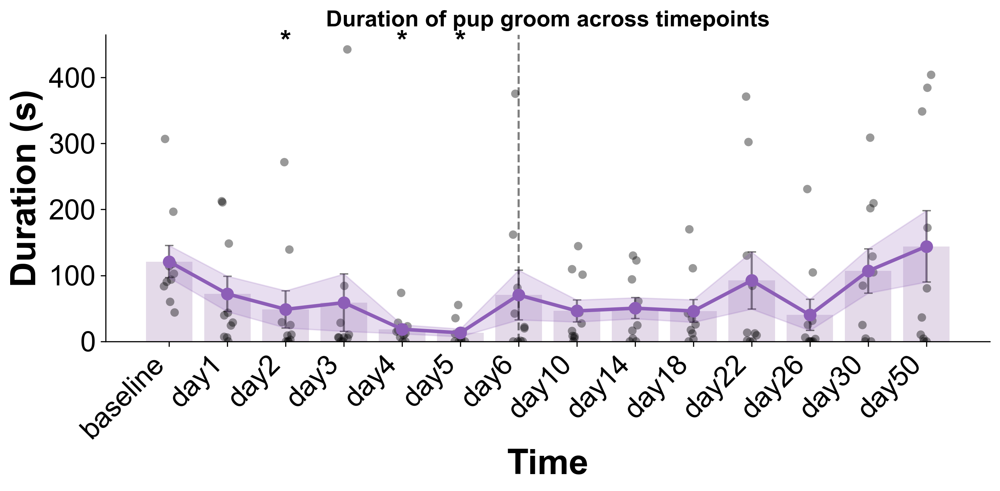


Processing visualization for: aborted retrieval

Wilcoxon Test Results with FDR correction (baseline vs. other timepoints):
       time1  time2    pvalue  corrected_pvalue significance
0   baseline   day1  0.463071          0.926644           ns
1   baseline   day2  0.092892          0.926644           ns
2   baseline   day3  0.952765          0.952765           ns
3   baseline   day4  0.483840          0.926644           ns
4   baseline   day5  0.236724          0.926644           ns
5   baseline   day6  0.463071          0.926644           ns
6   baseline  day10  0.593955          0.952765           ns
7   baseline  day14  0.888638          0.952765           ns
8   baseline  day18  0.888638          0.952765           ns
9   baseline  day22  0.498962          0.926644           ns
10  baseline  day26  0.735317          0.952765           ns
11  baseline  day30  0.345448          0.926644           ns
12  baseline  day50  0.767097          0.952765           ns


/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


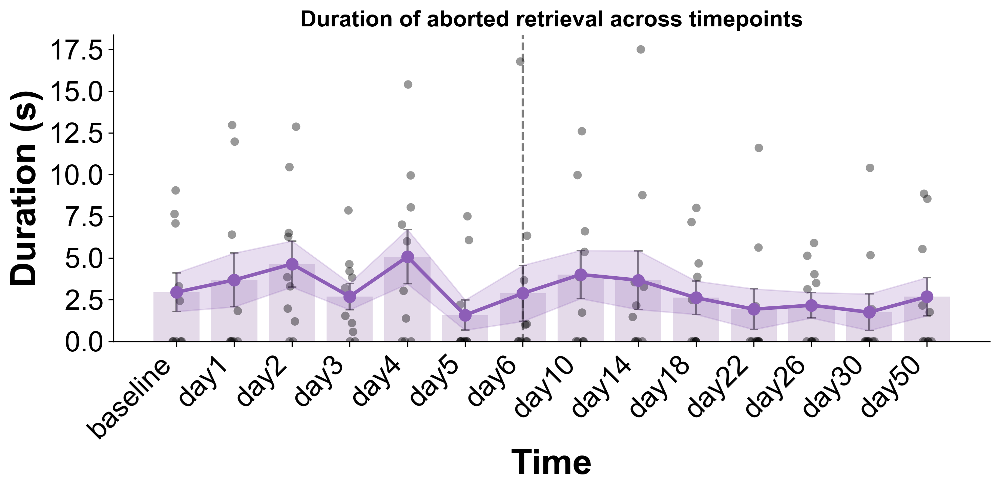


Processing visualization for: nest time

Wilcoxon Test Results with FDR correction (baseline vs. other timepoints):
       time1  time2    pvalue  corrected_pvalue significance
0   baseline   day1  0.109745          0.178335           ns
1   baseline   day2  0.048828          0.105794           ns
2   baseline   day3  0.013672          0.067858           ns
3   baseline   day4  0.027344          0.071094           ns
4   baseline   day5  0.019531          0.067858           ns
5   baseline   day6  0.013672          0.067858           ns
6   baseline  day10  0.085831          0.159400           ns
7   baseline  day14  0.326989          0.386442           ns
8   baseline  day18  0.020879          0.067858           ns
9   baseline  day22  0.128190          0.185164           ns
10  baseline  day26  0.161429          0.209858           ns
11  baseline  day30  0.400814          0.434215           ns
12  baseline  day50  0.498962          0.498962           ns


/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


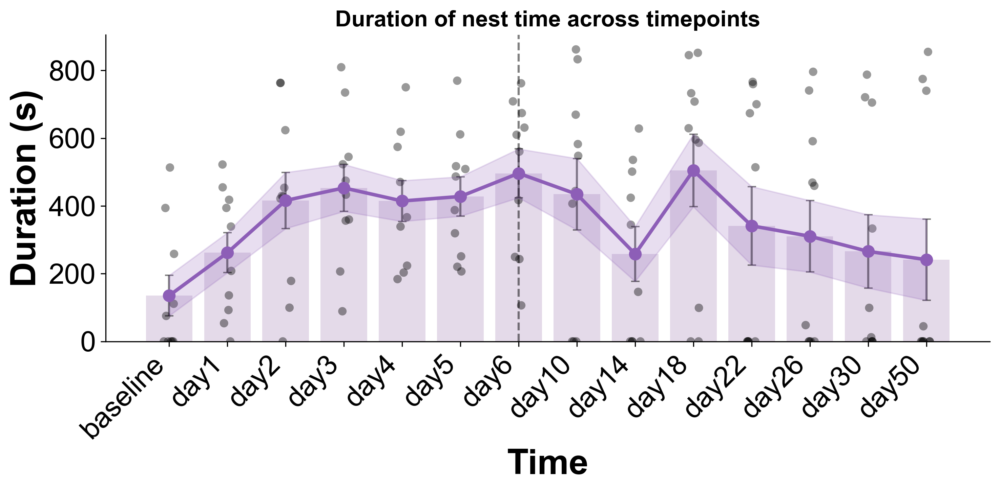


Processing visualization for: retrieval to nest

Wilcoxon Test Results with FDR correction (baseline vs. other timepoints):
       time1  time2    pvalue  corrected_pvalue significance
0   baseline   day1  0.027344          0.071094           ns
1   baseline   day2  0.048828          0.105794           ns
2   baseline   day3  0.001953          0.008464           **
3   baseline   day4  0.005859          0.019043            *
4   baseline   day5  0.001953          0.008464           **
5   baseline   day6  0.001953          0.008464           **
6   baseline  day10  0.674424          0.844387           ns
7   baseline  day14  0.326989          0.531358           ns
8   baseline  day18  0.064453          0.119699           ns
9   baseline  day22  0.483840          0.698880           ns
10  baseline  day26  0.865772          0.865772           ns
11  baseline  day30  0.779435          0.844387           ns
12  baseline  day50  0.779435          0.844387           ns

Significant timepoin

/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


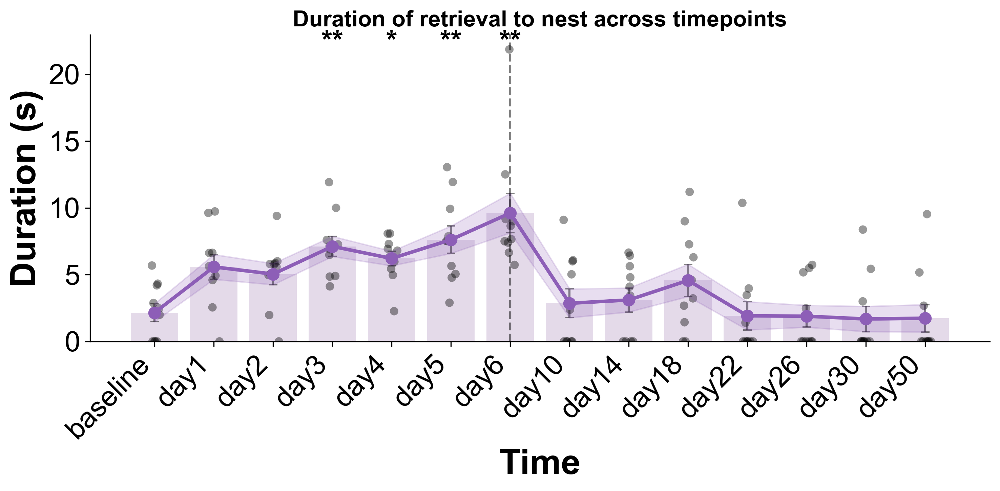


Processing visualization for: overall retrieval

Wilcoxon Test Results with FDR correction (baseline vs. other timepoints):
       time1  time2    pvalue  corrected_pvalue significance
0   baseline   day1  0.027344          0.118490           ns
1   baseline   day2  0.048828          0.126953           ns
2   baseline   day3  0.083984          0.181966           ns
3   baseline   day4  0.005859          0.038086            *
4   baseline   day5  0.037109          0.120605           ns
5   baseline   day6  0.003906          0.038086            *
6   baseline  day10  0.593955          0.772141           ns
7   baseline  day14  0.514670          0.743412           ns
8   baseline  day18  0.160156          0.297433           ns
9   baseline  day22  0.674424          0.797047           ns
10  baseline  day26  0.888638          0.888638           ns
11  baseline  day30  0.483840          0.743412           ns
12  baseline  day50  0.858955          0.888638           ns

Significant timepoin

/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


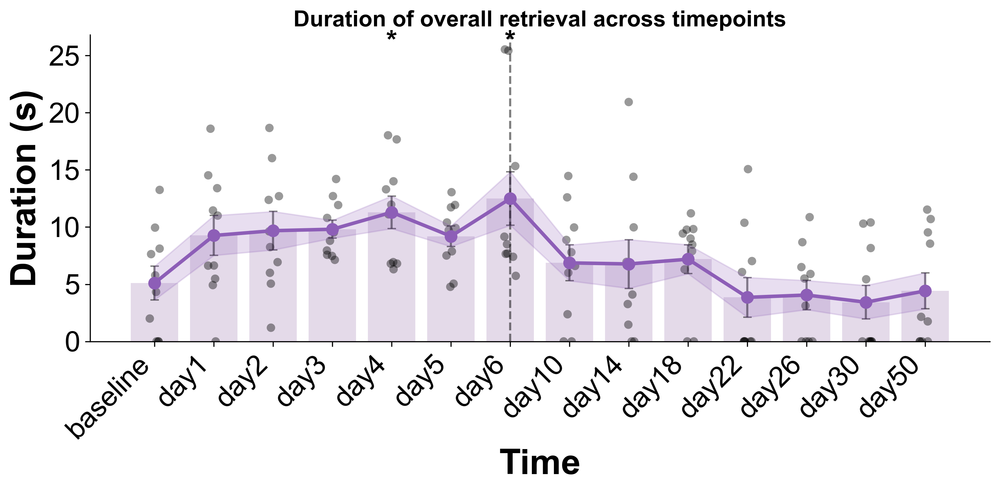


Processing visualization for: crouching

Wilcoxon Test Results with FDR correction (baseline vs. other timepoints):
       time1  time2    pvalue  corrected_pvalue significance
0   baseline   day1  0.317311          0.343753           ns
1   baseline   day2  0.179712          0.343753           ns
2   baseline   day3  0.317311          0.343753           ns
3   baseline   day4  0.654721          0.654721           ns
4   baseline   day5  0.179712          0.343753           ns
5   baseline   day6  0.317311          0.343753           ns
6   baseline  day10  0.317311          0.343753           ns
7   baseline  day14  0.317311          0.343753           ns
8   baseline  day18  0.317311          0.343753           ns
9   baseline  day22  0.317311          0.343753           ns
10  baseline  day26  0.317311          0.343753           ns
11  baseline  day30  0.317311          0.343753           ns
12  baseline  day50  0.317311          0.343753           ns


/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


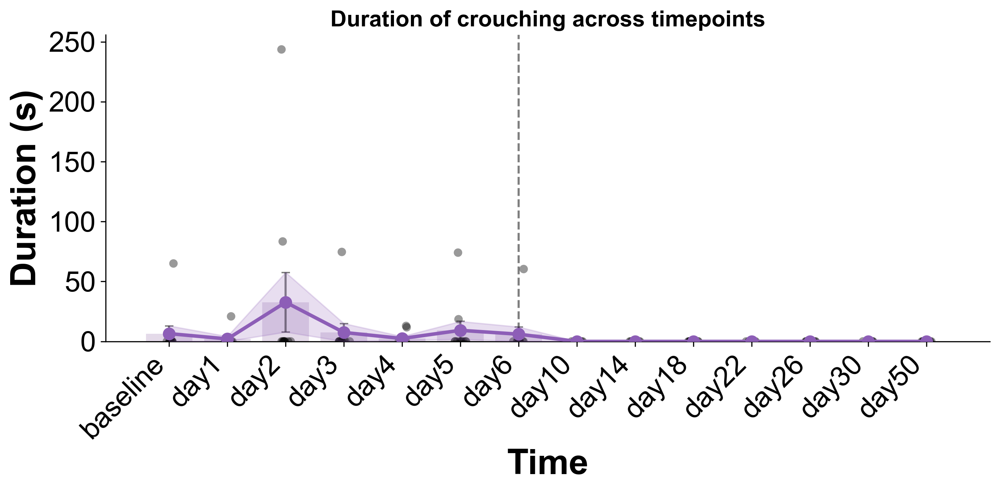


Processing visualization for: nest building

Wilcoxon Test Results with FDR correction (baseline vs. other timepoints):
       time1  time2    pvalue  corrected_pvalue significance
0   baseline   day1  0.037109          0.080404           ns
1   baseline   day2  0.001953          0.005078           **
2   baseline   day3  0.001953          0.005078           **
3   baseline   day4  0.001953          0.005078           **
4   baseline   day5  0.001953          0.005078           **
5   baseline   day6  0.001953          0.005078           **
6   baseline  day10  0.050612          0.082245           ns
7   baseline  day14  0.109745          0.142668           ns
8   baseline  day18  0.048828          0.082245           ns
9   baseline  day22  0.083984          0.121311           ns
10  baseline  day26  0.213524          0.231318           ns
11  baseline  day30  0.193359          0.228516           ns
12  baseline  day50  0.322266          0.322266           ns

Significant timepoints c

/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3141: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/Users/irenesalgarella/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/morestats.py:3155: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


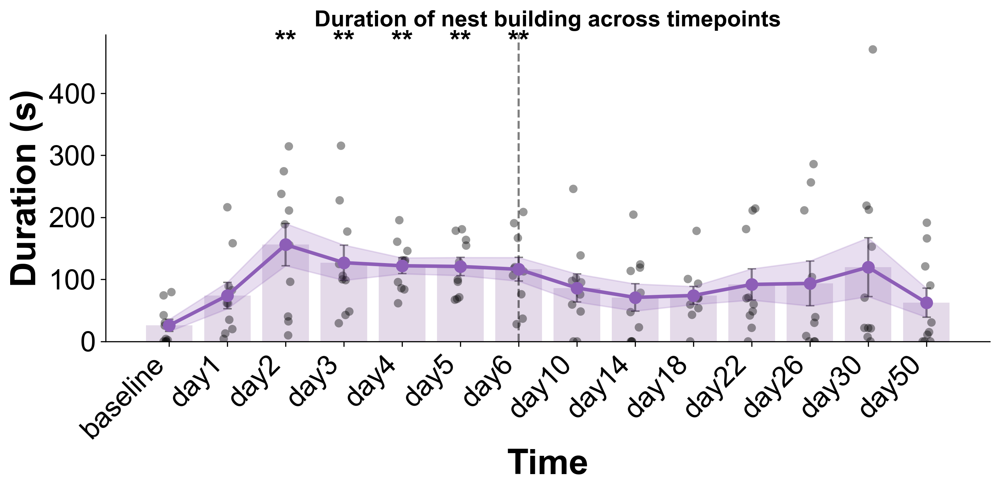

In [35]:
# Get all unique behaviors
unique_behaviors = behaviours['behaviour'].unique()

# Create one visualization per behavior
for behaviour in unique_behaviors:
    print(f"\nProcessing visualization for: {behaviour}")
    
    # Filter data for this behavior
    behav_df = behaviours[behaviours['behaviour'] == behaviour].copy()
    
    # Create a complete dataframe with all IDs and timepoints
    all_ids = behav_df['ID'].unique()
    complete_index = pd.MultiIndex.from_product([all_ids, times], names=['ID', 'time'])
    
    # Create a complete dataframe with all combinations and fill missing with 0
    complete_df = pd.DataFrame(index=complete_index).reset_index()
    complete_df = complete_df.merge(behav_df[['ID', 'time', 'duration']], 
                                   on=['ID', 'time'], how='left')
    complete_df['duration'] = complete_df['duration'].fillna(0)
    
    # Group by time and calculate statistics
    time_stats = complete_df.groupby('time')['duration'].agg(['mean', 'std', 'count']).reset_index()
    time_stats['sem'] = time_stats['std'] / np.sqrt(time_stats['count'])
    
    # Make sure time_stats is in the correct order
    time_stats['time'] = pd.Categorical(time_stats['time'], categories=times, ordered=True)
    time_stats = time_stats.sort_values('time')
    
    # Calculate behavior-specific Wilcoxon test results
    wilcoxon_results = []
    baseline = 'baseline'
    
    # Compare baseline with each other timepoint
    for timepoint in times:
        if timepoint != baseline:
            # Create paired data for this comparison
            paired_baseline = []
            paired_timepoint = []
            
            # Iterate through each subject
            for subject_id in complete_df['ID'].unique():
                # Get baseline duration for this subject
                baseline_dur = complete_df[(complete_df['ID'] == subject_id) & 
                                        (complete_df['time'] == baseline)]['duration'].values
                
                # Get timepoint duration for this subject
                timepoint_dur = complete_df[(complete_df['ID'] == subject_id) & 
                                        (complete_df['time'] == timepoint)]['duration'].values
                
                # Only include this subject if they have data for both timepoints
                if len(baseline_dur) == 1 and len(timepoint_dur) == 1:
                    paired_baseline.append(baseline_dur[0])
                    paired_timepoint.append(timepoint_dur[0])
            
            # Perform Wilcoxon test on the paired data
            if paired_baseline and paired_timepoint:
                try:
                    # Check if all differences are zero
                    differences = [b - t for b, t in zip(paired_baseline, paired_timepoint)]
                    non_zero_diff = [d for d in differences if d != 0]
                    
                    if len(non_zero_diff) == 0:
                        # All differences are zero, explicitly set p-value to 1.0
                        stat, p = np.nan, 1.0
                    else:
                        stat, p = stats.wilcoxon(paired_baseline, paired_timepoint)
                except ValueError as e:
                    print(f"Wilcoxon error for {behaviour} - {baseline} vs {timepoint}: {e}")
                    stat, p = np.nan, 1.0
                    
                wilcoxon_results.append({
                    'time1': baseline,
                    'time2': timepoint,
                    'statistic': stat,
                    'pvalue': p,
                    'n_pairs': len(paired_baseline)
                })
            else:
                # No paired data available
                wilcoxon_results.append({
                    'time1': baseline,
                    'time2': timepoint,
                    'statistic': np.nan,
                    'pvalue': np.nan,
                    'n_pairs': 0
                })
    
    # Convert to behavior-specific DataFrame
    behavior_results_df = pd.DataFrame(wilcoxon_results)
    
    # Apply FDR correction
    if not behavior_results_df.empty and not behavior_results_df['pvalue'].isna().all():
        # Apply FDR correction
        _, corrected_p, _, _ = multipletests(behavior_results_df['pvalue'].fillna(1), method='fdr_bh')
        behavior_results_df['corrected_pvalue'] = corrected_p
        
        # Add significance stars
        sign = []
        for x in corrected_p:
            if x > 0.05:
                sign.append('ns')
            elif x <= 0.05 and x > 0.01:
                sign.append('*')
            elif x <= 0.01 and x > 0.001:
                sign.append('**')
            elif x <= 0.001 and x > 0.0001:
                sign.append('***')
            else:
                sign.append('****')
        
        behavior_results_df['significance'] = sign
        
        # Print results
        print("\nWilcoxon Test Results with FDR correction (baseline vs. other timepoints):")
        pd.set_option('display.max_rows', None)
        print(behavior_results_df[['time1', 'time2', 'pvalue', 'corrected_pvalue', 'significance']])
        
        # Create a nicely formatted summary table for significant findings
        sig_results = behavior_results_df[behavior_results_df['significance'] != 'ns'].copy()
        if not sig_results.empty:
            print("\nSignificant timepoints compared to baseline:")
            for _, row in sig_results.iterrows():
                print(f"- {row['time2']}: {row['significance']} (p={row['corrected_pvalue']:.4f})")
    
    # Create visualization 
    plt.figure(figsize=(10, 5))
    
    # Rest of visualization code remains the same...
    # Plot barplot with higher transparency
    ax = sns.barplot(x='time', y='mean', data=time_stats, color='xkcd:wisteria', 
                    alpha=0.3, order=times)

    # Add error bars for the barplot
    for i, time_point in enumerate(times):
        if time_point in time_stats['time'].values:
            idx = time_stats.index[time_stats['time'] == time_point].tolist()[0]
            ax.errorbar(i, time_stats.loc[idx, 'mean'], 
                        yerr=time_stats.loc[idx, 'sem'], 
                        fmt='none', color='black', capsize=3, alpha=0.5)

    # Add individual data points with proper ordering
    sns.stripplot(x='time', y='duration', data=complete_df, color='black', 
                 alpha=0.4, jitter=True, order=times, size=6)

    # Create values for the line plot
    x_positions = np.arange(len(times))
    mean_values = []
    sem_upper = []
    sem_lower = []

    # Get values in the correct order
    for time_point in times:
        if time_point in time_stats['time'].values:
            idx = time_stats.index[time_stats['time'] == time_point].tolist()[0]
            mean_values.append(time_stats.loc[idx, 'mean'])
            sem_upper.append(time_stats.loc[idx, 'mean'] + time_stats.loc[idx, 'sem'])
            sem_lower.append(time_stats.loc[idx, 'mean'] - time_stats.loc[idx, 'sem'])
        else:
            mean_values.append(np.nan)
            sem_upper.append(np.nan)
            sem_lower.append(np.nan)

    # Overlay the line plot
    plt.plot(x_positions, mean_values, marker='o', markersize=8, 
             color='#8d5eb7', linewidth=2.5, zorder=10)

    # Add error region for the line
    plt.fill_between(x_positions, sem_lower, sem_upper, alpha=0.2, 
                    color='#8d5eb7', zorder=5)

    # Add vertical line at day 6
    if 'day6' in times:
        day6_idx = times.index('day6')
        plt.axvline(x=day6_idx, color='black', linestyle='--', alpha=0.5, linewidth=1.5)

    # Customize plot
    plt.title(f'Duration of {behaviour} across timepoints', fontweight='bold', fontsize=16)
    plt.xlabel('Time', fontweight='bold', fontsize=25)
    plt.ylabel('Duration (s)', fontweight='bold', fontsize=25)
    plt.xticks(x_positions, times, rotation=45, ha='right', fontsize=20)
    plt.yticks(fontsize=20)

    # Add significance markers if available
    if not behavior_results_df.empty and not behavior_results_df['pvalue'].isna().all():
        # Get the max height for placing significance markers
        valid_means = [m for m in mean_values if not np.isnan(m)]
        if valid_means and complete_df['duration'].max() > 0:
            max_height = max(max(valid_means) + 0.1 * max(valid_means), 
                         complete_df['duration'].max() * 1.05)
            
            # Add significance markers above the relevant bars
            for _, row in behavior_results_df.iterrows():
                if row['significance'] != 'ns':
                    time_idx = times.index(row['time2'])
                    plt.text(time_idx, max_height * 0.95, 
                         row['significance'], ha='center', fontweight='bold', fontsize=20)

    # Set y-axis to start at 0
    plt.ylim(bottom=0)

    # Remove top and right spines
    sns.despine()

    plt.tight_layout()
    
    # Create directory if it doesn't exist
    os.makedirs('plots', exist_ok=True)
    
    # Save the figure with behavior name in the filename
    plt.savefig(f'plots/{behaviour}_combined_analysis.png', dpi=300, bbox_inches='tight')
    plt.show()

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_51300/613305624.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.duration = pd.to_numeric(behav_df.duration)


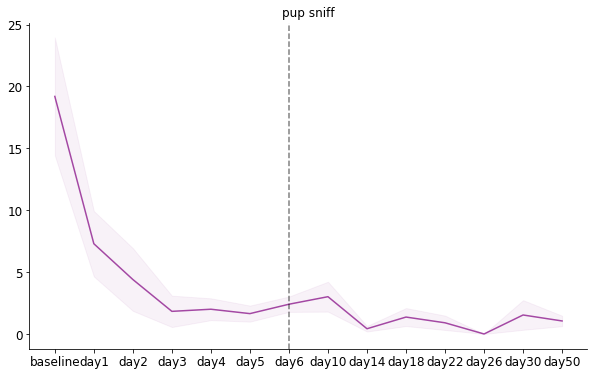

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_51300/613305624.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.duration = pd.to_numeric(behav_df.duration)


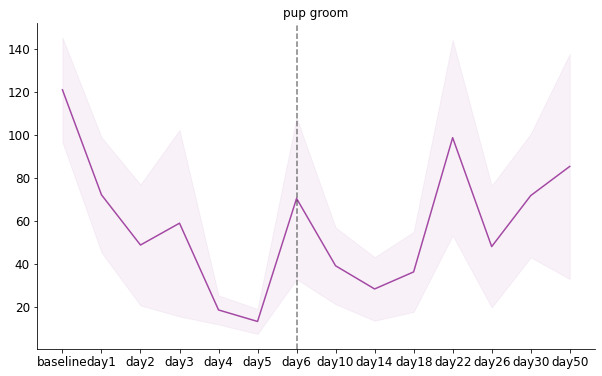

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_51300/613305624.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.duration = pd.to_numeric(behav_df.duration)


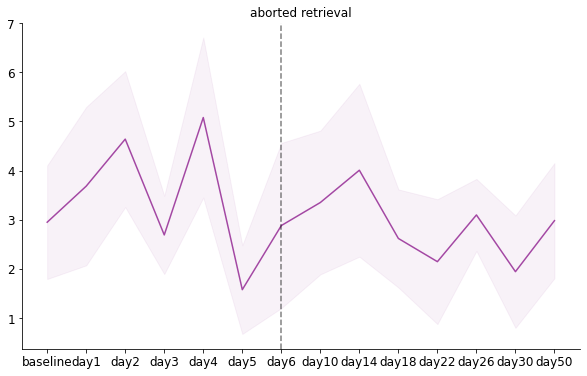

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_51300/613305624.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.duration = pd.to_numeric(behav_df.duration)


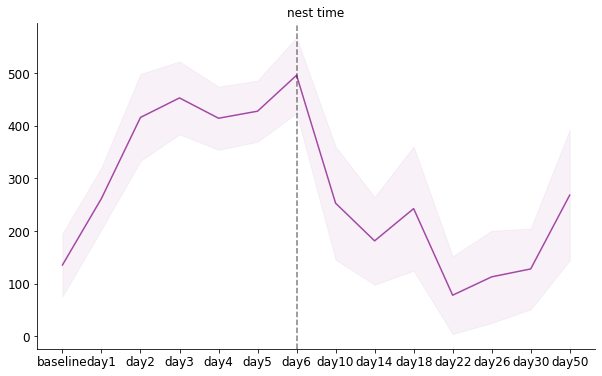

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_51300/613305624.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.duration = pd.to_numeric(behav_df.duration)


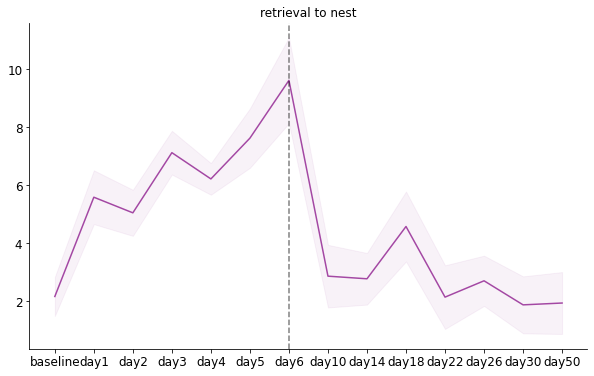

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_51300/613305624.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.duration = pd.to_numeric(behav_df.duration)


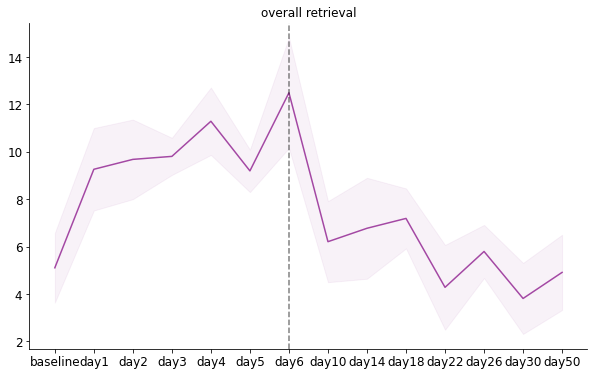

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_51300/613305624.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.duration = pd.to_numeric(behav_df.duration)


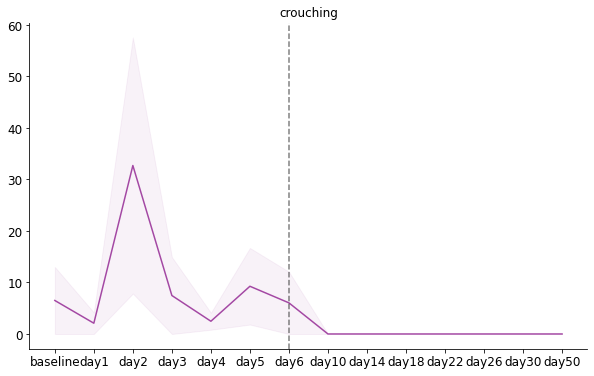

/var/folders/4g/5slcnh6x71lgn2r91zbk1pwr0000gn/T/ipykernel_51300/613305624.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behav_df.duration = pd.to_numeric(behav_df.duration)


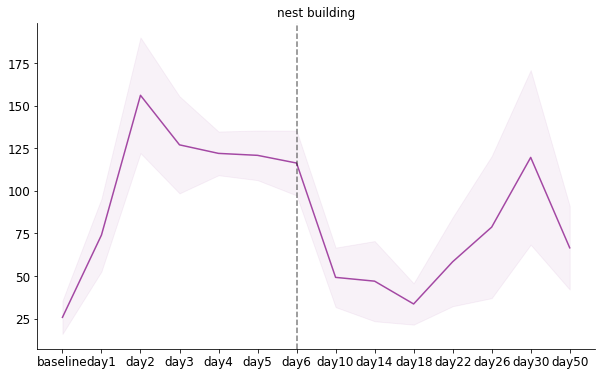

In [ ]:
# duration_stats_result = pd.DataFrame()

# for behaviour in behaviours.behaviour.unique():
#     behav_df = behaviours[behaviours.behaviour == behaviour]

#     behav_df.duration = pd.to_numeric(behav_df.duration)
#     mean = behav_df.groupby(by = 'time').mean().reset_index()
#     st_error = behav_df.groupby(by = 'time').std()/np.sqrt(len(behav_df.ID.unique()))
#     st_error = st_error.reset_index()

#     # ANOVA for duration
#     model = smf.ols('duration ~ C(time)', data = behav_df).fit()
#     sm.stats.anova_lm(model, typ = 2)
    
#     m_comp = pairwise_tukeyhsd(endog=behav_df.duration, groups = behav_df.time, alpha = 0.05)
#     df = pd.DataFrame(data=m_comp._results_table.data[1:], columns= m_comp._results_table.data[0])
#     df['behaviour'] = behaviour
#     duration_stats_result = pd.concat([duration_stats_result, df])
   
    
#     plt.subplots(figsize = [10,6])

#     fig.tight_layout()
    
#     plt.plot(mean.time, mean.duration, color = 'purple', alpha = 0.7)
#     plt.fill_between(mean.time,  mean.duration + st_error.duration, mean.duration - st_error.duration, 
#                      color = 'purple', alpha = 0.05)
    
#     ax.set_xlim(['baseline', 'day50'])
#     ax.set_ylim([0, 900])
#     ax.spines['right'].set_visible(False)
#     ax.spines['top'].set_visible(False)
    
#     plt.axvline(x = 'day6', color = 'black', linestyle = '--', alpha = 0.5)

#     plt.xticks(fontsize = 12)
#     plt.yticks(fontsize = 12)
    
#     # sns.stripplot(x = "time", y = "duration", data = behav_df, palette = ["Tab:blue"], alpha = 0.7)
#     plt.title(behaviour)
#     sns.despine()
#     plt.savefig(f'plots/{behaviour}_duration.jpg', dpi = 300, bbox_inches = 'tight')
#     plt.show()

# duration_stats_result.to_csv('/Users/salgari/Documents/Documents - XJK222YYCT/GitHub/sensitization_behaviour/generated_dataset/duration_stats_result.csv', index = False)

In [ ]:
print(m_comp._results_table.values)

In [ ]:
# chi square test for percentage of animals that performed the behaviour
chi2_results = pd.DataFrame()

for behaviour in behaviours.behaviour.unique():
    for comb in itertools.combinations(times, 2):
        behav_df = behaviours[behaviours.behaviour == behaviour]
        behav_df = behav_df[behav_df.time.isin(comb)]
        behav_df['event'] = np.where(behav_df['latency'] < 900, '1', '0')
        
        cont_table = pd.crosstab(behav_df.time, behav_df.event)
        stat, p, dof, expected = stats.chi2_contingency(cont_table)
        chi2_results = chi2_results.append({'behaviour': behaviour, 'time1': comb[0], 'time2': comb[1], 'chi2': p}, ignore_index = True)

chi2_results.to_csv('/Users/salgari/Documents/Documents - XJK222YYCT/GitHub/sensitization_behaviour/generated_dataset/chi2_results.csv', index = False)

In [ ]:
print(perc_df)

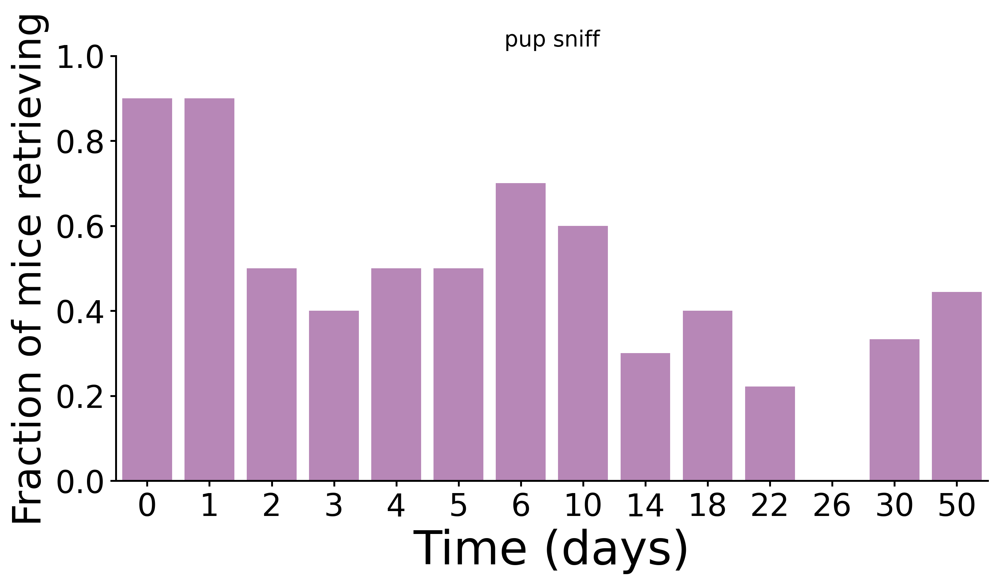

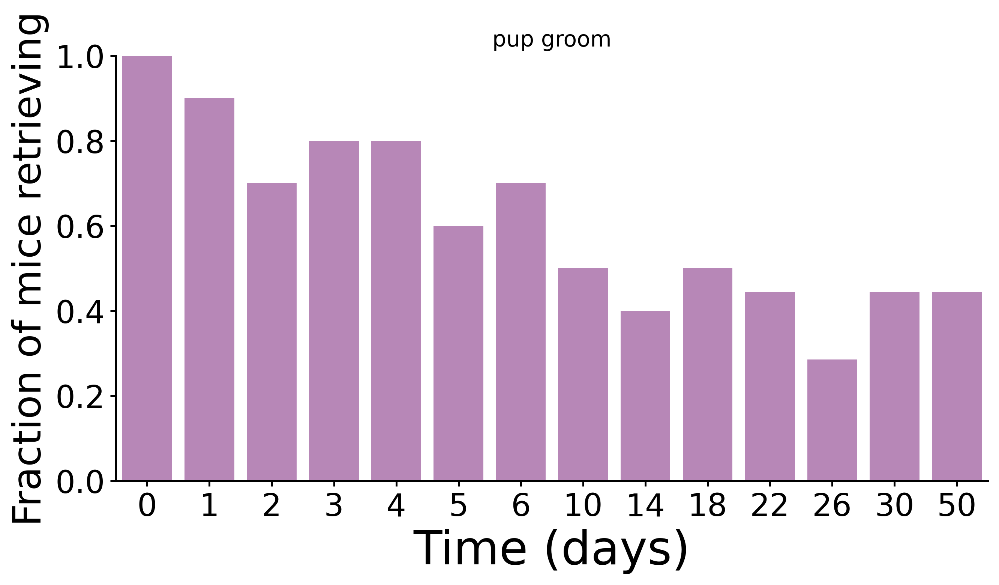

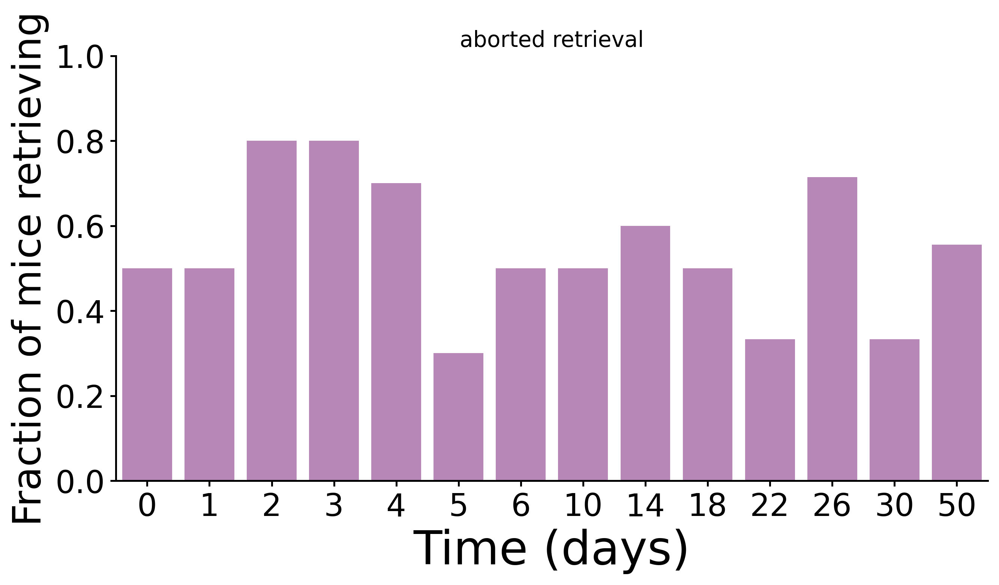

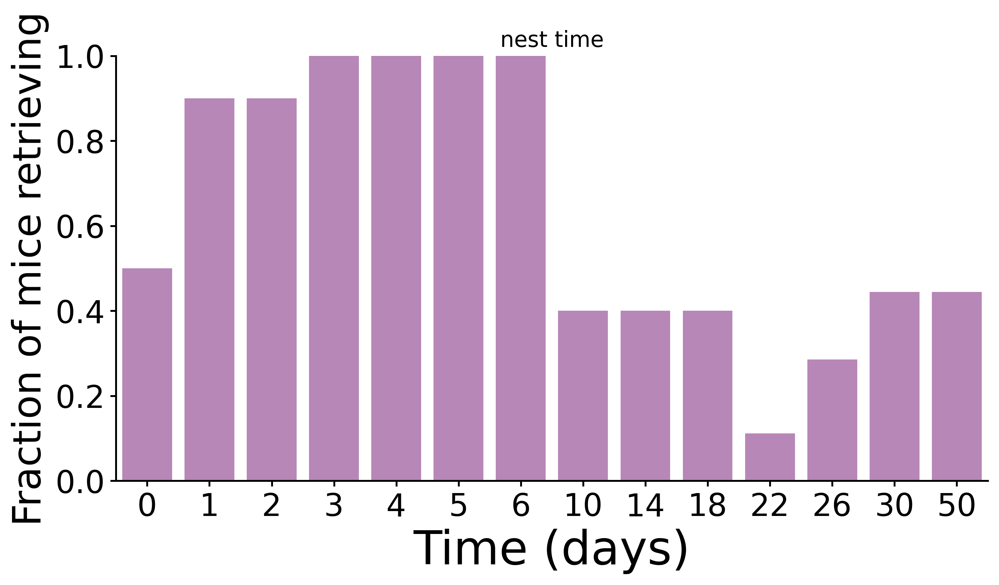

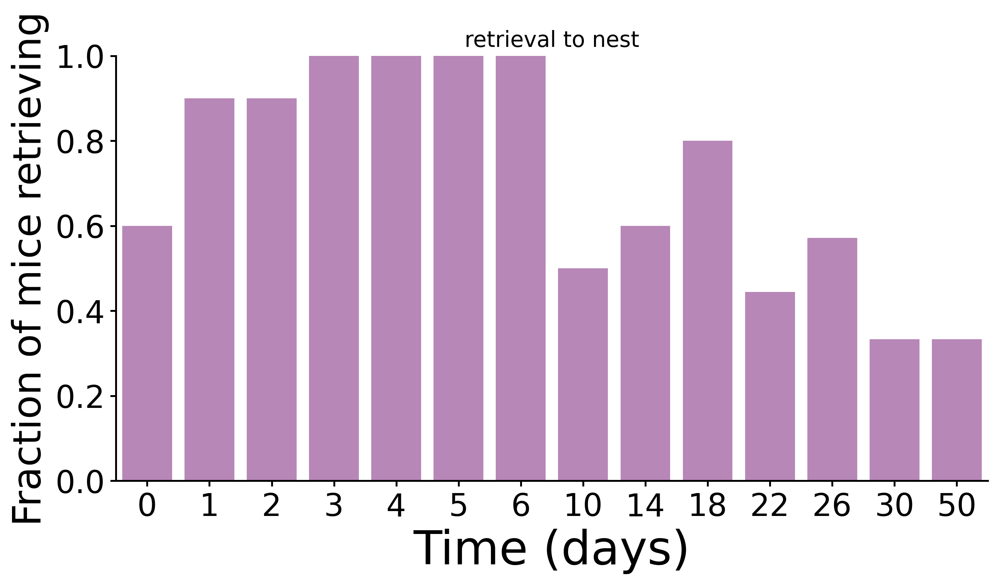

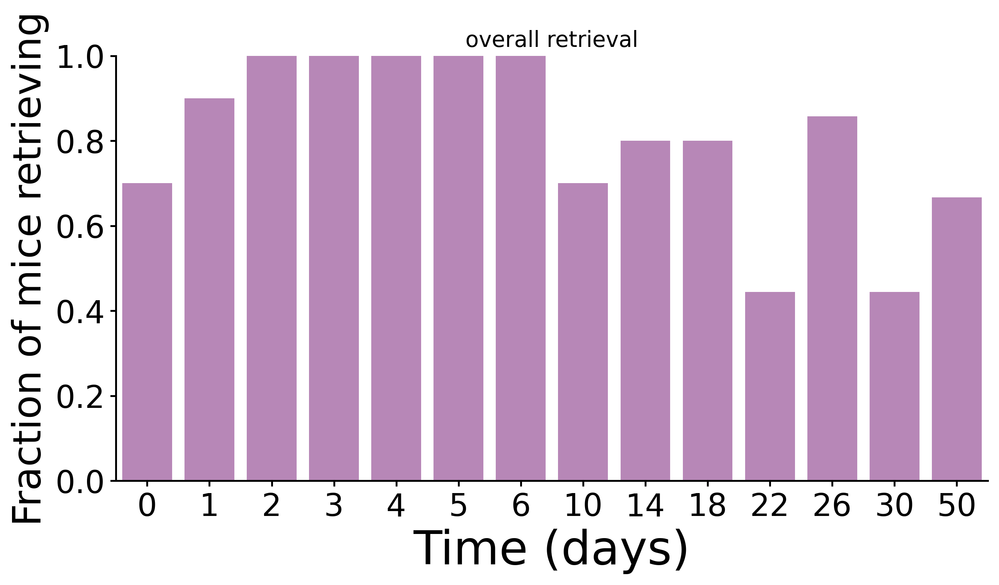

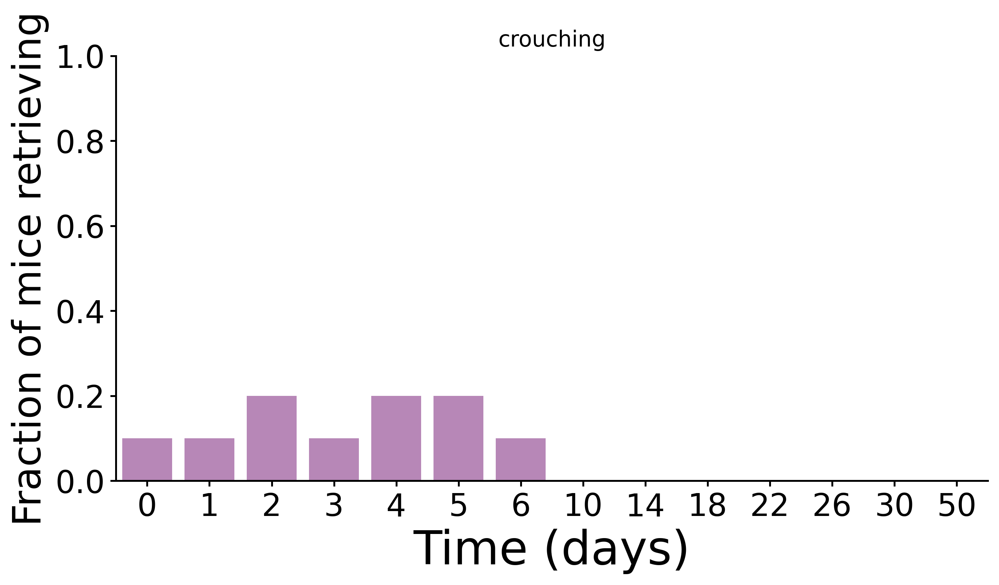

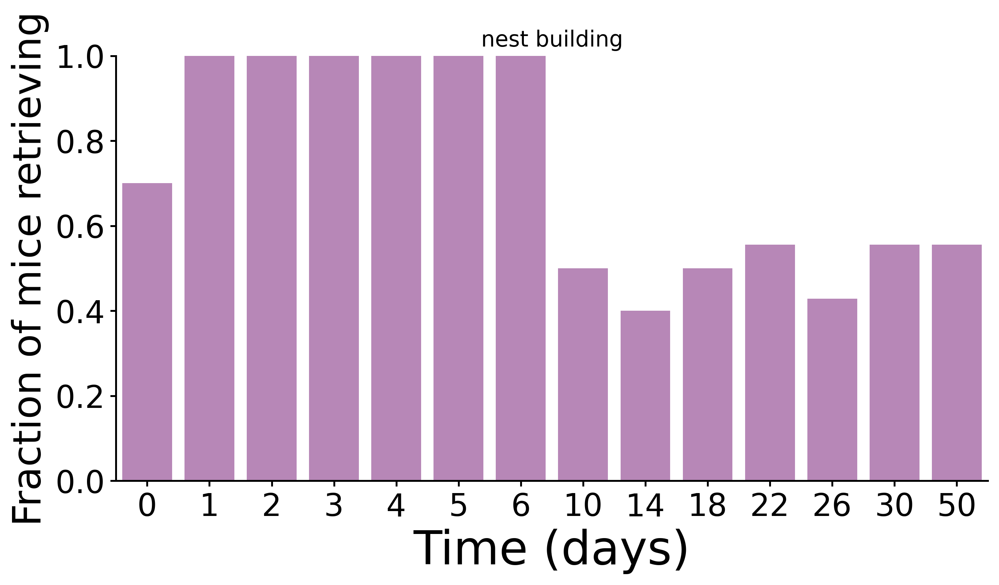

In [ ]:
for behaviour in percentages.behaviour.unique():
    perc_df = percentages[percentages.behaviour == behaviour]
    
    fig, ax = plt.subplots(figsize = [10, 5])
    
    sns.barplot(x = "time", y = "percentage", data = perc_df, palette = ["purple"], alpha = 0.5)
    plt.title(behaviour)
    
    plt.ylim([0, 1])
    plt.xticks(fontsize = 20)
    plt.yticks(fontsize = 20)
    # plt.axvline(x = 'day6', color = 'black', linestyle = '--', alpha = 0.5)

    ax.set_xticklabels(['0', '1', '2', '3', '4', '5', '6', '10', '14', '18', '22', '26', '30', '50'])
    plt.xlabel('Time (days)', fontsize = 30 )
    plt.ylabel('Fraction of mice retrieving',fontsize = 25)
    
    sns.despine()
    plt.savefig(f'plots/{behaviour}_percentage.pdf', dpi = 500, bbox_inches = 'tight')
    
    if behaviour == 'retrieval to nest':
        plt.savefig(f'plots/{behaviour}_percentage.jpg', dpi = 500, bbox_inches = 'tight')
    
    plt.show()